## Mean of amplitude^2

In [1]:
#Data processing
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from nptdms import TdmsFile #Process ramping file

#For building ML models
import keras
import keras.models as models
from keras.layers.core import Dense
from keras import regularizers
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from scipy.signal import find_peaks

np.random.seed(1337) # for reproducibility


Bad key "text.kerning_factor" on line 4 in
/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution
Using TensorFlow backend.


In [2]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings


def generate_data(dir_path, time_range, window = 2000, thres_win = 25000, step = 10):
    
    #Selection index due to using different window
    selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step)[selection_index:]
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)[selection_index:]
    #moving_thres_crossings = generate_crossings_data(dir_path, time_range, window = thres_win, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)[selection_index:]
    
    all_data = np.concatenate((moving_mean, moving_sd), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=12))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(12,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 3.0)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        
        
        ### Find trigger times
        peaks, _ = find_peaks(log_test_loss, height=3.0, distance = 5000)
        print("Other trigger time: ", time_test[peaks])
        print("Their log loss values are: ", log_test_loss[peaks])
        
        for i in range(len(peaks)):
            plt.vlines(time_test[peaks[i]], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed")
            
        plt.show()
        
        return list(time_test[peaks])
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #----Calculate trigger threshold for each section
    
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time is not None:
                print("Triggered at: ", trigger_time)
                trigger_log.extend(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


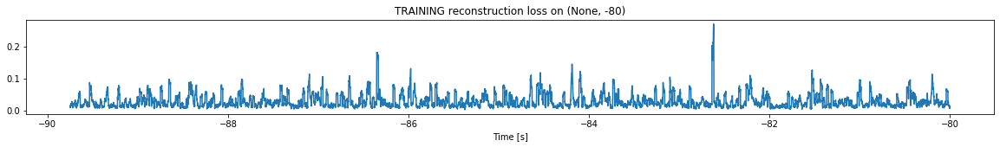

Finished training, median of the log(loss) is:  -1.648704805660167
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


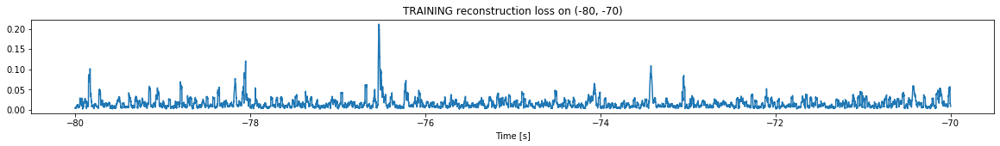

Finished training, median of the log(loss) is:  -1.9027104192150914
Triggering for section:  (-70, -60)
Using this median for triggering: -1.648704805660167


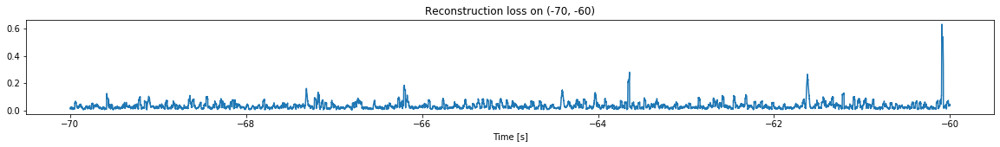

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


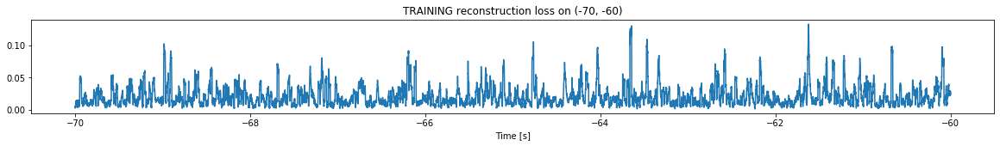

Finished training, median of the log(loss) is:  -1.7730503487615934
Triggering for section:  (-60, -50)
Using this median for triggering: -1.9027104192150914


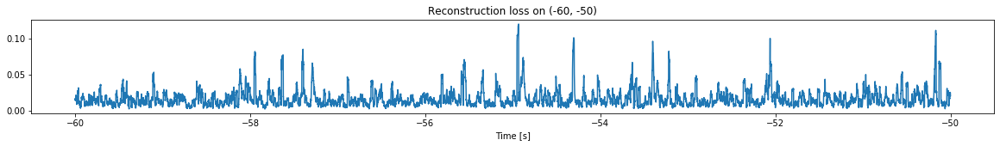

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


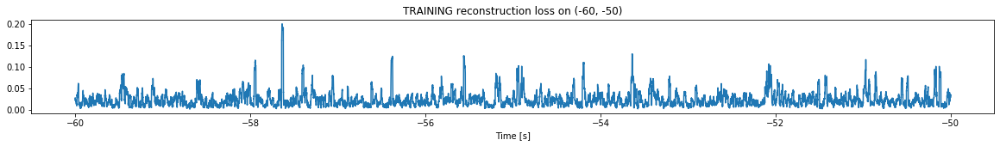

Finished training, median of the log(loss) is:  -1.713569102920974
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7730503487615934


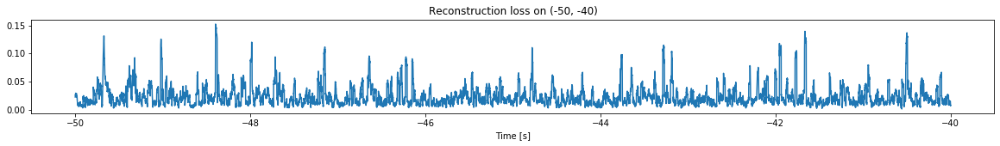

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


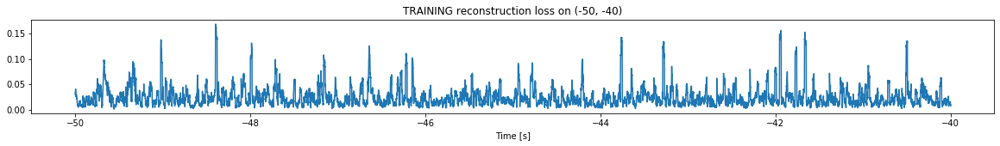

Finished training, median of the log(loss) is:  -1.6993225470154512
Triggering for section:  (-40, -30)
Using this median for triggering: -1.713569102920974


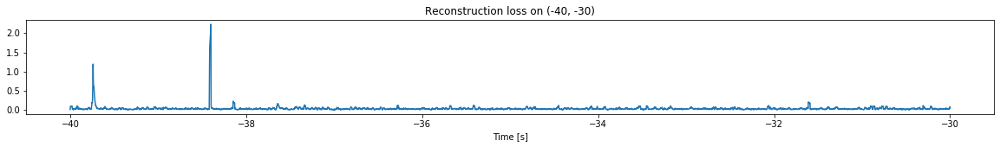

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


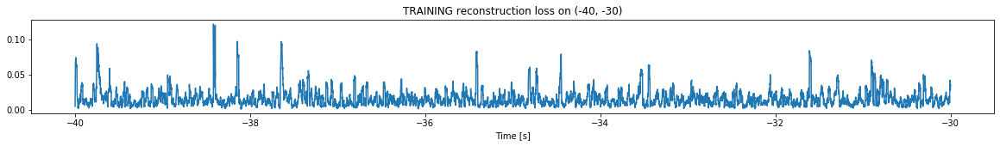

Finished training, median of the log(loss) is:  -1.878543758037226
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6993225470154512


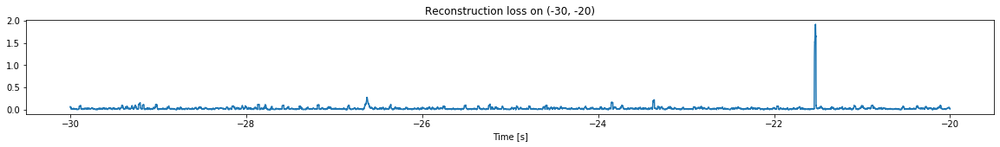

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


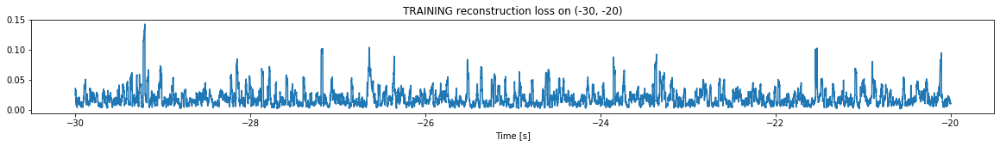

Finished training, median of the log(loss) is:  -1.7866309782529808
Triggering for section:  (-20, -10)
Using this median for triggering: -1.878543758037226


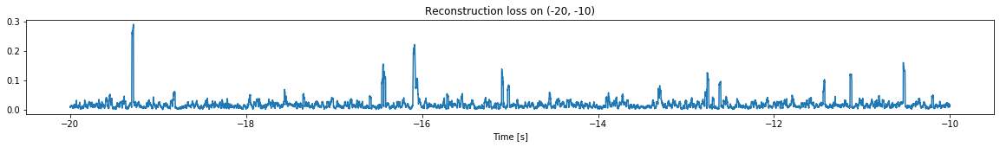

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


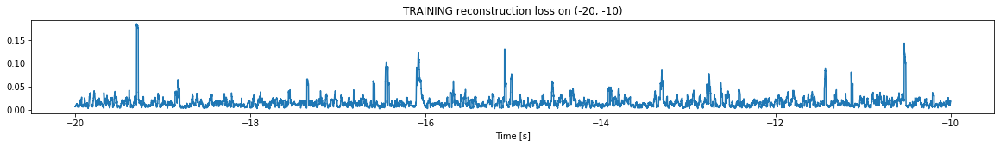

Finished training, median of the log(loss) is:  -1.880687083644361
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7866309782529808


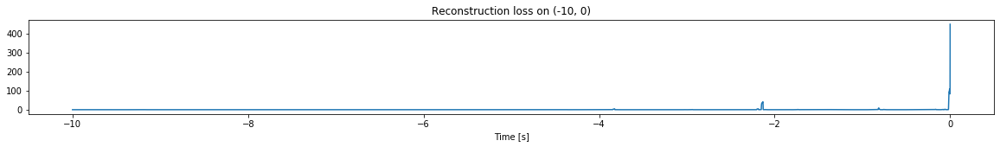

Other trigger time:  [-2.1325998 -0.006    ]
Their log loss values are:  [3.4061428 3.8241815]


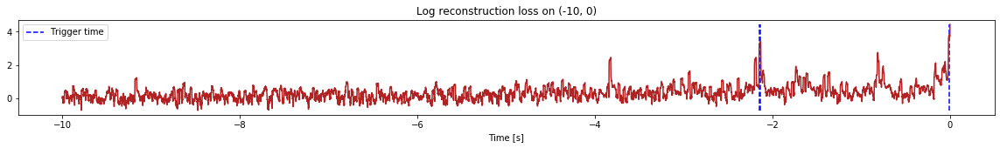

Triggered at:  [-2.1325998, -0.006]
<--------
Finished simulation, all the triggered times are:  [-2.1325998, -0.006]


In [3]:
simulation("./data/Ramp4/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


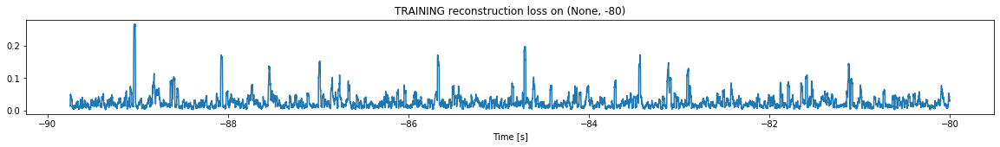

Finished training, median of the log(loss) is:  -1.6865398638618179
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


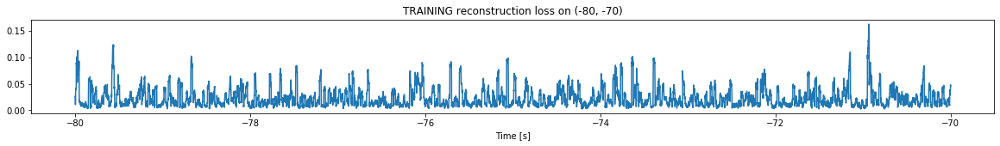

Finished training, median of the log(loss) is:  -1.749168717467489
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6865398638618179


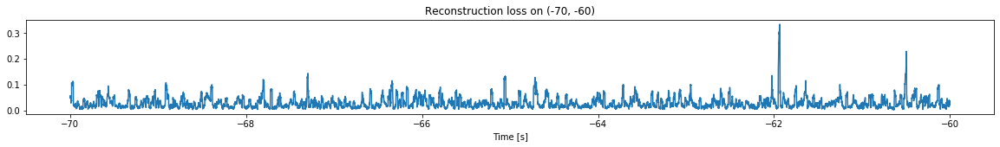

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


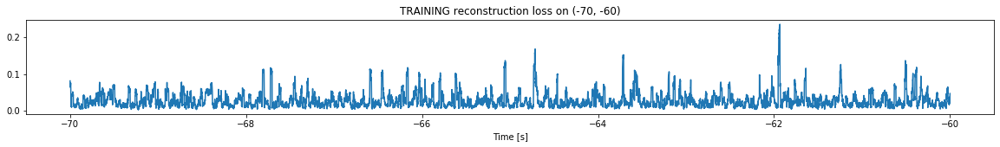

Finished training, median of the log(loss) is:  -1.6475064474553955
Triggering for section:  (-60, -50)
Using this median for triggering: -1.749168717467489


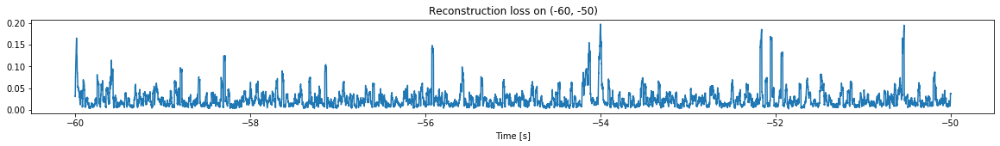

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


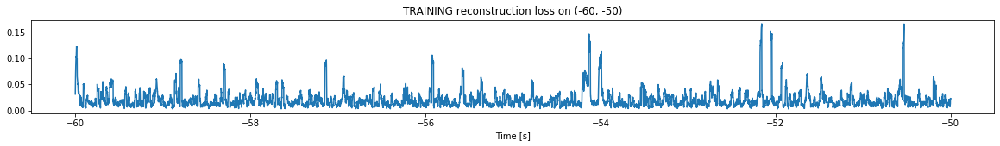

Finished training, median of the log(loss) is:  -1.7954282178774092
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6475064474553955


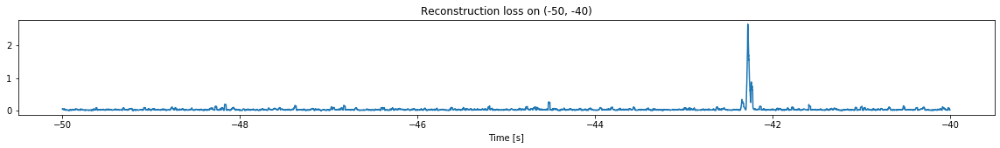

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


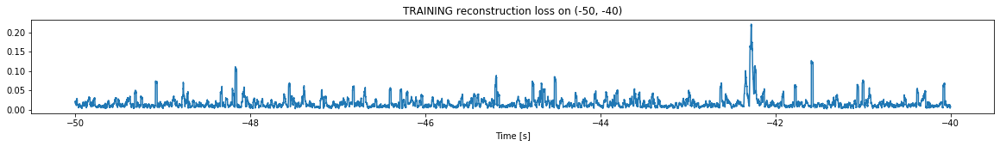

Finished training, median of the log(loss) is:  -1.8961106491351414
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7954282178774092


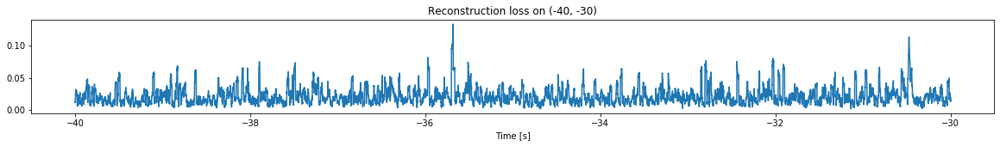

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


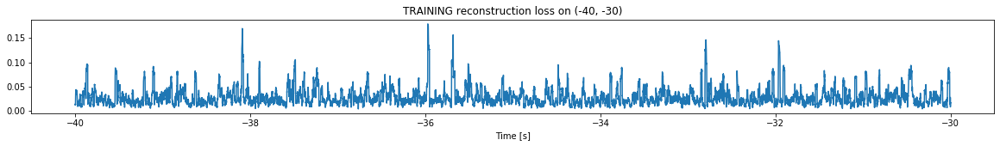

Finished training, median of the log(loss) is:  -1.6255635750406734
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8961106491351414


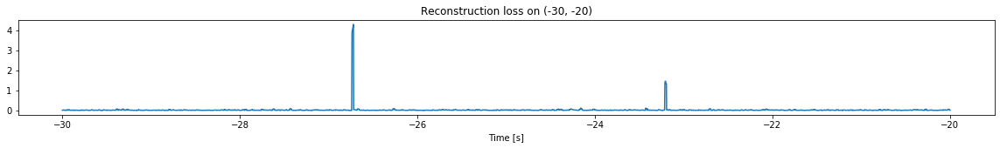

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


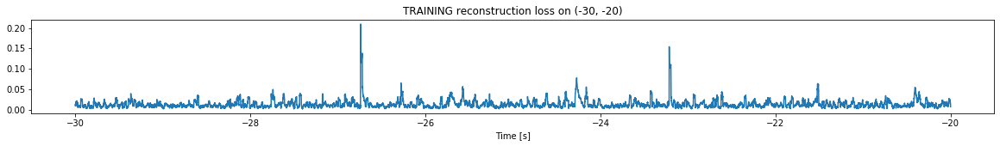

Finished training, median of the log(loss) is:  -1.9567021666549635
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6255635750406734


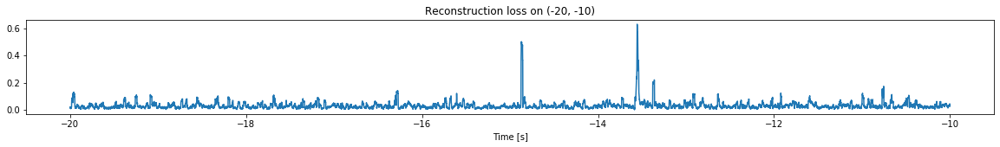

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


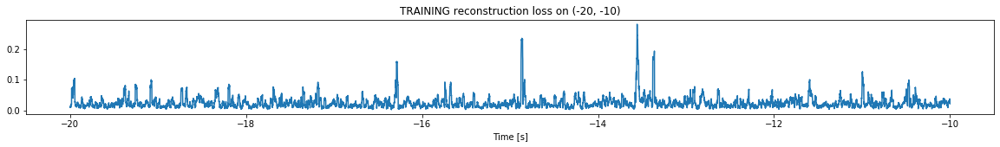

Finished training, median of the log(loss) is:  -1.6954951115951982
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9567021666549635


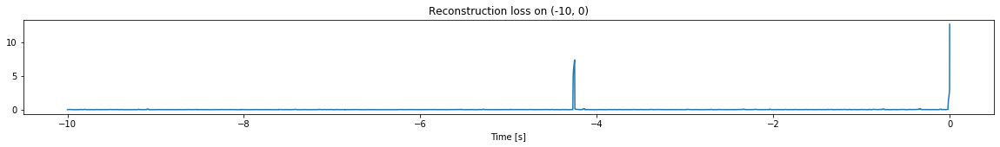

Other trigger time:  []
Their log loss values are:  []


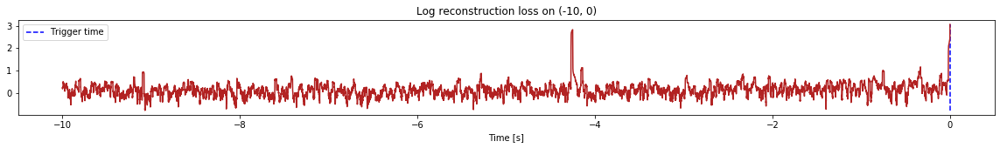

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [4]:
simulation("./data/Ramp5/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


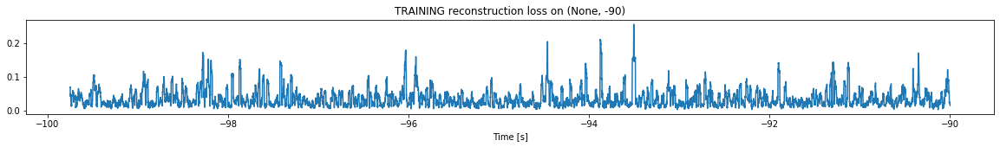

Finished training, median of the log(loss) is:  -1.5388220218823905
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


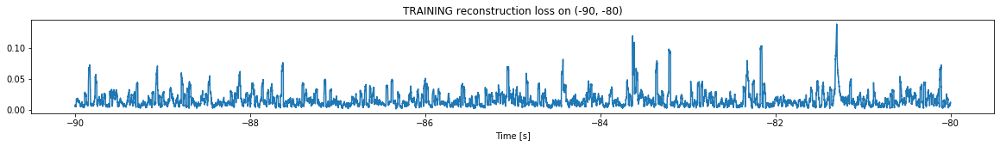

Finished training, median of the log(loss) is:  -1.8760185090827068
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5388220218823905


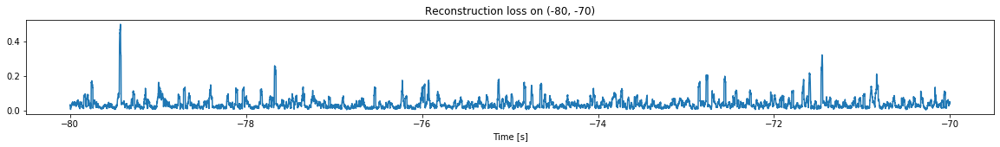

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


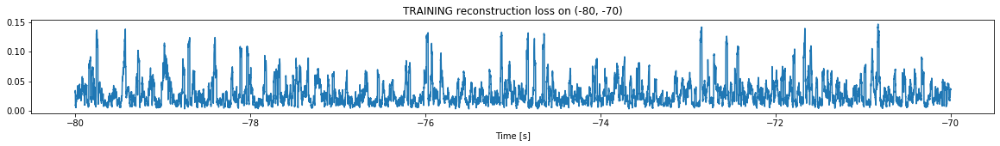

Finished training, median of the log(loss) is:  -1.6314094968265875
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8760185090827068


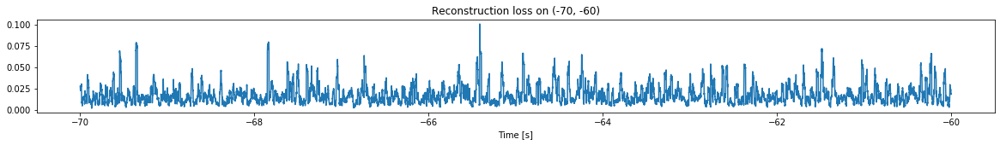

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


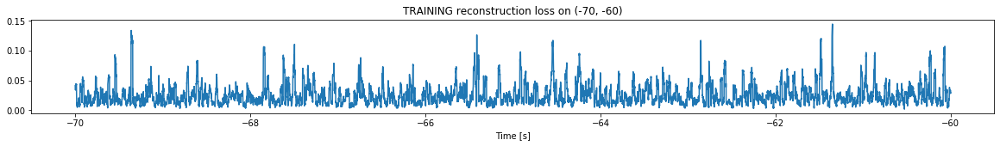

Finished training, median of the log(loss) is:  -1.6733358585007505
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6314094968265875


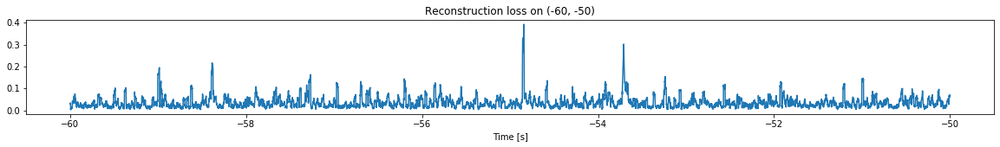

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


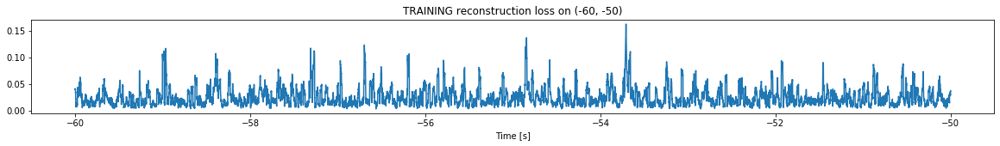

Finished training, median of the log(loss) is:  -1.6870532431126128
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6733358585007505


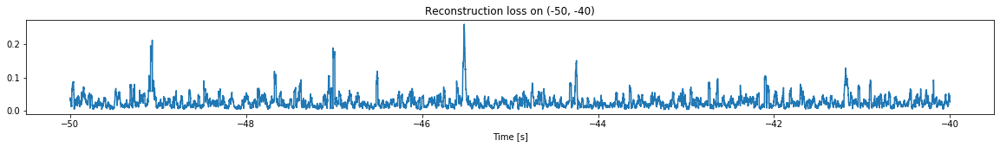

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


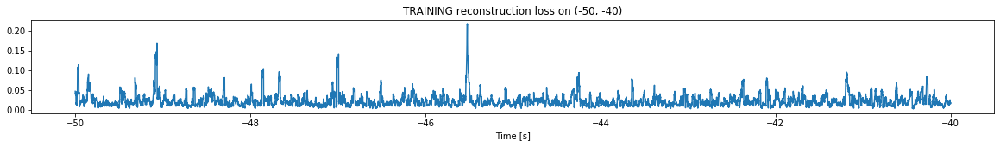

Finished training, median of the log(loss) is:  -1.7043405278469272
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6870532431126128


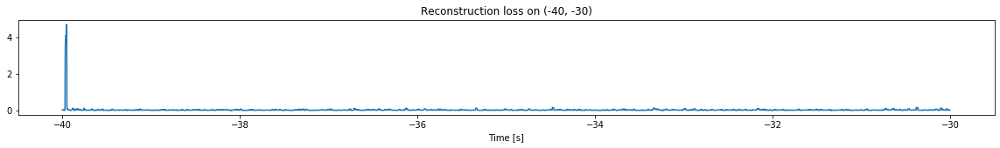

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


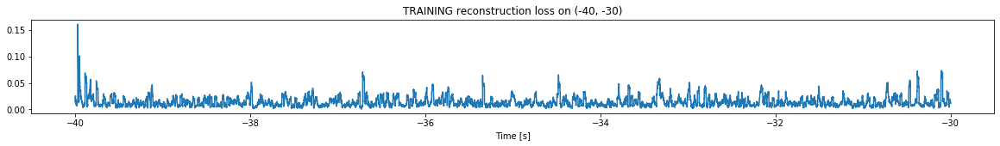

Finished training, median of the log(loss) is:  -1.9363581050813579
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7043405278469272


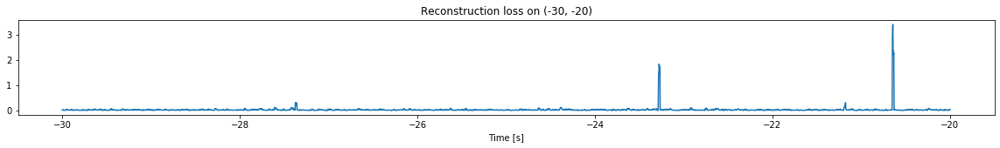

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


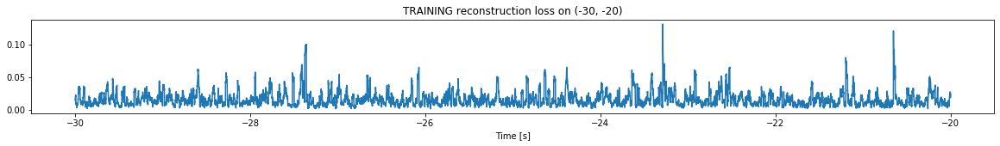

Finished training, median of the log(loss) is:  -1.855186099028823
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9363581050813579


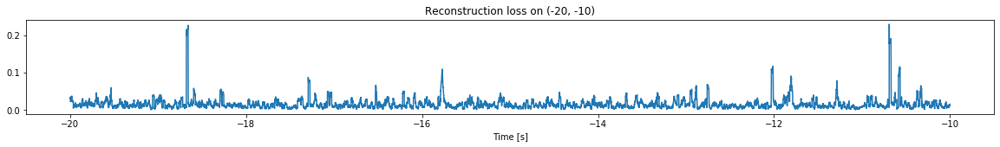

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


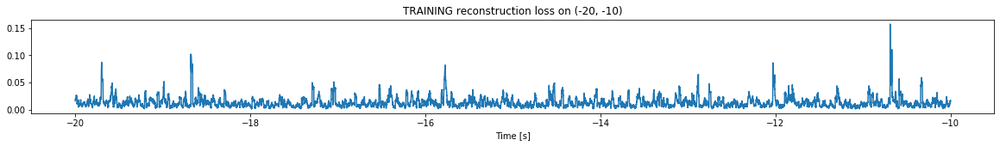

Finished training, median of the log(loss) is:  -1.9553166508045452
Triggering for section:  (-10, 0)
Using this median for triggering: -1.855186099028823


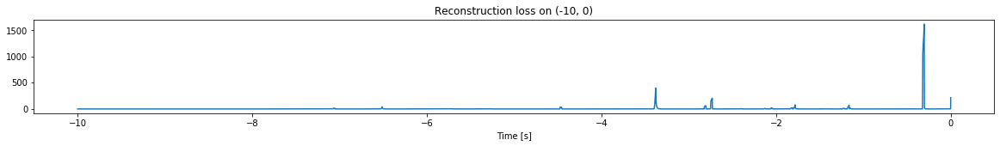

Other trigger time:  [-7.0541997 -6.5119996 -4.4707    -3.3790998 -2.731     -1.7816
 -1.1640999 -0.3037   ]
Their log loss values are:  [3.09214442 3.45370458 3.43886802 4.45579994 4.17002577 3.76204899
 3.71116912 5.06496069]


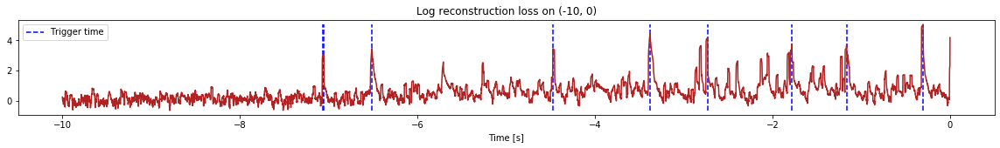

Triggered at:  [-7.0541997, -6.5119996, -4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.3037]
<--------
Finished simulation, all the triggered times are:  [-7.0541997, -6.5119996, -4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.3037]


In [5]:
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 30
Entering sections:  (-300, -290)
-------->
Entering sections:  (-290, -280)
-------->
Training for section:  (None, -290)


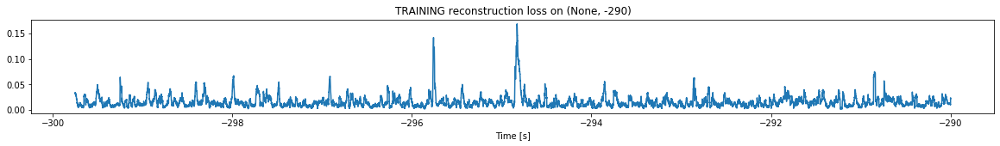

Finished training, median of the log(loss) is:  -1.8850306842079387
<--------
Entering sections:  (-280, -270)
-------->
Training for section:  (-290, -280)


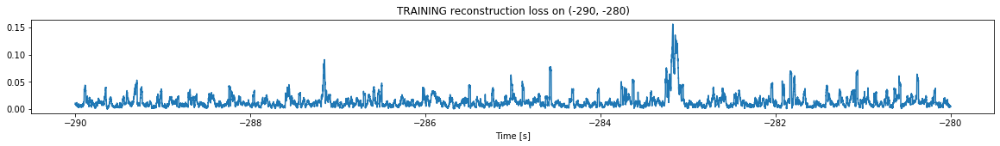

Finished training, median of the log(loss) is:  -1.9605106175607667
Triggering for section:  (-280, -270)
Using this median for triggering: -1.8850306842079387


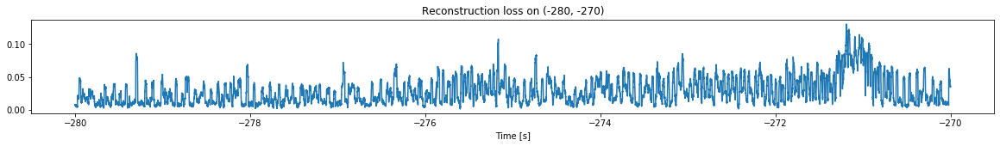

<--------
Entering sections:  (-270, -260)
-------->
Training for section:  (-280, -270)


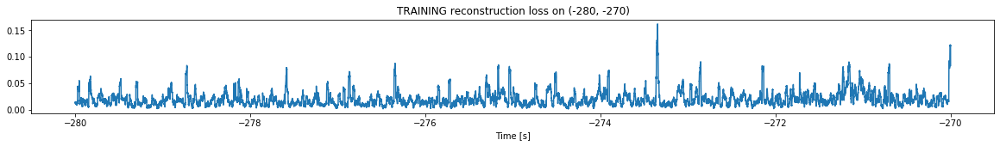

Finished training, median of the log(loss) is:  -1.777623867514076
Triggering for section:  (-270, -260)
Using this median for triggering: -1.9605106175607667


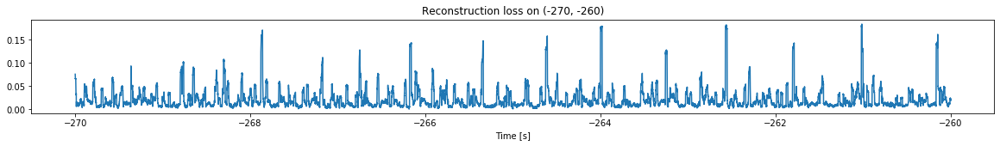

<--------
Entering sections:  (-260, -250)
-------->
Training for section:  (-270, -260)


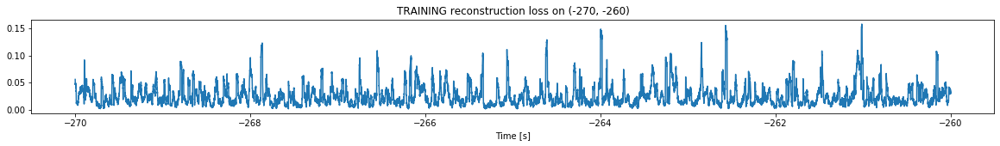

Finished training, median of the log(loss) is:  -1.67916740296529
Triggering for section:  (-260, -250)
Using this median for triggering: -1.777623867514076


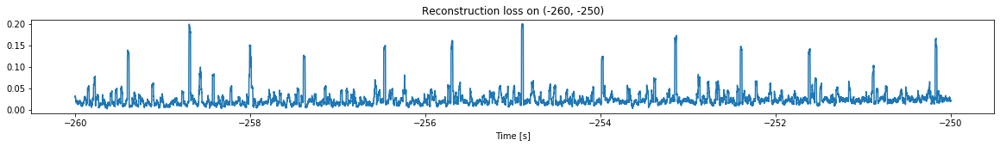

<--------
Entering sections:  (-250, -240)
-------->
Training for section:  (-260, -250)


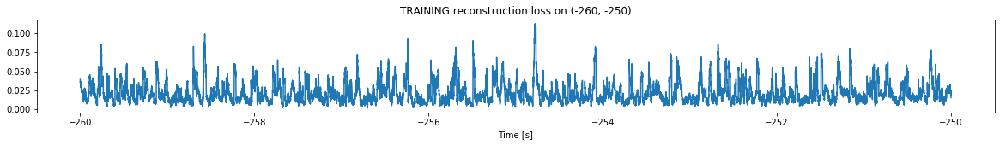

Finished training, median of the log(loss) is:  -1.742235341807108
Triggering for section:  (-250, -240)
Using this median for triggering: -1.67916740296529


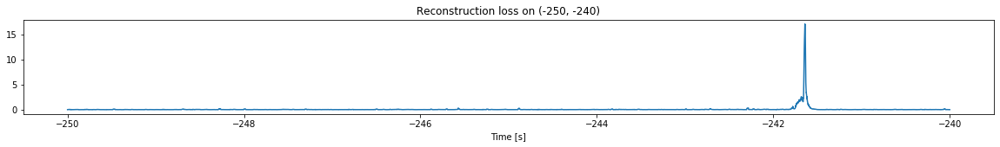

<--------
Entering sections:  (-240, -230)
-------->
Training for section:  (-250, -240)


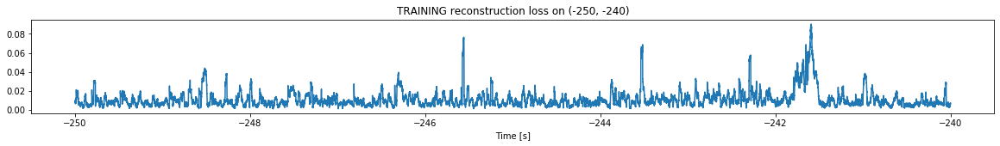

Finished training, median of the log(loss) is:  -2.0545200474393
Triggering for section:  (-240, -230)
Using this median for triggering: -1.742235341807108


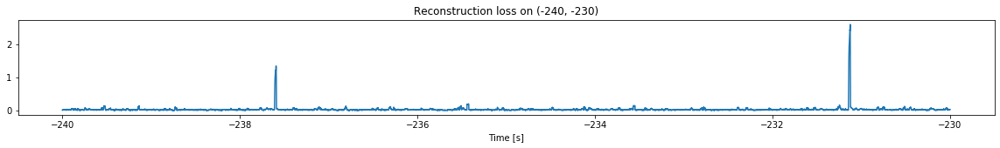

<--------
Entering sections:  (-230, -220)
-------->
Training for section:  (-240, -230)


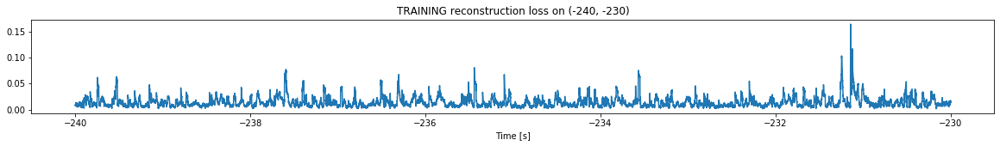

Finished training, median of the log(loss) is:  -1.942122285453824
Triggering for section:  (-230, -220)
Using this median for triggering: -2.0545200474393


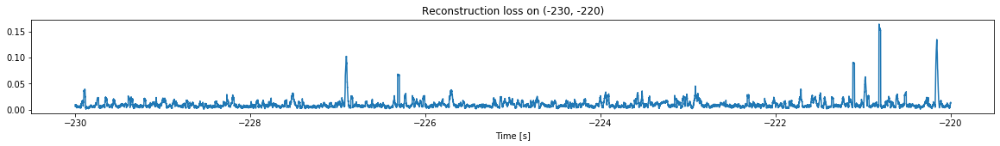

<--------
Entering sections:  (-220, -210)
-------->
Training for section:  (-230, -220)


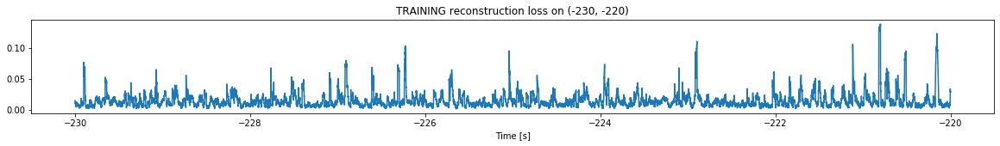

Finished training, median of the log(loss) is:  -1.9238781236468578
Triggering for section:  (-220, -210)
Using this median for triggering: -1.942122285453824


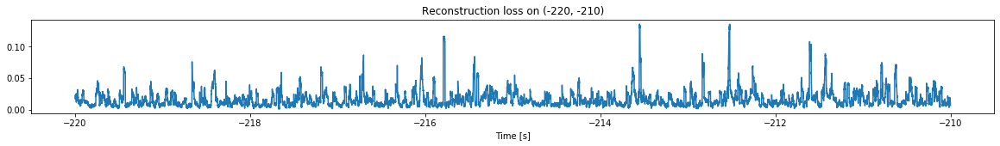

<--------
Entering sections:  (-210, -200)
-------->
Training for section:  (-220, -210)


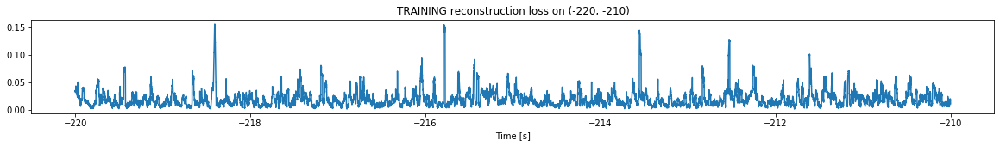

Finished training, median of the log(loss) is:  -1.7837490541002192
Triggering for section:  (-210, -200)
Using this median for triggering: -1.9238781236468578


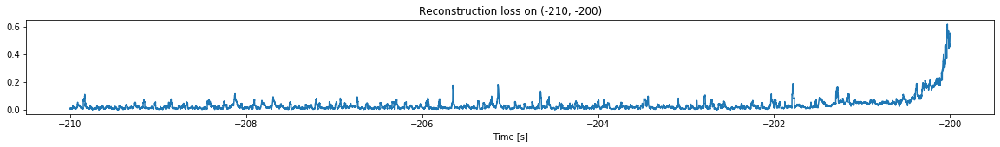

<--------
Entering sections:  (-200, -190)
-------->
Training for section:  (-210, -200)


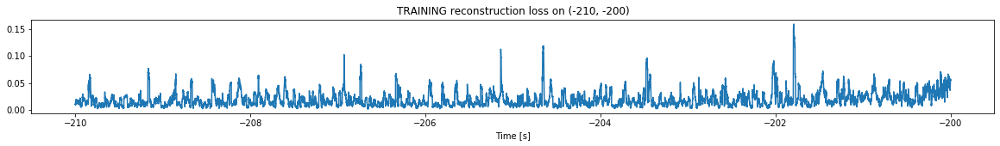

Finished training, median of the log(loss) is:  -1.808555992966168
Triggering for section:  (-200, -190)
Using this median for triggering: -1.7837490541002192


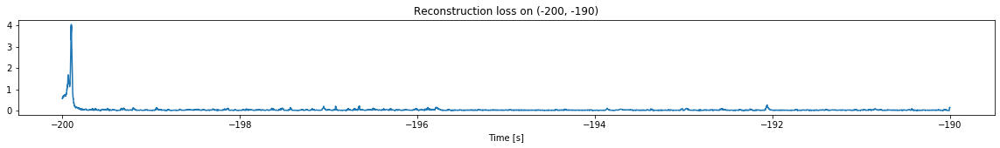

<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


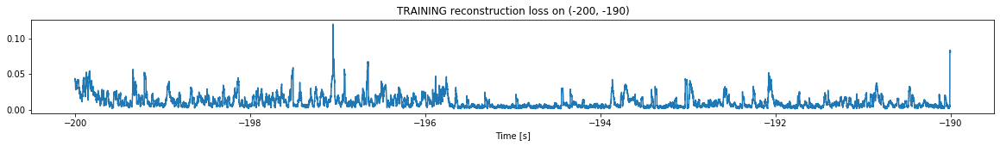

Finished training, median of the log(loss) is:  -2.1216313932083235
Triggering for section:  (-190, -180)
Using this median for triggering: -1.808555992966168


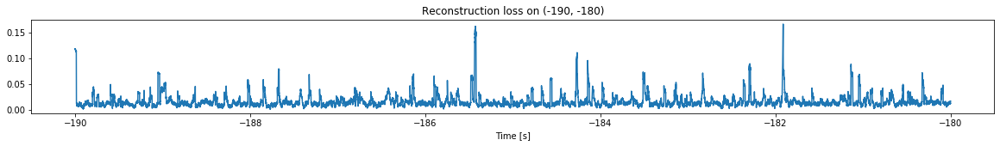

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


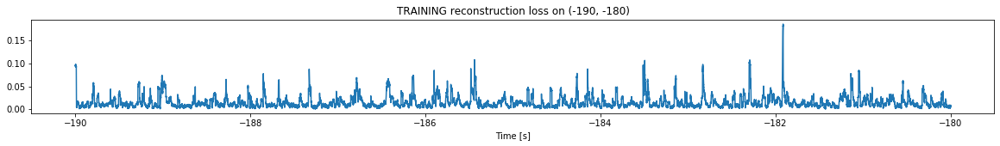

Finished training, median of the log(loss) is:  -1.9451202125340017
Triggering for section:  (-180, -170)
Using this median for triggering: -2.1216313932083235


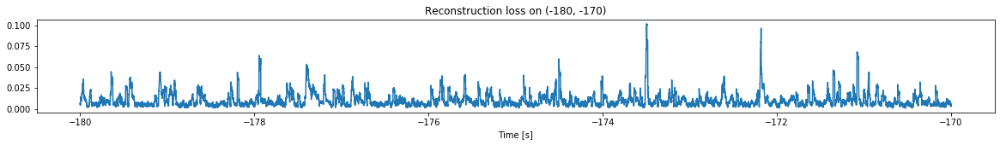

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


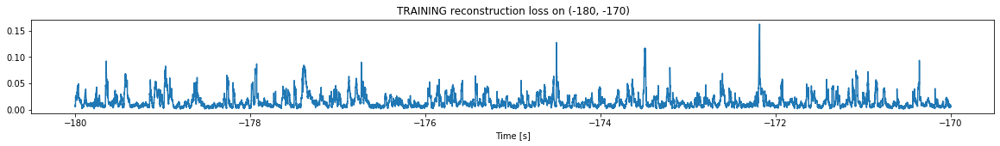

Finished training, median of the log(loss) is:  -1.9232272301361817
Triggering for section:  (-170, -160)
Using this median for triggering: -1.9451202125340017


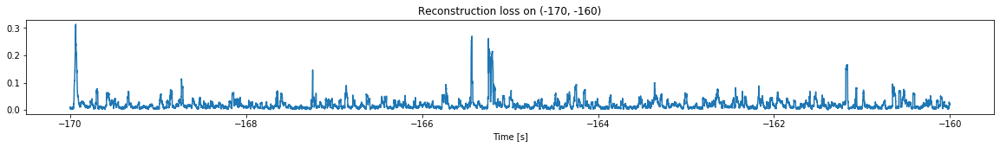

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


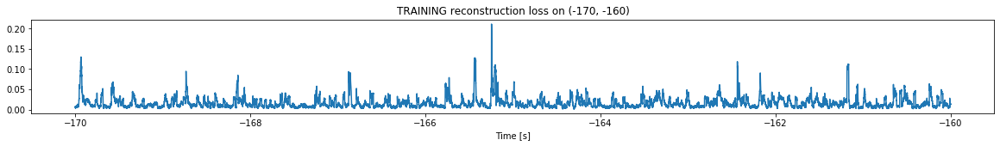

Finished training, median of the log(loss) is:  -1.9137113109931723
Triggering for section:  (-160, -150)
Using this median for triggering: -1.9232272301361817


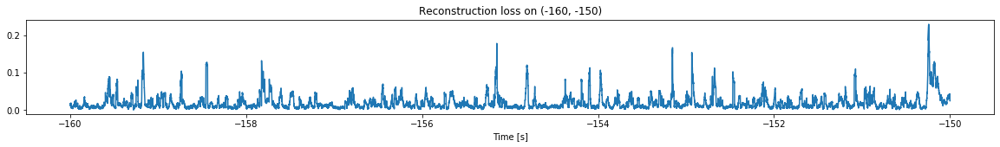

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


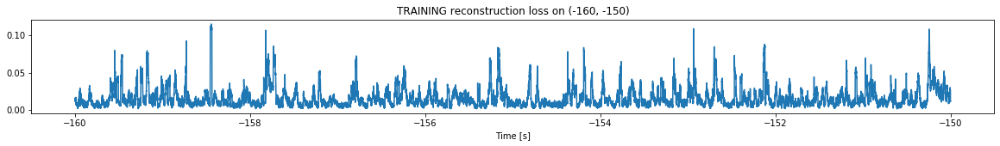

Finished training, median of the log(loss) is:  -1.9308198496710318
Triggering for section:  (-150, -140)
Using this median for triggering: -1.9137113109931723


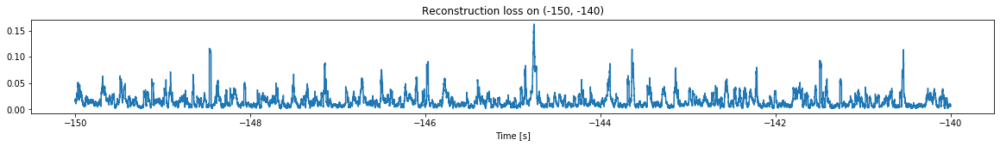

<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


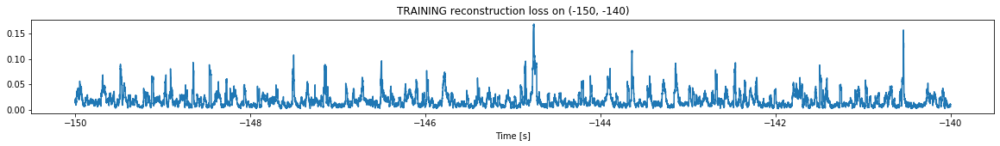

Finished training, median of the log(loss) is:  -1.850392028121588
Triggering for section:  (-140, -130)
Using this median for triggering: -1.9308198496710318


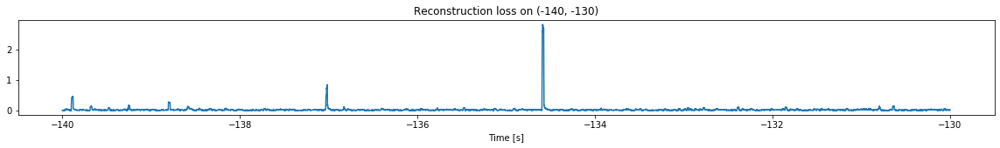

<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


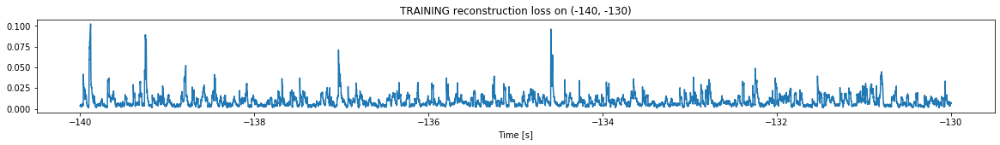

Finished training, median of the log(loss) is:  -2.135495103884705
Triggering for section:  (-130, -120)
Using this median for triggering: -1.850392028121588


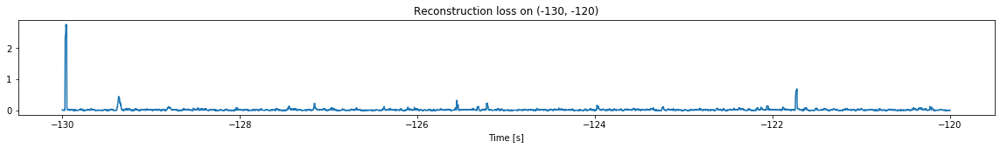

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


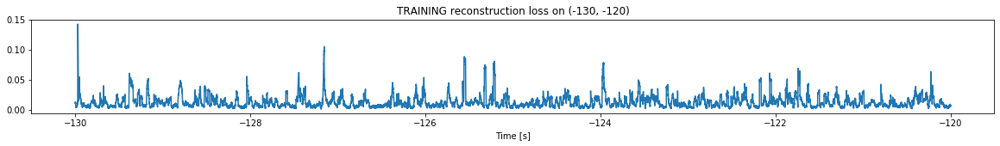

Finished training, median of the log(loss) is:  -2.013003958481445
Triggering for section:  (-120, -110)
Using this median for triggering: -2.135495103884705


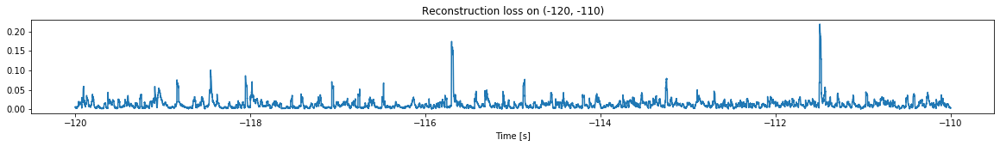

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


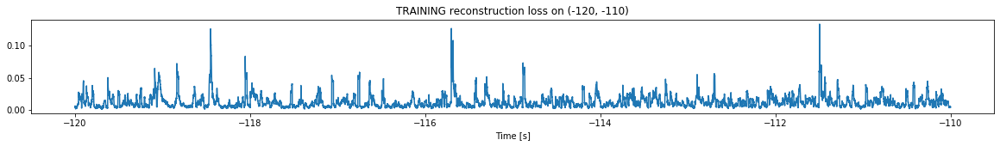

Finished training, median of the log(loss) is:  -2.0168401137705443
Triggering for section:  (-110, -100)
Using this median for triggering: -2.013003958481445


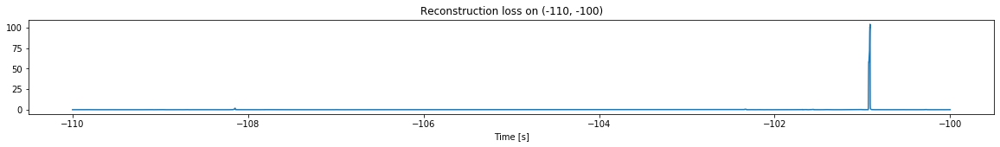

Other trigger time:  [-100.91249]
Their log loss values are:  [4.03097768]


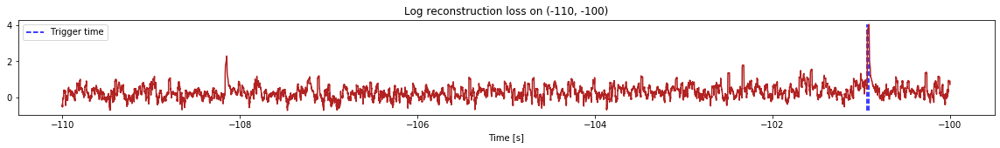

Triggered at:  [-100.91249]
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


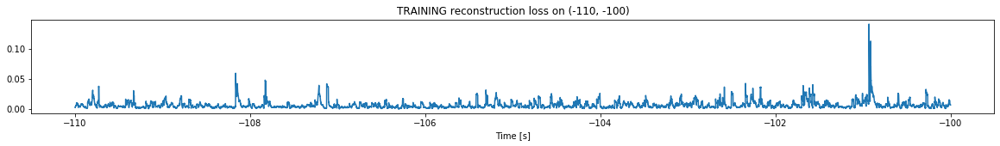

Finished training, median of the log(loss) is:  -2.2747392774022686
Triggering for section:  (-100, -90)
Using this median for triggering: -2.0168401137705443


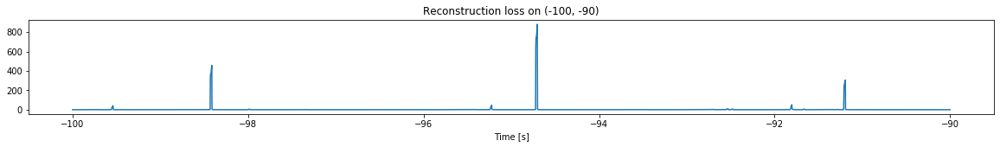

Other trigger time:  [-99.53959  -98.41249  -95.22369  -94.704185 -91.80379  -91.193886]
Their log loss values are:  [3.628167   4.6767482  3.68619872 4.96250909 3.72725609 4.50238207]


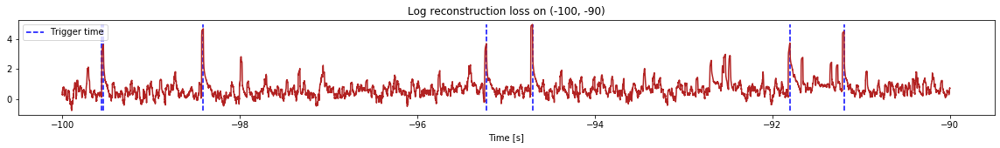

Triggered at:  [-99.53959, -98.41249, -95.22369, -94.704185, -91.80379, -91.193886]
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


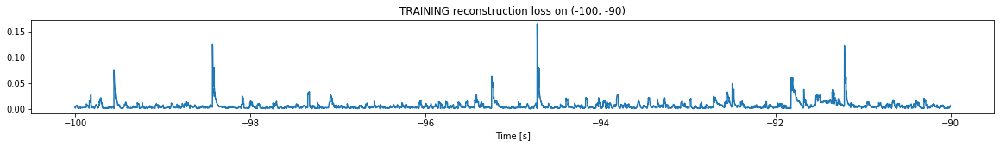

Finished training, median of the log(loss) is:  -2.3276188481437154
Triggering for section:  (-90, -80)
Using this median for triggering: -2.2747392774022686


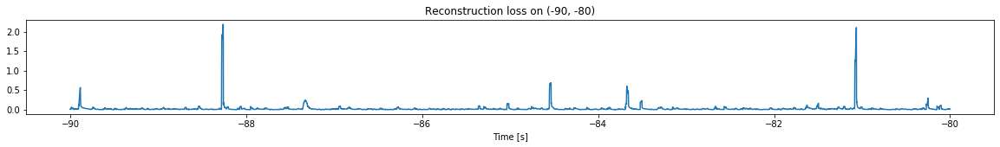

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


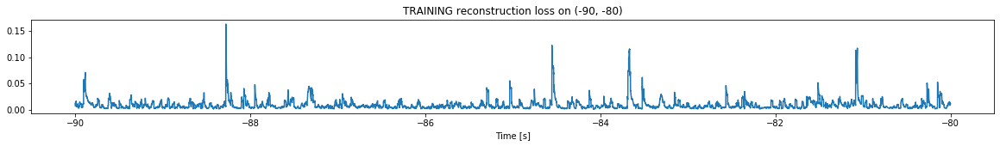

Finished training, median of the log(loss) is:  -2.2070458527184664
Triggering for section:  (-80, -70)
Using this median for triggering: -2.3276188481437154


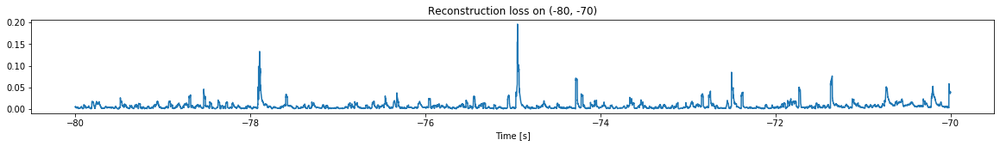

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


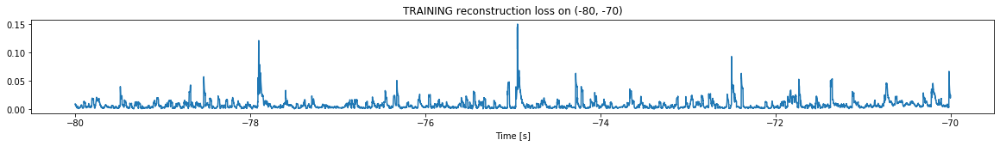

Finished training, median of the log(loss) is:  -2.2393606257728726
Triggering for section:  (-70, -60)
Using this median for triggering: -2.2070458527184664


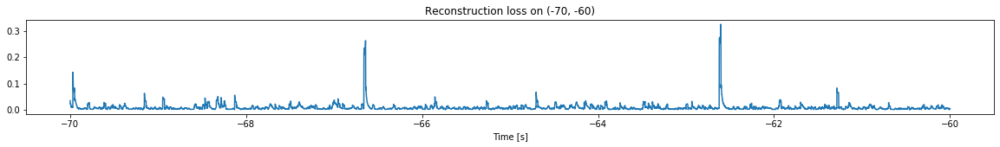

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


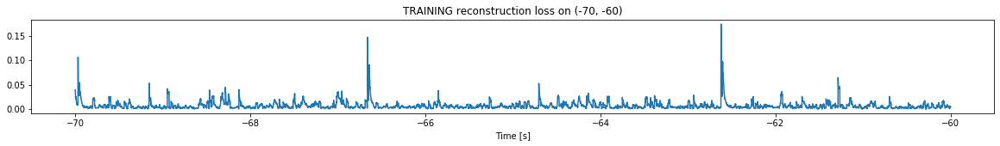

Finished training, median of the log(loss) is:  -2.2661203695571035
Triggering for section:  (-60, -50)
Using this median for triggering: -2.2393606257728726


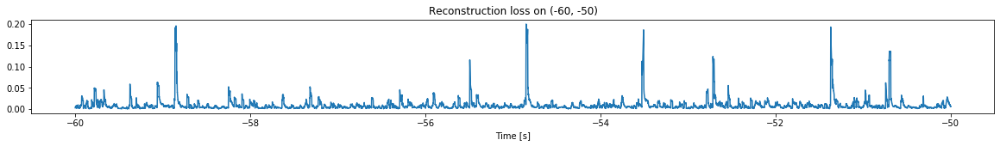

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


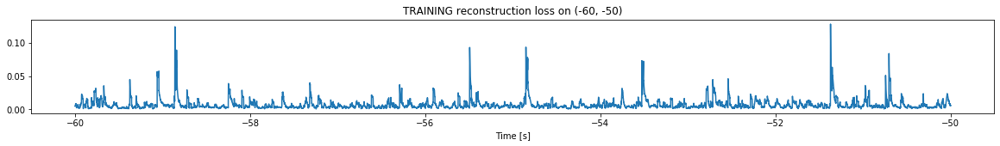

Finished training, median of the log(loss) is:  -2.2841633489494075
Triggering for section:  (-50, -40)
Using this median for triggering: -2.2661203695571035


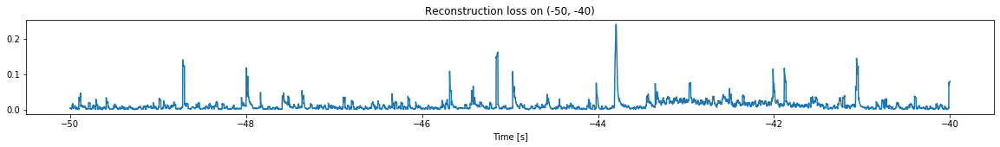

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


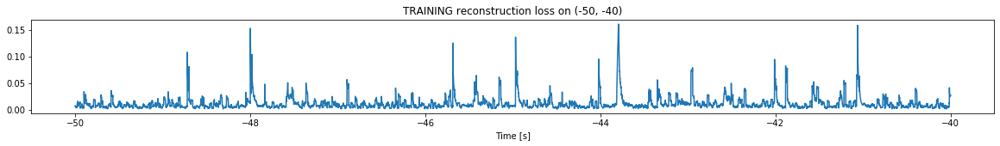

Finished training, median of the log(loss) is:  -2.0920459988905473
Triggering for section:  (-40, -30)
Using this median for triggering: -2.2841633489494075


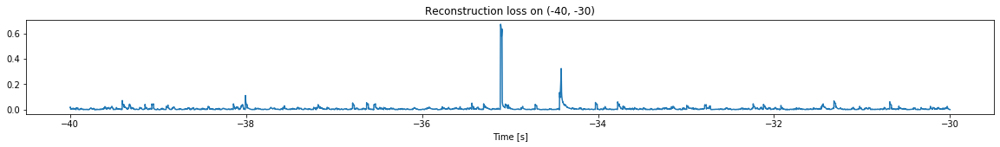

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


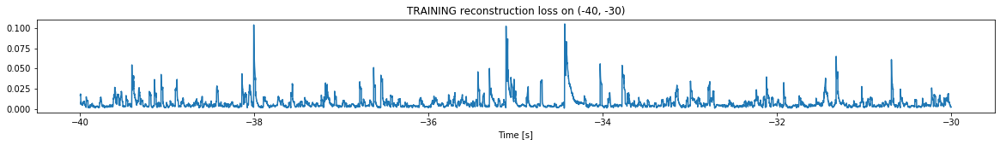

Finished training, median of the log(loss) is:  -2.3217024001720974
Triggering for section:  (-30, -20)
Using this median for triggering: -2.0920459988905473


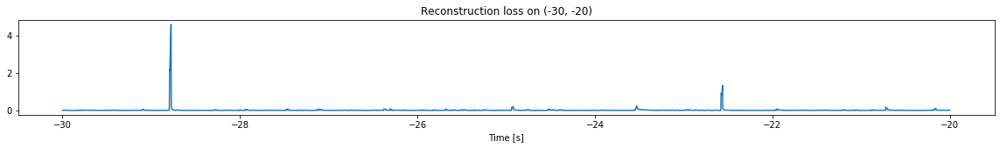

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


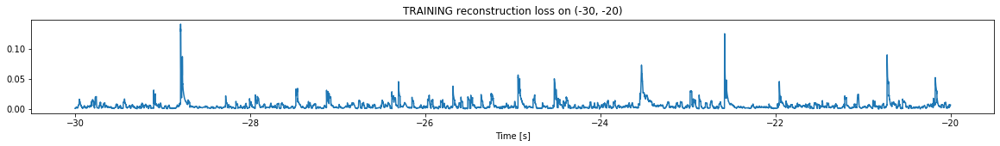

Finished training, median of the log(loss) is:  -2.388437034608602
Triggering for section:  (-20, -10)
Using this median for triggering: -2.3217024001720974


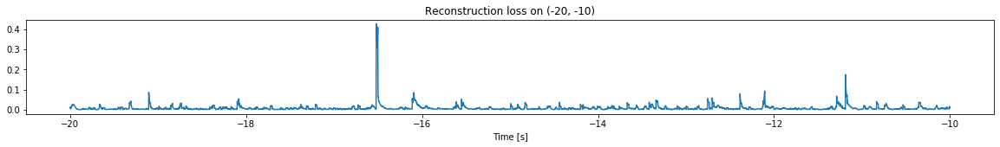

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


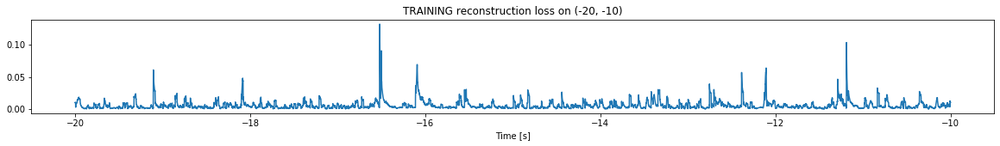

Finished training, median of the log(loss) is:  -2.3640313939332778
Triggering for section:  (-10, 0)
Using this median for triggering: -2.388437034608602


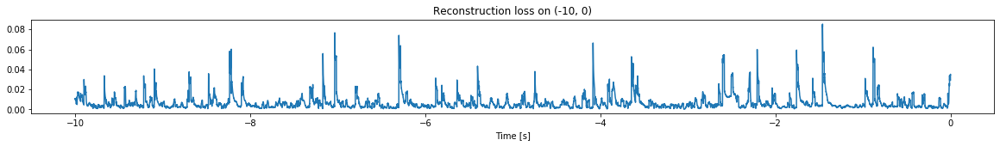

<--------
Finished simulation, all the triggered times are:  [-100.91249, -99.53959, -98.41249, -95.22369, -94.704185, -91.80379, -91.193886]


In [6]:
simulation("./data/Ramp19/", 10, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2117500, 12)
Flushing input history
Number of sections: 21
Entering sections:  (-210, -200)
-------->
Entering sections:  (-200, -190)
-------->
Training for section:  (None, -200)


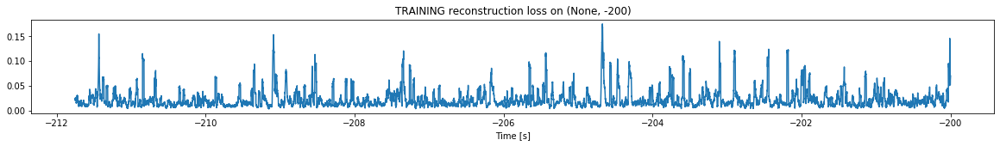

Finished training, median of the log(loss) is:  -1.7710499695846353
<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


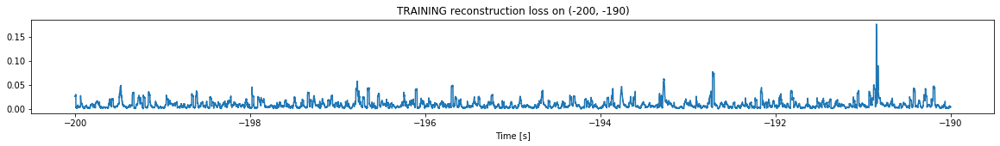

Finished training, median of the log(loss) is:  -2.1233761283949972
Triggering for section:  (-190, -180)
Using this median for triggering: -1.7710499695846353


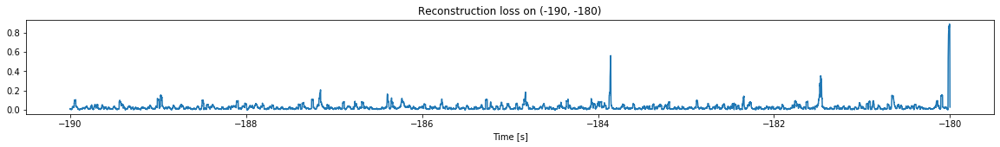

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


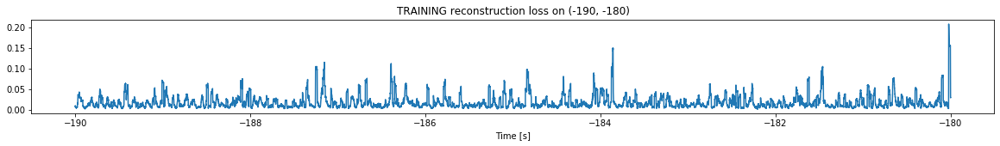

Finished training, median of the log(loss) is:  -1.893557488271137
Triggering for section:  (-180, -170)
Using this median for triggering: -2.1233761283949972


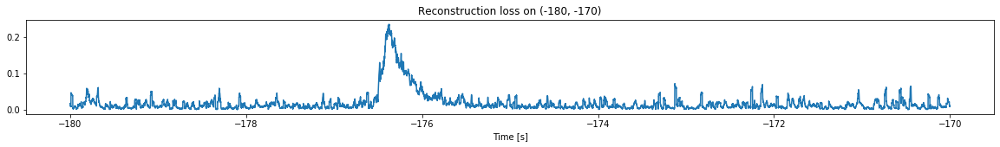

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


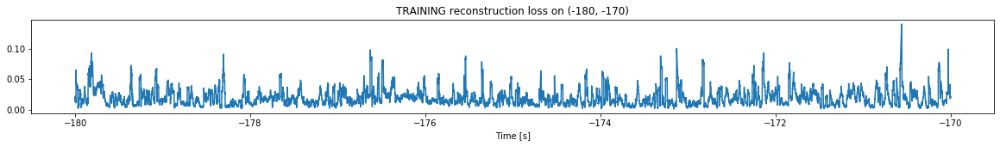

Finished training, median of the log(loss) is:  -1.7707201314648089
Triggering for section:  (-170, -160)
Using this median for triggering: -1.893557488271137


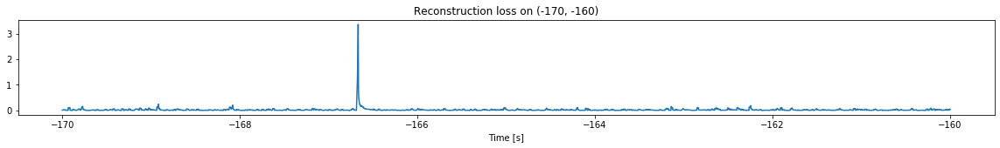

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


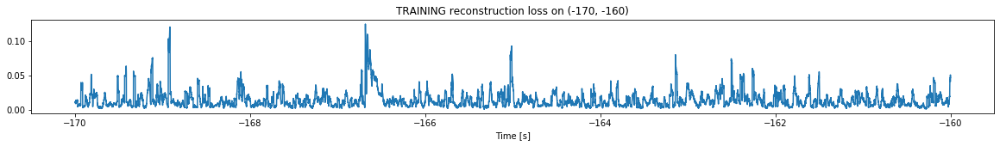

Finished training, median of the log(loss) is:  -1.9583840226157618
Triggering for section:  (-160, -150)
Using this median for triggering: -1.7707201314648089


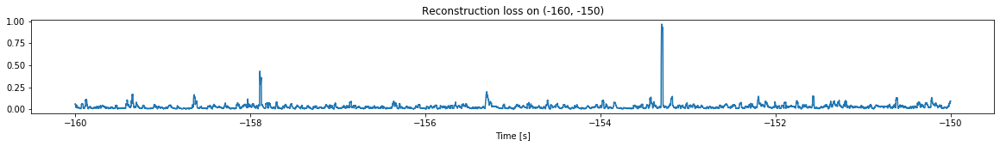

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


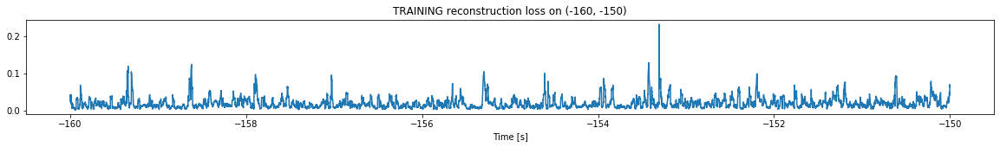

Finished training, median of the log(loss) is:  -1.8103616805171294
Triggering for section:  (-150, -140)
Using this median for triggering: -1.9583840226157618


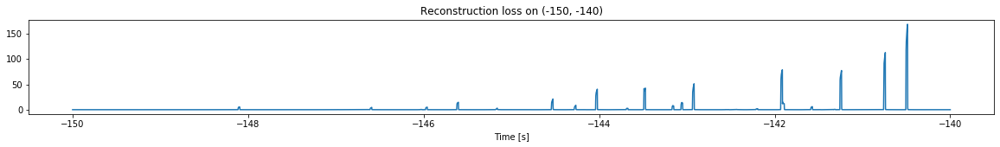

Other trigger time:  [-145.6043  -144.52678 -144.02179 -143.47359 -142.9188  -141.91309
 -141.23909 -140.48679]
Their log loss values are:  [3.12393887 3.28094295 3.56525339 3.58763554 3.66734342 3.85402563
 3.84619125 4.18485403]


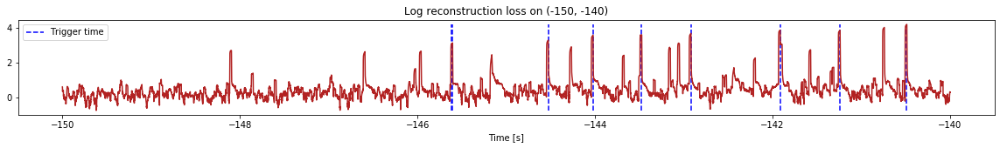

Triggered at:  [-145.6043, -144.52678, -144.02179, -143.47359, -142.9188, -141.91309, -141.23909, -140.48679]
<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


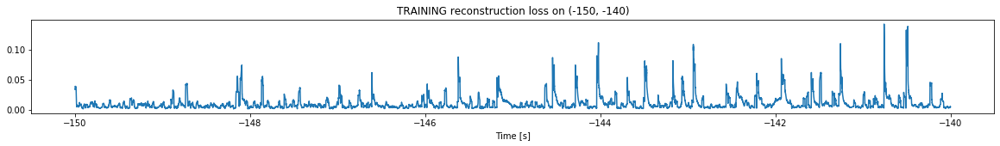

Finished training, median of the log(loss) is:  -2.1571394819944985
Triggering for section:  (-140, -130)
Using this median for triggering: -1.8103616805171294


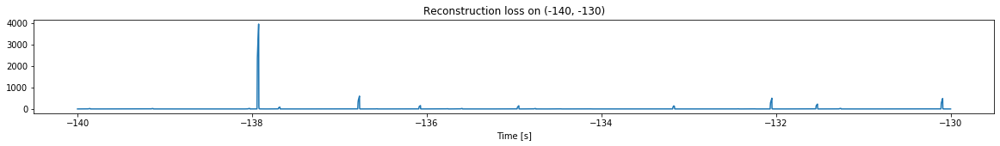

Other trigger time:  [-139.85579 -139.14058 -137.92479 -136.77028 -136.0718  -134.94579
 -133.17009 -132.0474  -131.52489 -130.09099]
Their log loss values are:  [3.15765796 3.10175313 5.40781401 4.58876881 4.01092891 3.98628105
 3.97158844 4.51082337 4.16784294 4.50005961]


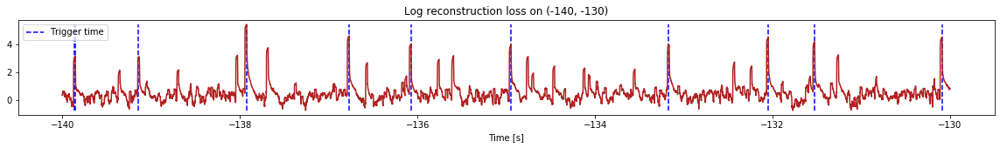

Triggered at:  [-139.85579, -139.14058, -137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]
<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


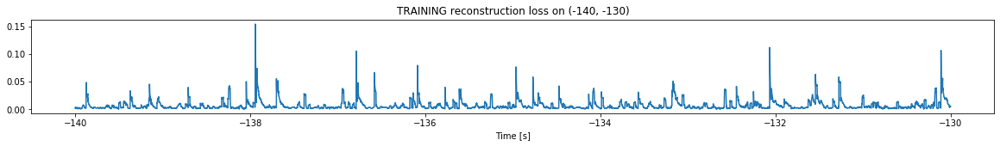

Finished training, median of the log(loss) is:  -2.3665463310865142
Triggering for section:  (-130, -120)
Using this median for triggering: -2.1571394819944985


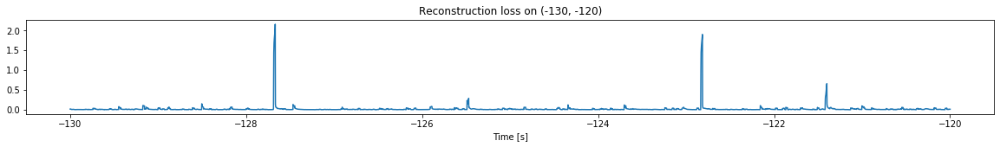

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


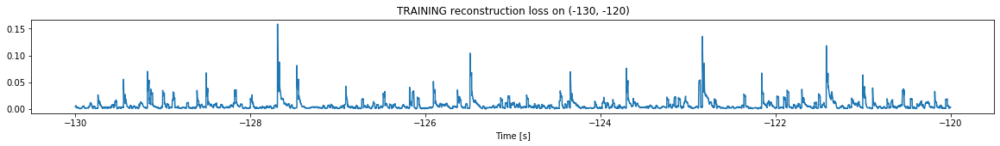

Finished training, median of the log(loss) is:  -2.3322982053834123
Triggering for section:  (-120, -110)
Using this median for triggering: -2.3665463310865142


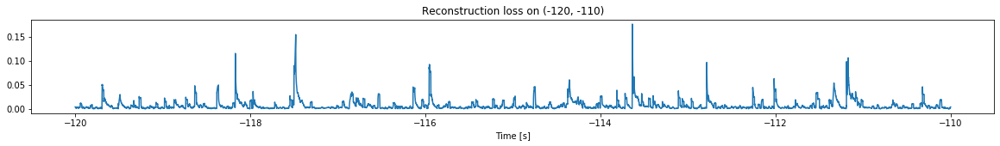

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


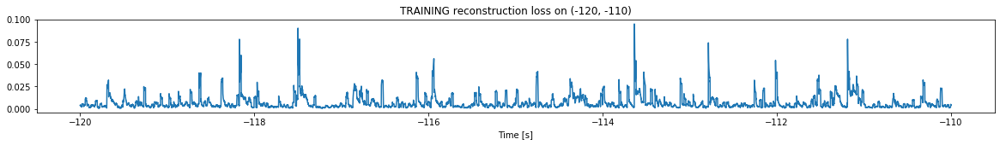

Finished training, median of the log(loss) is:  -2.366521693514576
Triggering for section:  (-110, -100)
Using this median for triggering: -2.3322982053834123


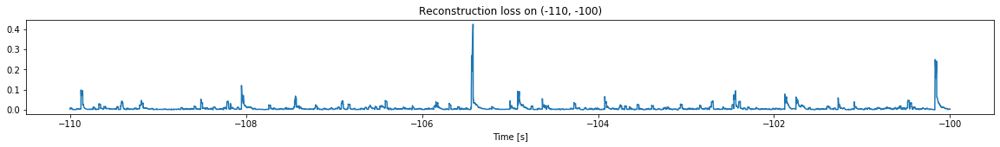

<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


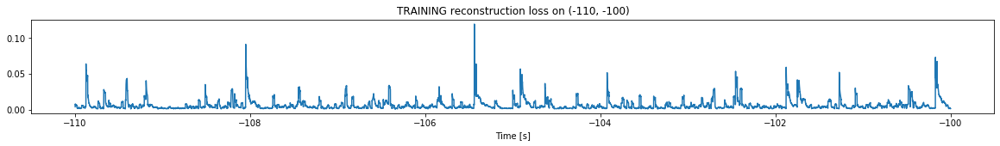

Finished training, median of the log(loss) is:  -2.404878783745419
Triggering for section:  (-100, -90)
Using this median for triggering: -2.366521693514576


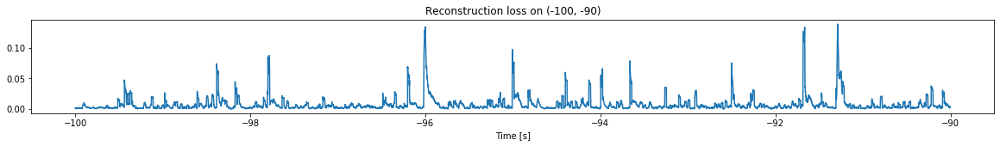

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


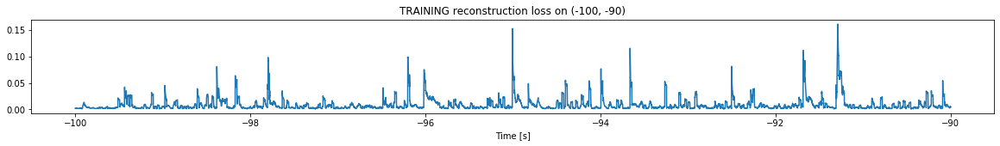

Finished training, median of the log(loss) is:  -2.29619104321198
Triggering for section:  (-90, -80)
Using this median for triggering: -2.404878783745419


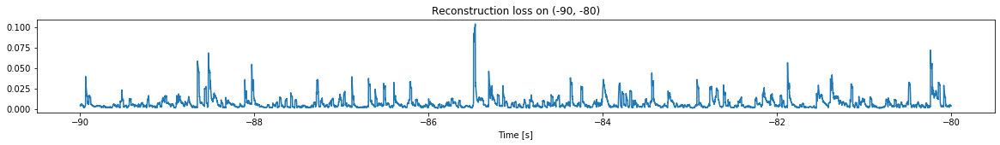

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


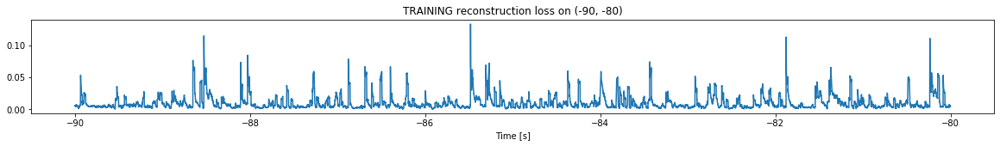

Finished training, median of the log(loss) is:  -2.1673331836068055
Triggering for section:  (-80, -70)
Using this median for triggering: -2.29619104321198


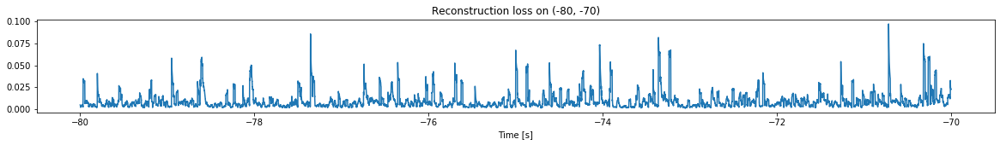

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


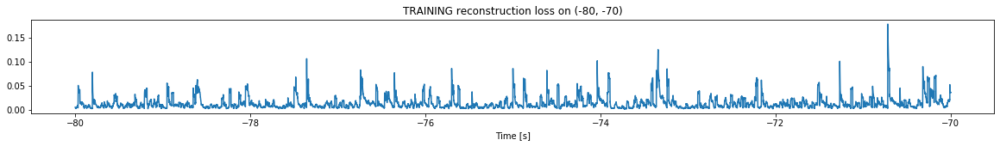

Finished training, median of the log(loss) is:  -2.016869593162281
Triggering for section:  (-70, -60)
Using this median for triggering: -2.1673331836068055


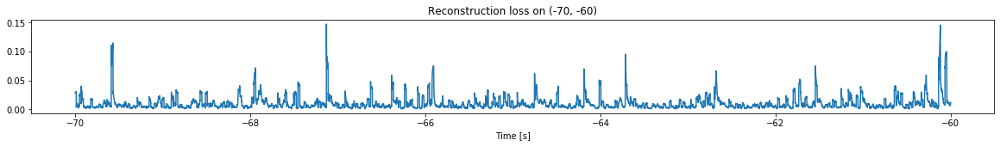

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


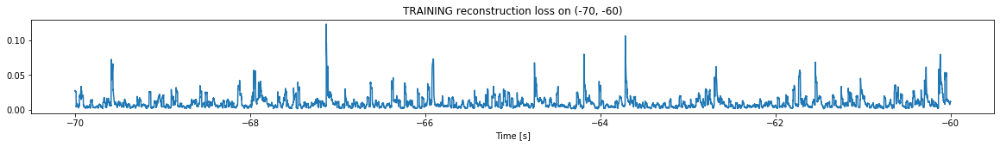

Finished training, median of the log(loss) is:  -2.1437617134324163
Triggering for section:  (-60, -50)
Using this median for triggering: -2.016869593162281


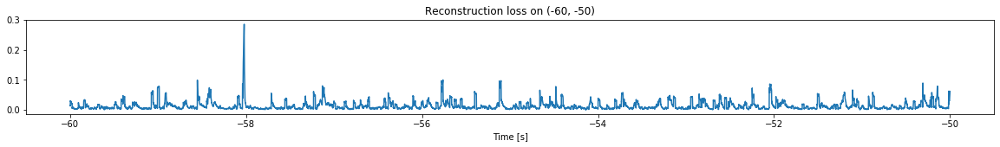

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


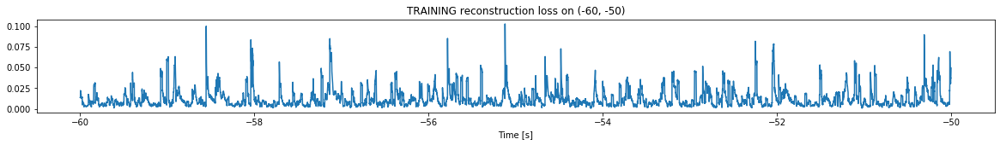

Finished training, median of the log(loss) is:  -2.0538967078092196
Triggering for section:  (-50, -40)
Using this median for triggering: -2.1437617134324163


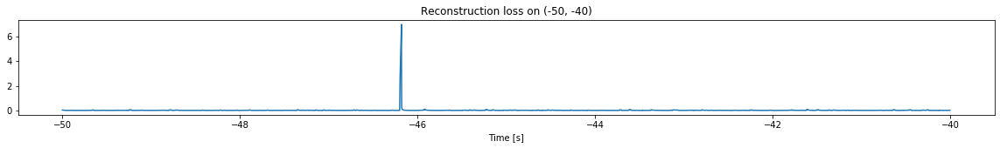

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


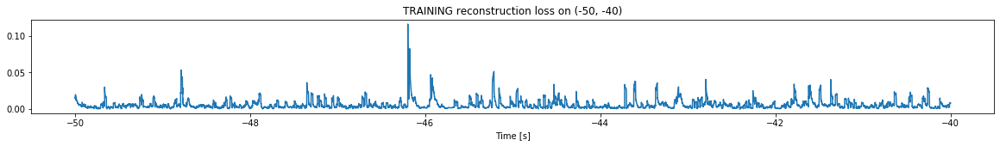

Finished training, median of the log(loss) is:  -2.347380046355493
Triggering for section:  (-40, -30)
Using this median for triggering: -2.0538967078092196


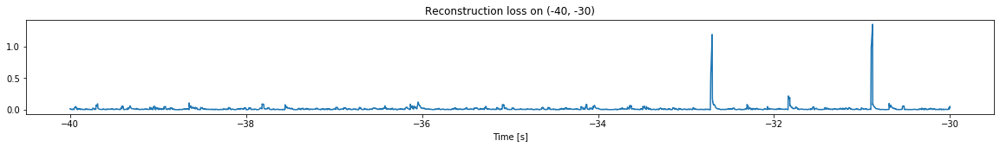

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


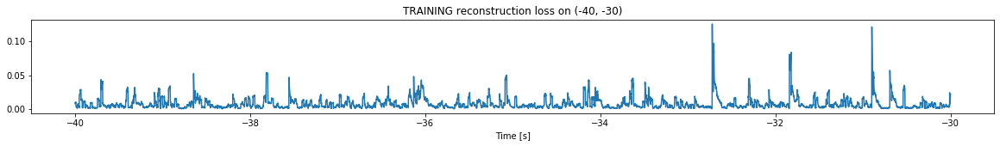

Finished training, median of the log(loss) is:  -2.2440668760187017
Triggering for section:  (-30, -20)
Using this median for triggering: -2.347380046355493


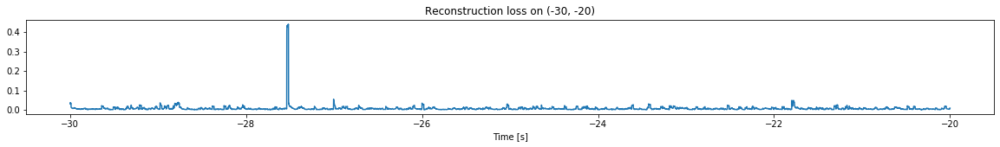

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


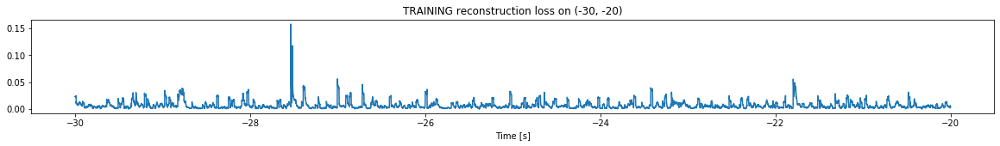

Finished training, median of the log(loss) is:  -2.2623442405419696
Triggering for section:  (-20, -10)
Using this median for triggering: -2.2440668760187017


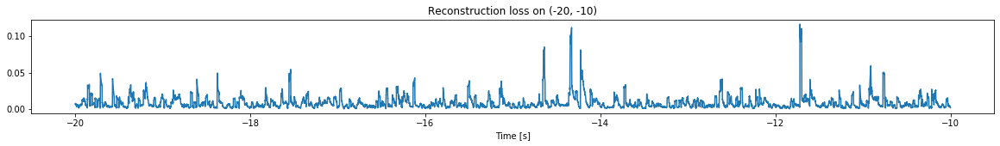

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


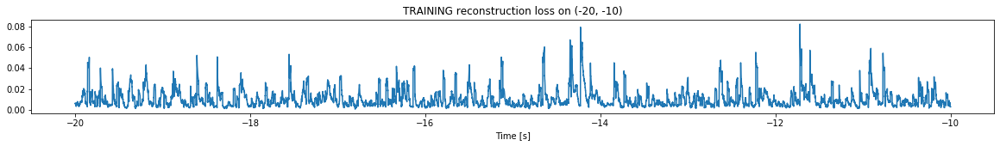

Finished training, median of the log(loss) is:  -2.099780898558465
Triggering for section:  (-10, 0)
Using this median for triggering: -2.2623442405419696


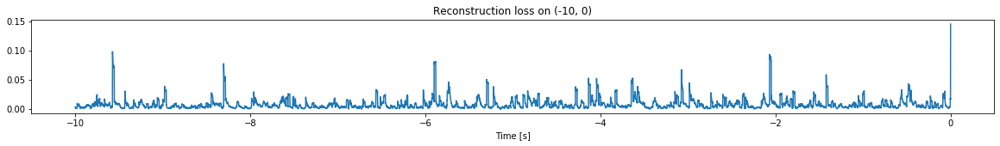

<--------
Finished simulation, all the triggered times are:  [-145.6043, -144.52678, -144.02179, -143.47359, -142.9188, -141.91309, -141.23909, -140.48679, -139.85579, -139.14058, -137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]


In [7]:
simulation("./data/Ramp20/", 10, (-212,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


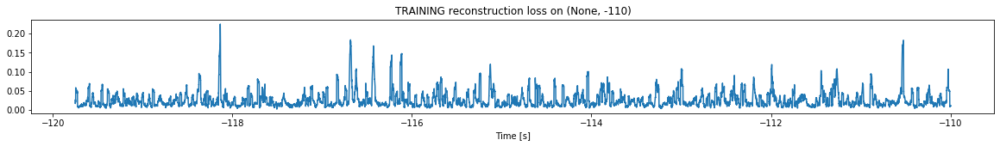

Finished training, median of the log(loss) is:  -1.6942783347093369
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


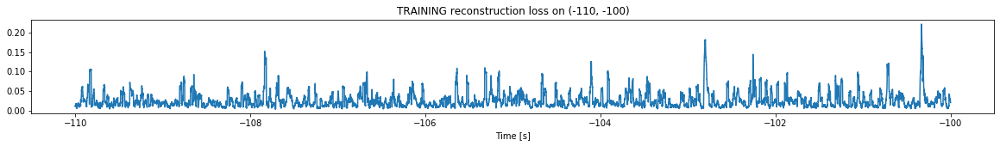

Finished training, median of the log(loss) is:  -1.6955405323765464
Triggering for section:  (-100, -90)
Using this median for triggering: -1.6942783347093369


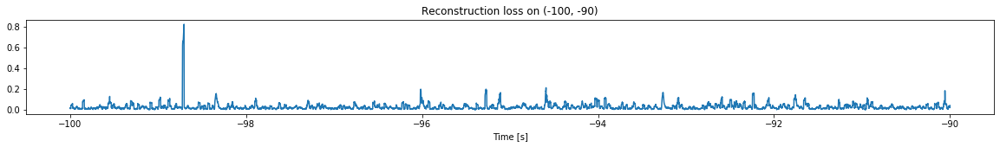

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


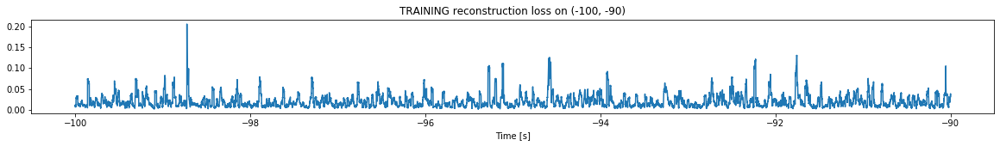

Finished training, median of the log(loss) is:  -1.794996836550086
Triggering for section:  (-90, -80)
Using this median for triggering: -1.6955405323765464


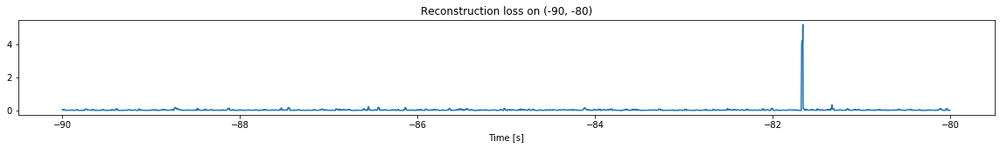

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


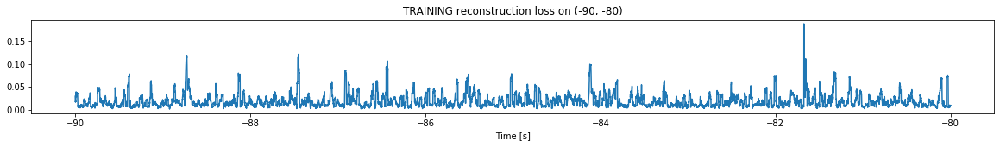

Finished training, median of the log(loss) is:  -1.8297511564334883
Triggering for section:  (-80, -70)
Using this median for triggering: -1.794996836550086


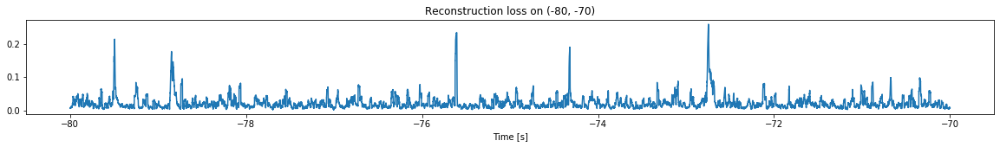

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


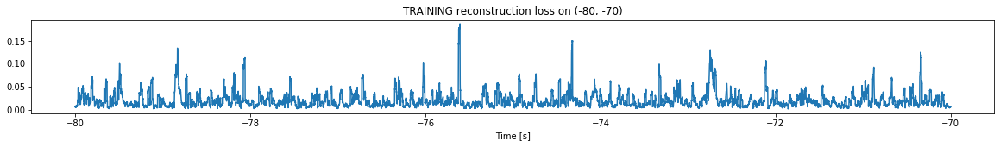

Finished training, median of the log(loss) is:  -1.7863224703598815
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8297511564334883


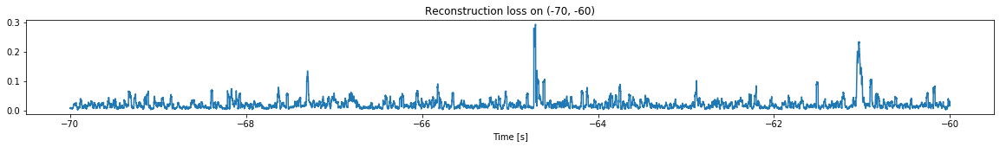

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


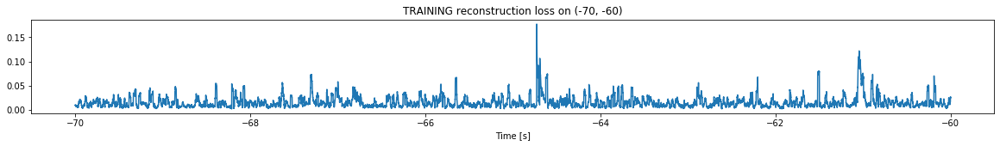

Finished training, median of the log(loss) is:  -1.9031615828624528
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7863224703598815


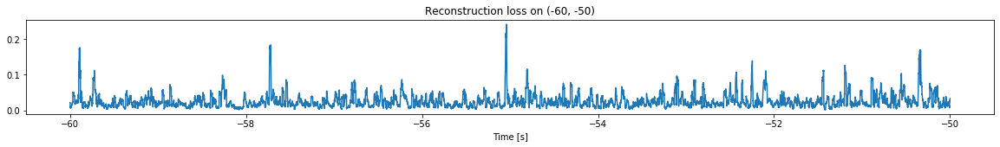

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


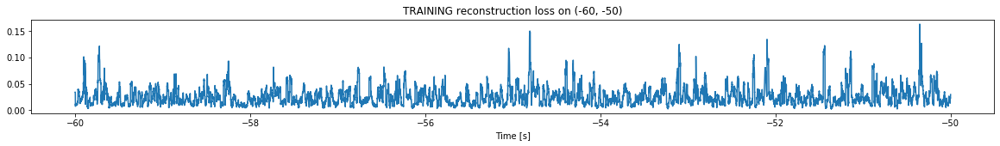

Finished training, median of the log(loss) is:  -1.644606413432891
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9031615828624528


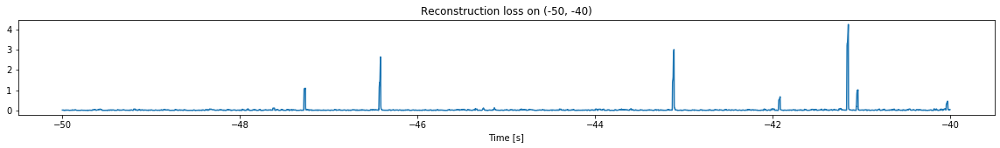

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


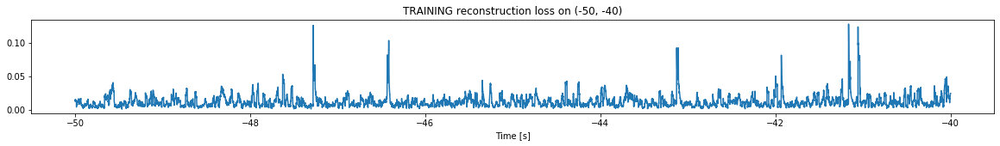

Finished training, median of the log(loss) is:  -2.0118053573799406
Triggering for section:  (-40, -30)
Using this median for triggering: -1.644606413432891


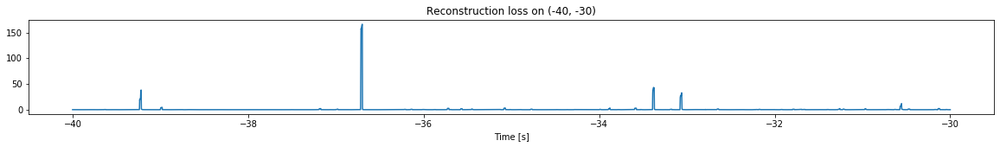

Other trigger time:  [-39.2193   -36.699398 -33.379498]
Their log loss values are:  [3.22697905 3.86463726 3.28015434]


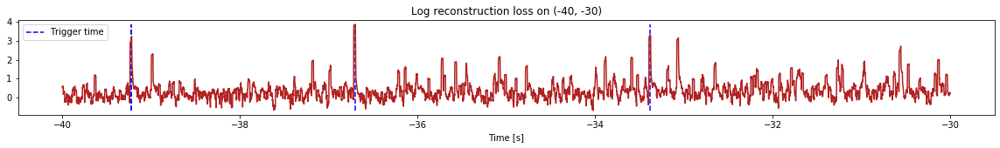

Triggered at:  [-39.2193, -36.699398, -33.379498]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


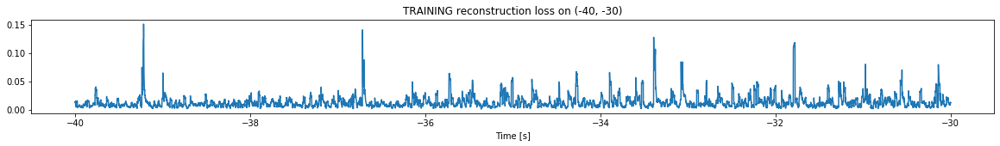

Finished training, median of the log(loss) is:  -1.9625716353674065
Triggering for section:  (-30, -20)
Using this median for triggering: -2.0118053573799406


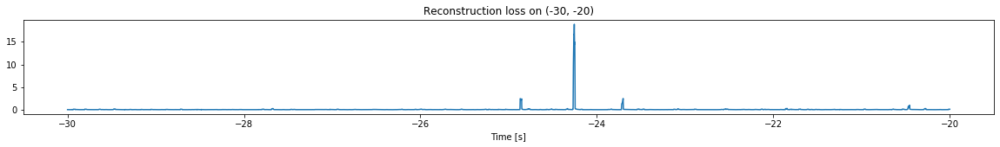

Other trigger time:  [-24.255999]
Their log loss values are:  [3.28791288]


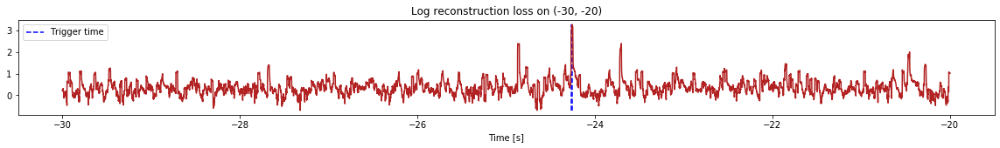

Triggered at:  [-24.255999]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


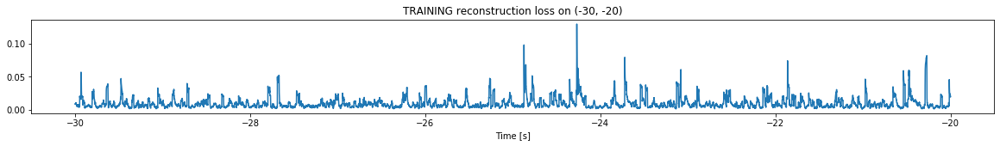

Finished training, median of the log(loss) is:  -2.133515220185619
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9625716353674065


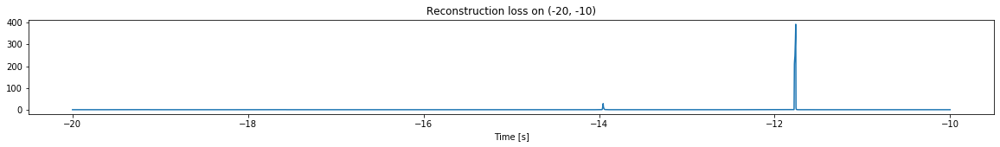

Other trigger time:  [-13.9532995 -11.759    ]
Their log loss values are:  [3.41103697 4.55663518]


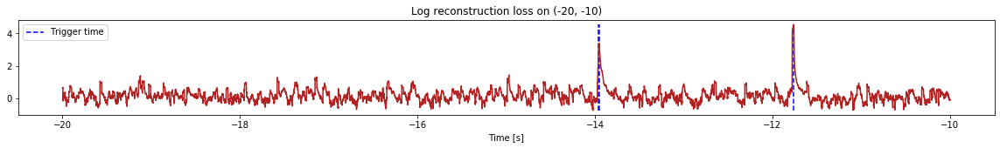

Triggered at:  [-13.9532995, -11.759]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


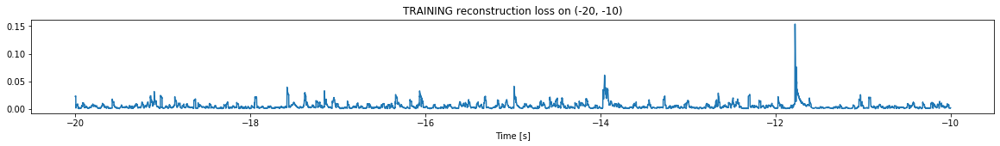

Finished training, median of the log(loss) is:  -2.411551818075012
Triggering for section:  (-10, 0)
Using this median for triggering: -2.133515220185619


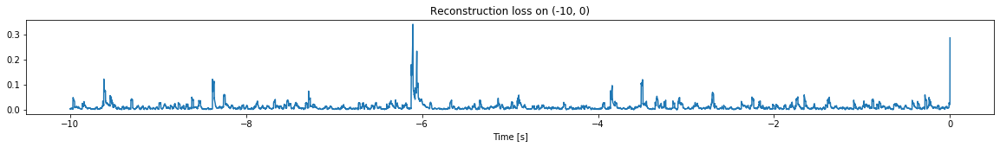

<--------
Finished simulation, all the triggered times are:  [-39.2193, -36.699398, -33.379498, -24.255999, -13.9532995, -11.759]


In [8]:
simulation("./data/Ramp21/", 10, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (797500, 12)
Flushing input history
Number of sections: 8
Entering sections:  (-80, -70)
-------->
Entering sections:  (-70, -60)
-------->
Training for section:  (None, -70)


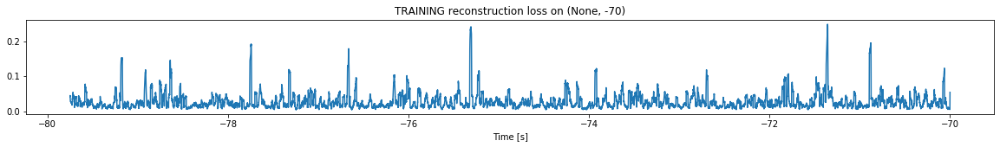

Finished training, median of the log(loss) is:  -1.6633162591495851
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


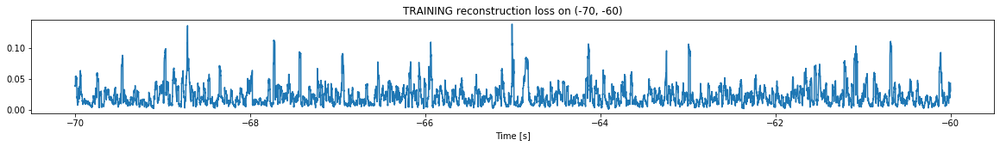

Finished training, median of the log(loss) is:  -1.724295589138016
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6633162591495851


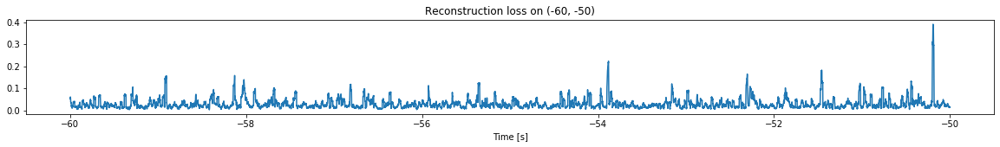

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


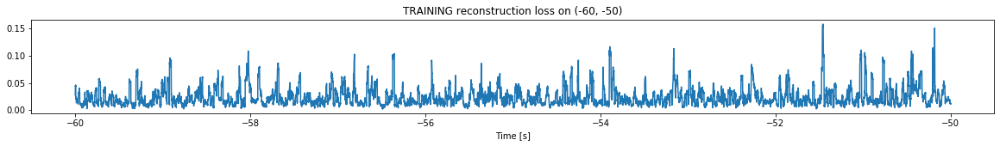

Finished training, median of the log(loss) is:  -1.715098524133534
Triggering for section:  (-50, -40)
Using this median for triggering: -1.724295589138016


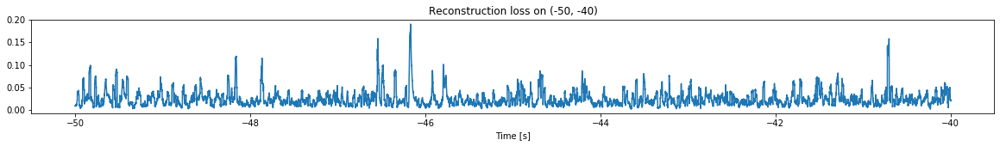

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


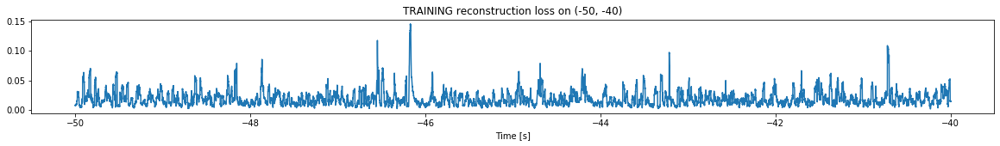

Finished training, median of the log(loss) is:  -1.8049878581516463
Triggering for section:  (-40, -30)
Using this median for triggering: -1.715098524133534


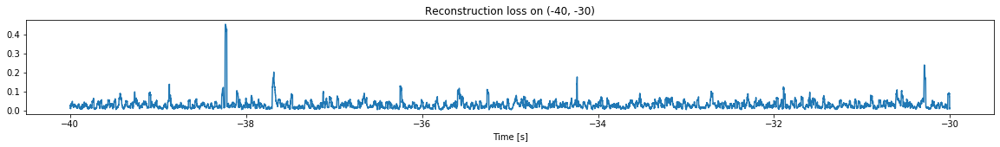

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


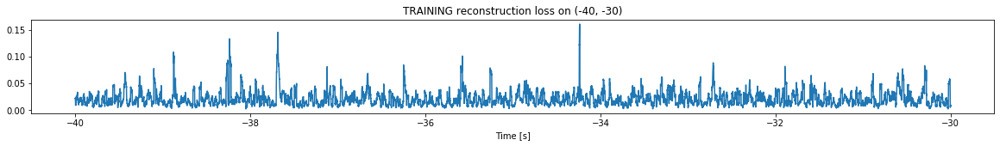

Finished training, median of the log(loss) is:  -1.7327455918705374
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8049878581516463


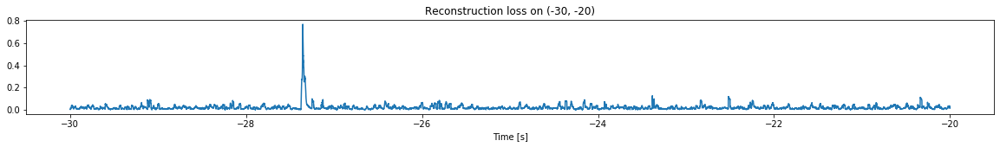

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


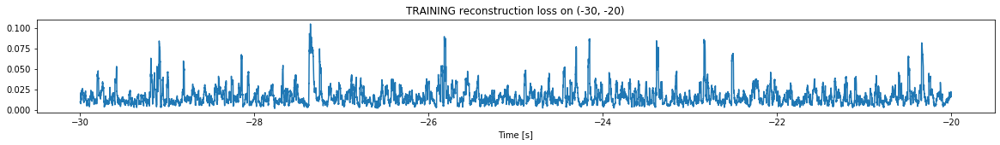

Finished training, median of the log(loss) is:  -1.8694301024690398
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7327455918705374


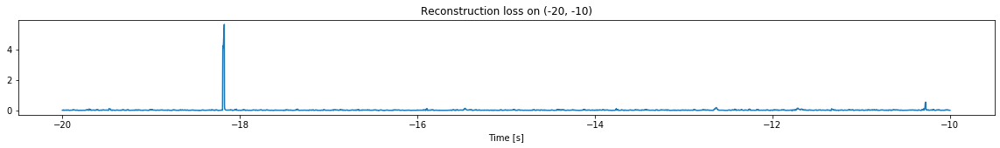

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


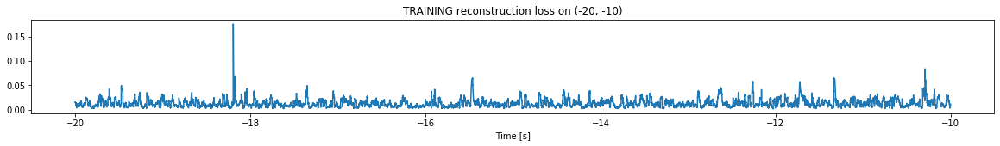

Finished training, median of the log(loss) is:  -1.9445280116286472
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8694301024690398


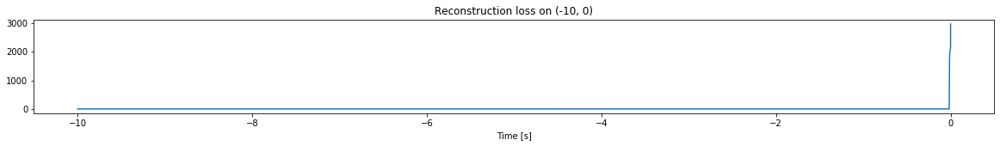

Other trigger time:  []
Their log loss values are:  []


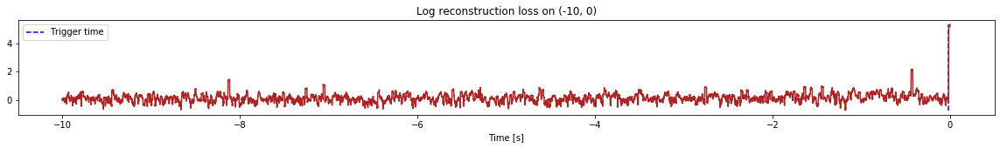

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [9]:
simulation("./data/Ramp22/", 10, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 5
Entering sections:  (-50, -40)
-------->
Entering sections:  (-40, -30)
-------->
Training for section:  (None, -40)


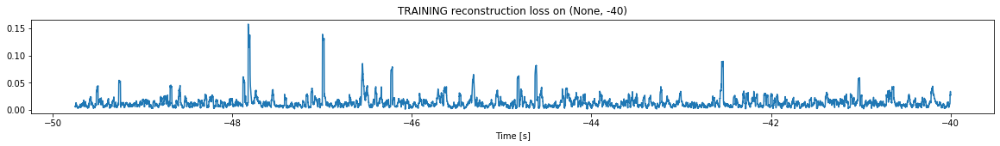

Finished training, median of the log(loss) is:  -1.94618045688063
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


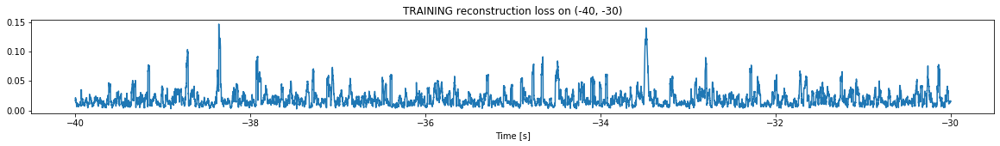

Finished training, median of the log(loss) is:  -1.7949323831016049
Triggering for section:  (-30, -20)
Using this median for triggering: -1.94618045688063


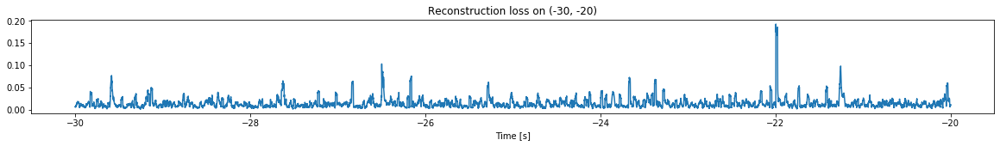

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


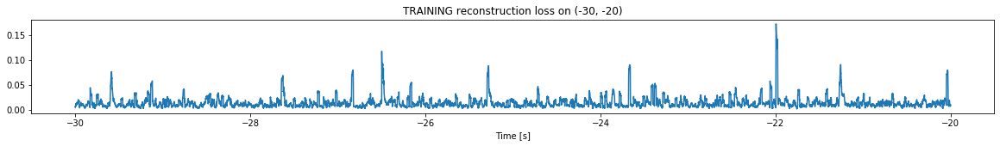

Finished training, median of the log(loss) is:  -1.966583571514135
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7949323831016049


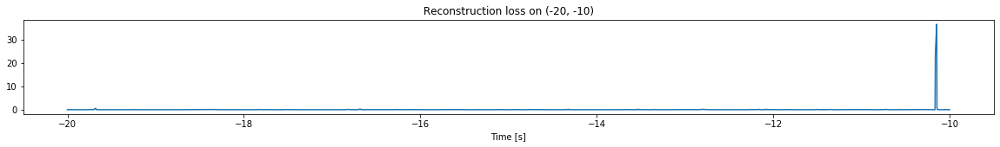

Other trigger time:  [-10.1461]
Their log loss values are:  [3.35892742]


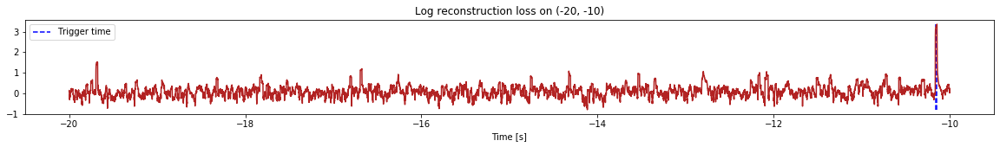

Triggered at:  [-10.1461]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


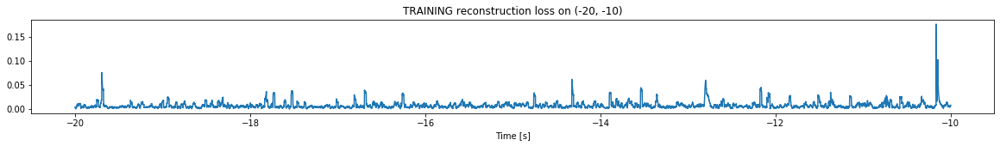

Finished training, median of the log(loss) is:  -2.1900950441626885
Triggering for section:  (-10, 0)
Using this median for triggering: -1.966583571514135


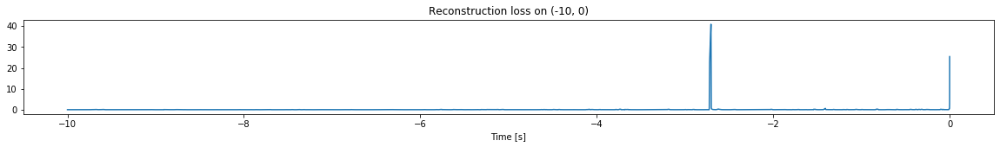

Other trigger time:  [-2.7054]
Their log loss values are:  [3.57883779]


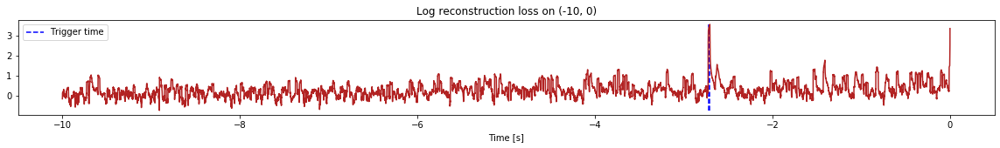

Triggered at:  [-2.7054]
<--------
Finished simulation, all the triggered times are:  [-10.1461, -2.7054]


In [10]:
simulation("./data/Ramp23/", 10, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


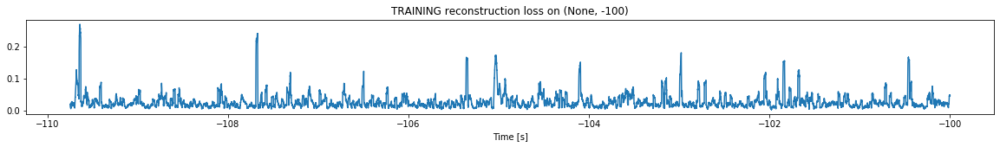

Finished training, median of the log(loss) is:  -1.6477446858185734
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


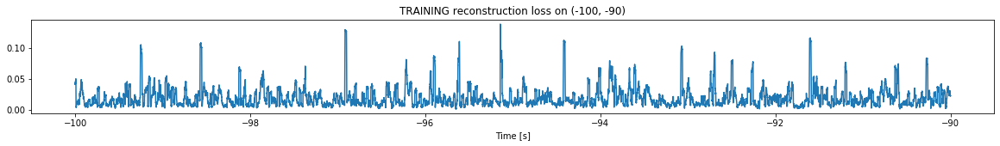

Finished training, median of the log(loss) is:  -1.800471375865512
Triggering for section:  (-90, -80)
Using this median for triggering: -1.6477446858185734


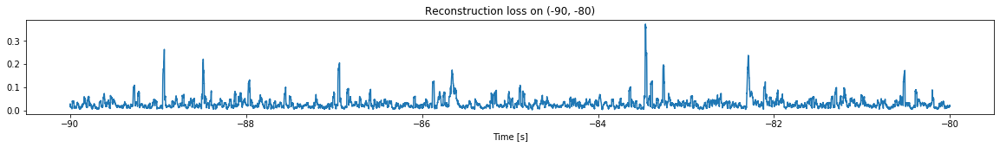

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


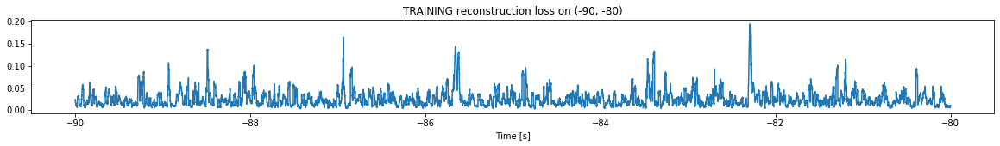

Finished training, median of the log(loss) is:  -1.67462792586839
Triggering for section:  (-80, -70)
Using this median for triggering: -1.800471375865512


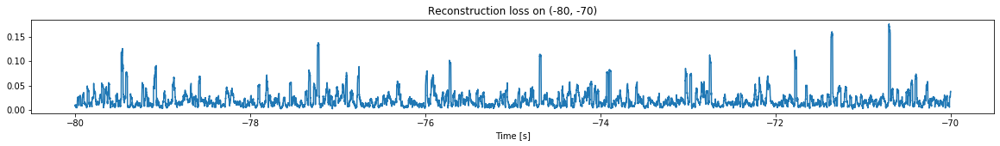

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


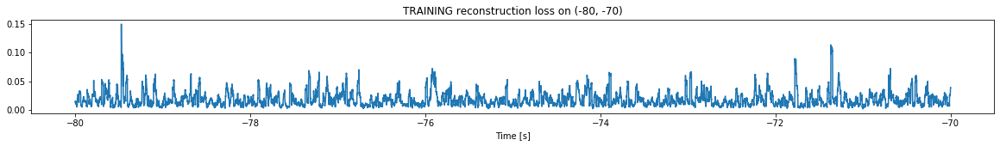

Finished training, median of the log(loss) is:  -1.8187694063840119
Triggering for section:  (-70, -60)
Using this median for triggering: -1.67462792586839


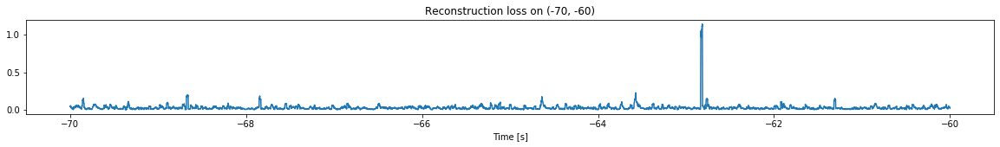

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


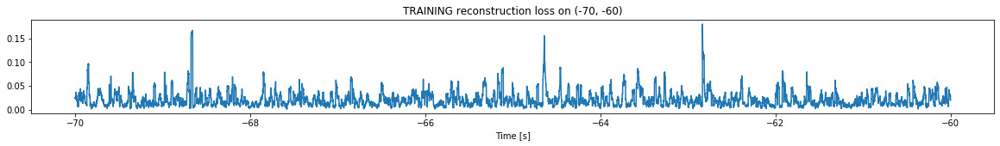

Finished training, median of the log(loss) is:  -1.7407709932067261
Triggering for section:  (-60, -50)
Using this median for triggering: -1.8187694063840119


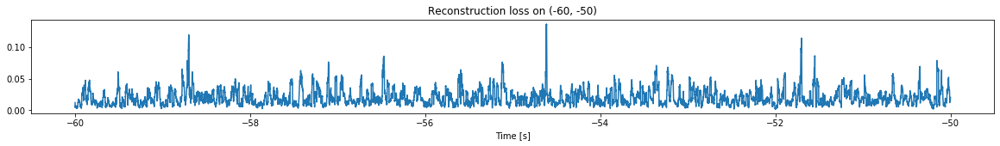

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


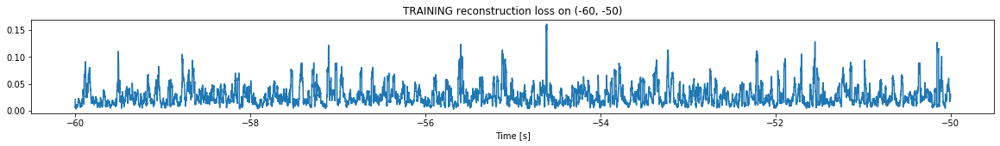

Finished training, median of the log(loss) is:  -1.6349822100210627
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7407709932067261


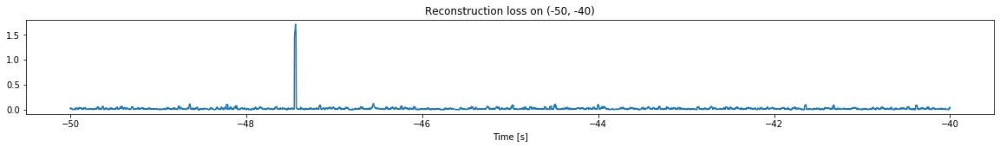

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


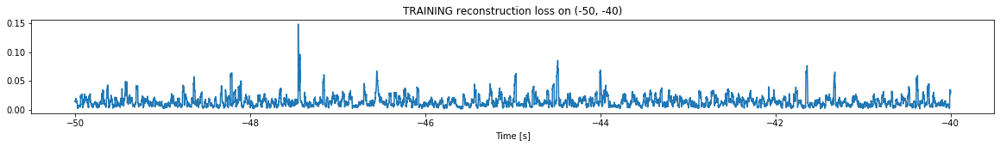

Finished training, median of the log(loss) is:  -1.9144659052470967
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6349822100210627


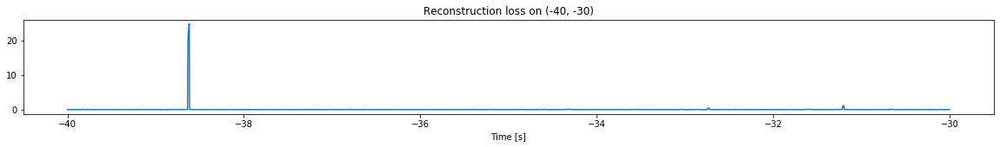

Other trigger time:  [-38.618797]
Their log loss values are:  [3.02717674]


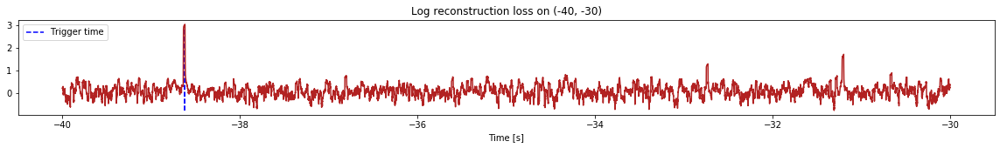

Triggered at:  [-38.618797]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


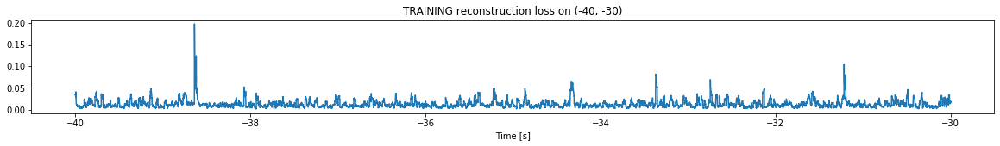

Finished training, median of the log(loss) is:  -1.961224299605861
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9144659052470967


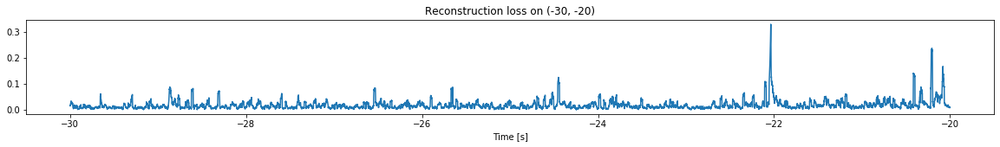

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


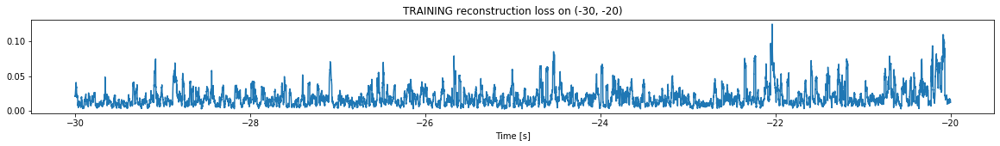

Finished training, median of the log(loss) is:  -1.8070778810920158
Triggering for section:  (-20, -10)
Using this median for triggering: -1.961224299605861


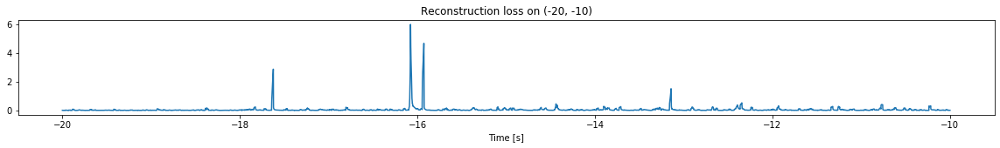

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


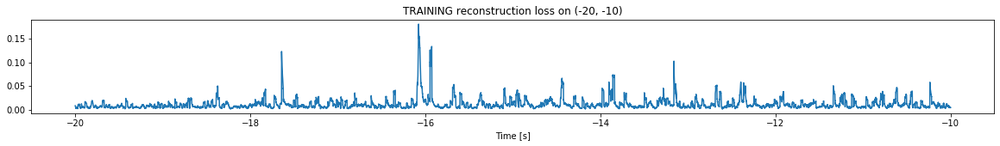

Finished training, median of the log(loss) is:  -2.065623878654176
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8070778810920158


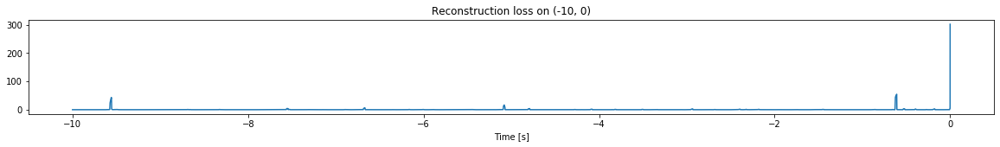

Other trigger time:  [-9.5574 -5.0804 -0.6089]
Their log loss values are:  [3.4434234  3.02912503 3.5446147 ]


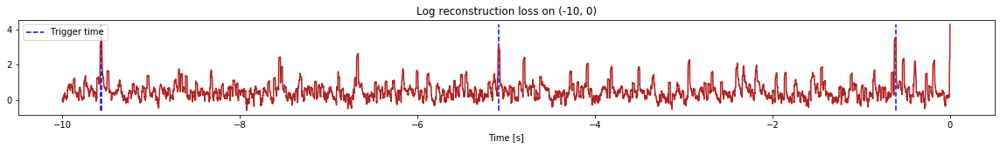

Triggered at:  [-9.5574, -5.0804, -0.6089]
<--------
Finished simulation, all the triggered times are:  [-38.618797, -9.5574, -5.0804, -0.6089]


In [11]:
simulation("./data/Ramp24/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


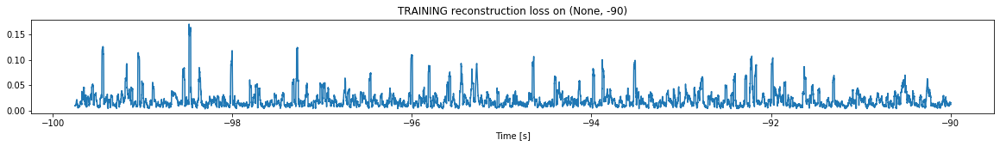

Finished training, median of the log(loss) is:  -1.7952635025079389
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


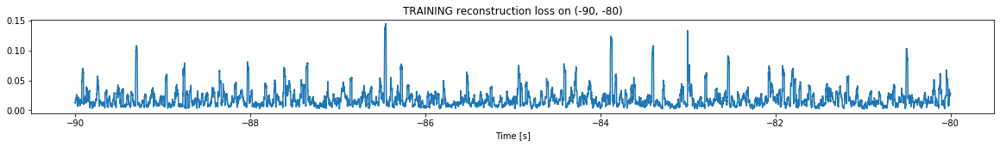

Finished training, median of the log(loss) is:  -1.8210992013560936
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7952635025079389


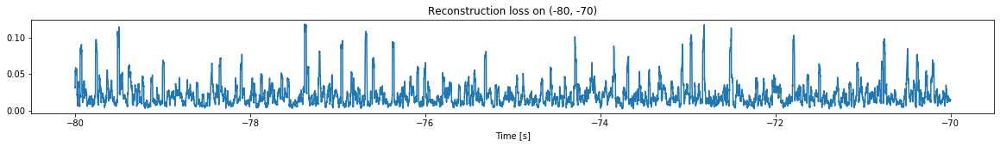

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


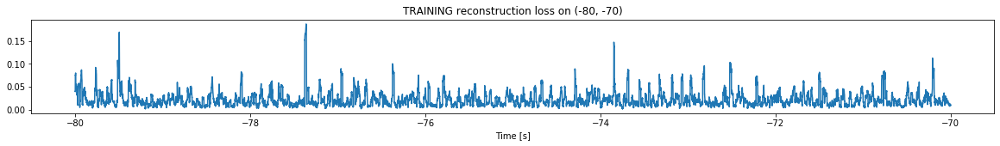

Finished training, median of the log(loss) is:  -1.7190348600912224
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8210992013560936


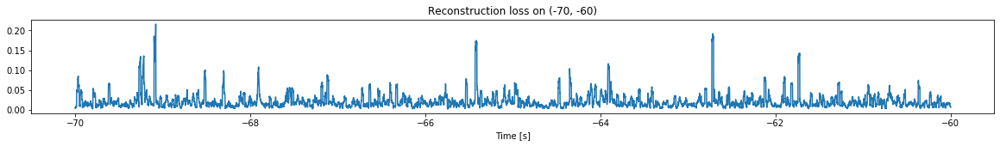

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


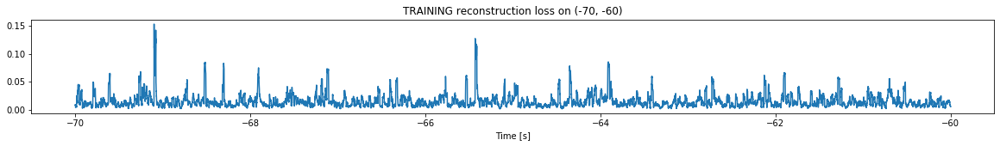

Finished training, median of the log(loss) is:  -1.9104445402088295
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7190348600912224


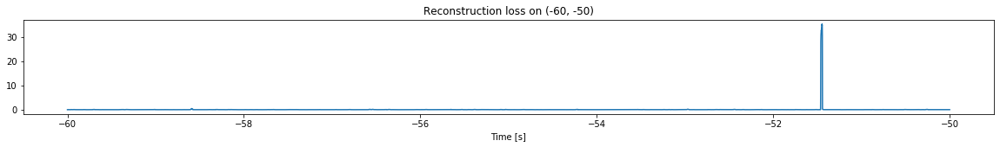

Other trigger time:  [-51.4463]
Their log loss values are:  [3.26703148]


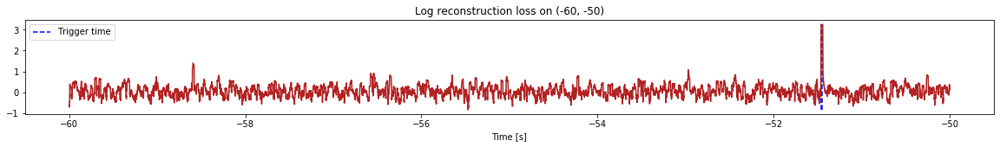

Triggered at:  [-51.4463]
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


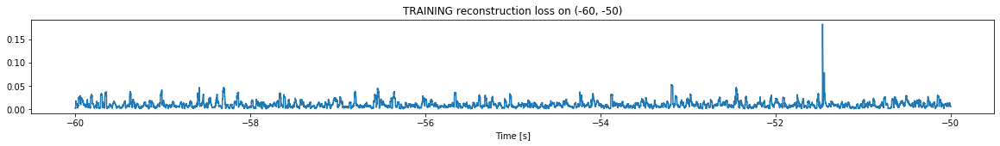

Finished training, median of the log(loss) is:  -2.0466291763171327
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9104445402088295


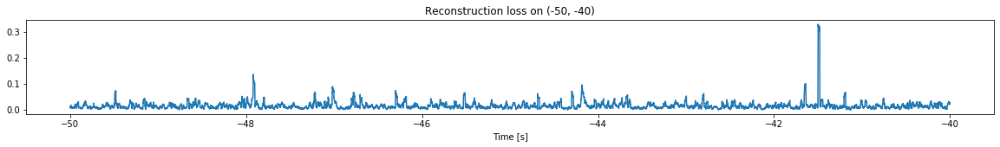

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


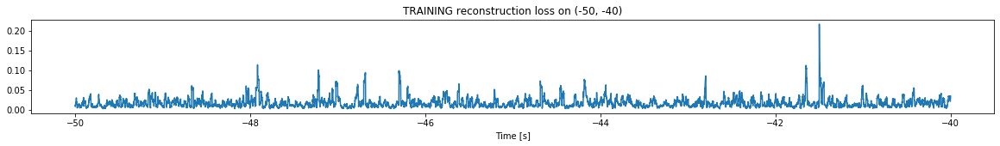

Finished training, median of the log(loss) is:  -1.8468981588161886
Triggering for section:  (-40, -30)
Using this median for triggering: -2.0466291763171327


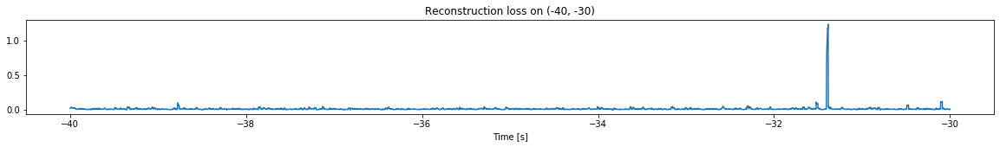

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


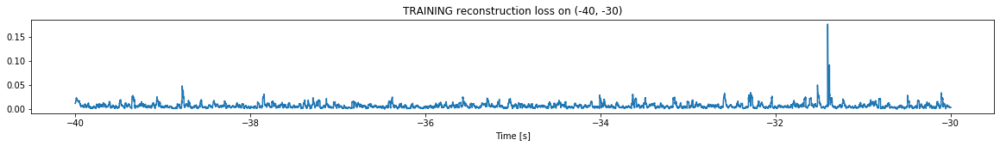

Finished training, median of the log(loss) is:  -2.2158822048909856
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8468981588161886


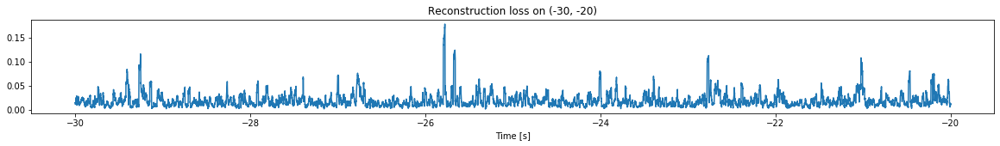

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


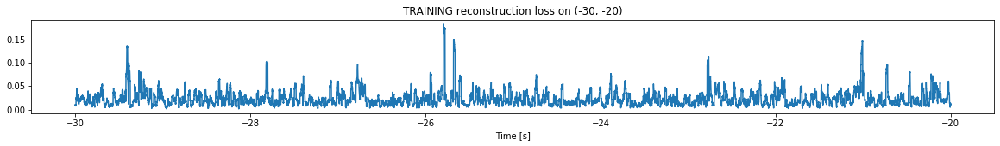

Finished training, median of the log(loss) is:  -1.7043927595855775
Triggering for section:  (-20, -10)
Using this median for triggering: -2.2158822048909856


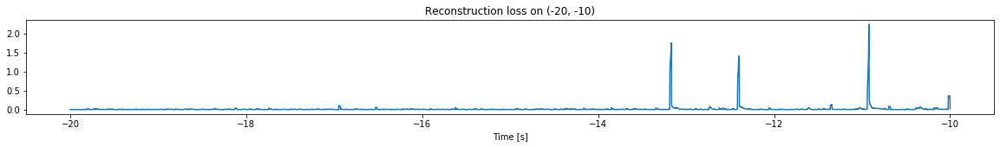

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


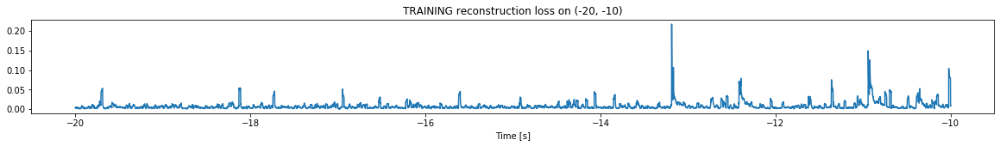

Finished training, median of the log(loss) is:  -2.249162109692782
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7043927595855775


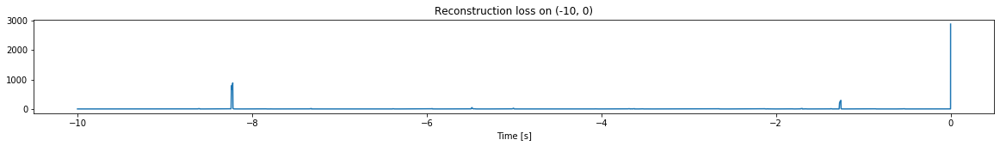

Other trigger time:  [-8.2217    -5.4825    -1.2574999]
Their log loss values are:  [4.65103273 3.38637773 4.17190137]


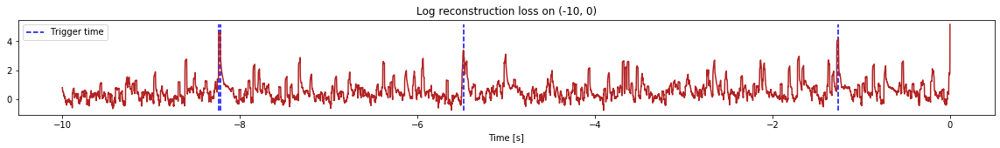

Triggered at:  [-8.2217, -5.4825, -1.2574999]
<--------
Finished simulation, all the triggered times are:  [-51.4463, -8.2217, -5.4825, -1.2574999]


In [12]:
simulation("./data/Ramp25/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


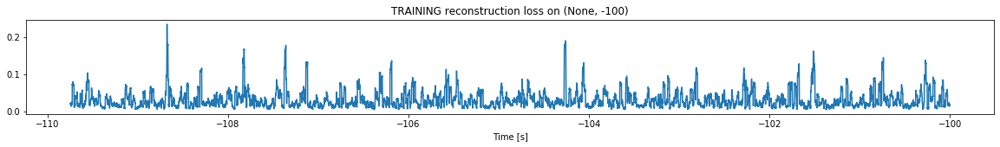

Finished training, median of the log(loss) is:  -1.600009285602848
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


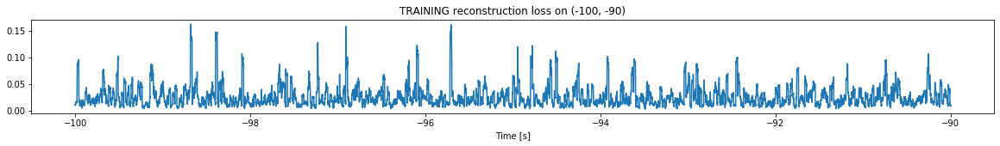

Finished training, median of the log(loss) is:  -1.6688970415230178
Triggering for section:  (-90, -80)
Using this median for triggering: -1.600009285602848


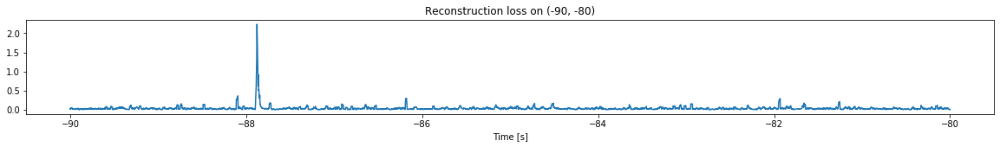

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


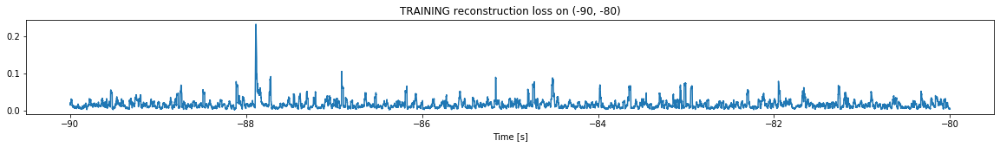

Finished training, median of the log(loss) is:  -1.8747961469795162
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6688970415230178


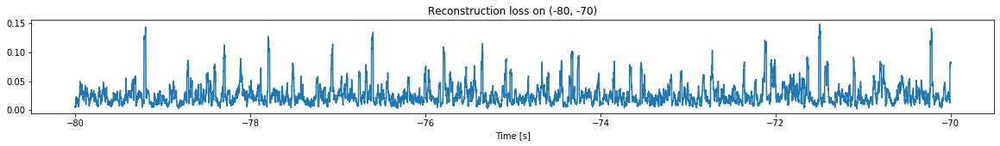

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


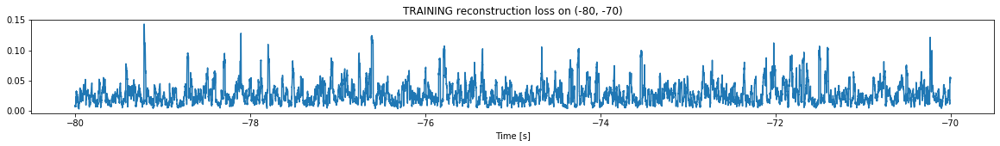

Finished training, median of the log(loss) is:  -1.6192090150819411
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8747961469795162


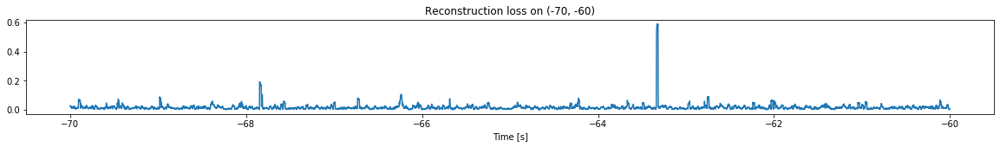

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


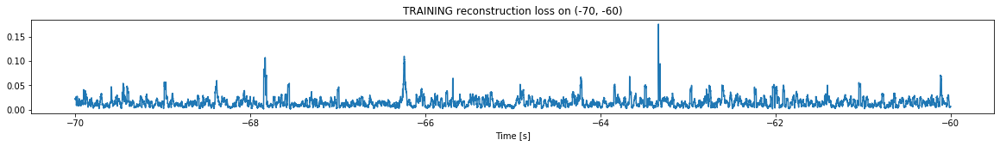

Finished training, median of the log(loss) is:  -1.8898284145586564
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6192090150819411


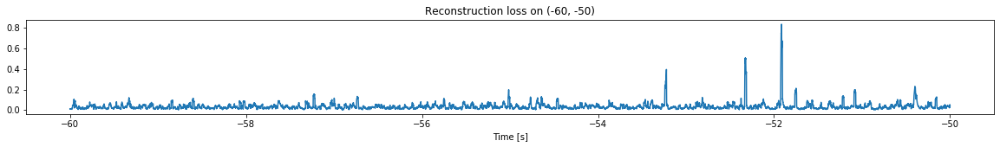

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


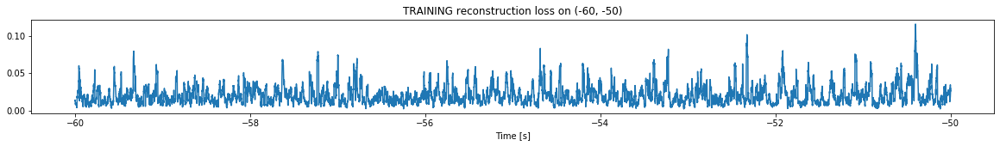

Finished training, median of the log(loss) is:  -1.750456407255462
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8898284145586564


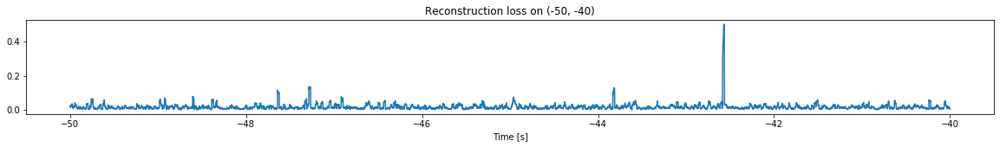

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


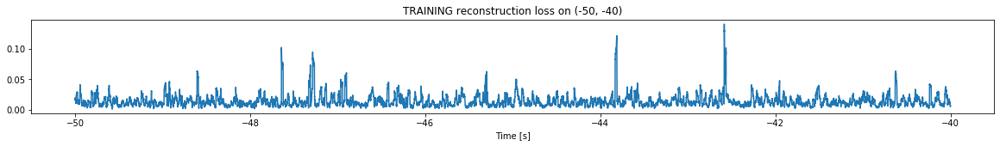

Finished training, median of the log(loss) is:  -1.922611751763034
Triggering for section:  (-40, -30)
Using this median for triggering: -1.750456407255462


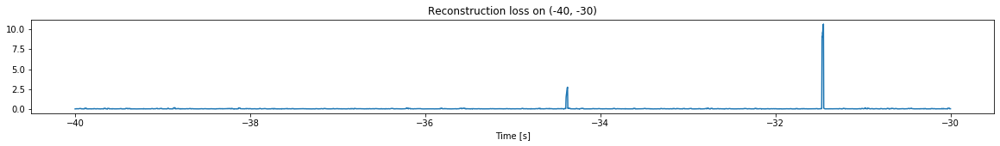

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


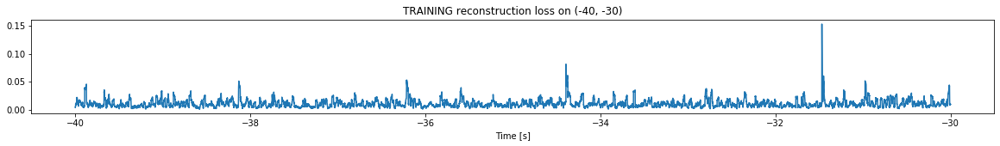

Finished training, median of the log(loss) is:  -2.0277574328284724
Triggering for section:  (-30, -20)
Using this median for triggering: -1.922611751763034


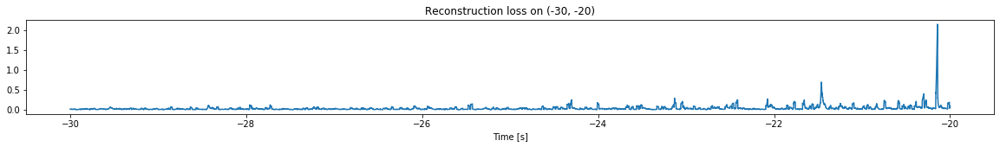

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


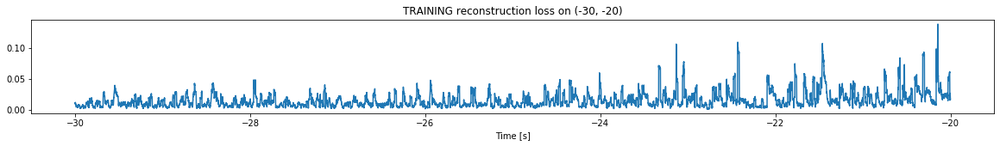

Finished training, median of the log(loss) is:  -1.9346753284722653
Triggering for section:  (-20, -10)
Using this median for triggering: -2.0277574328284724


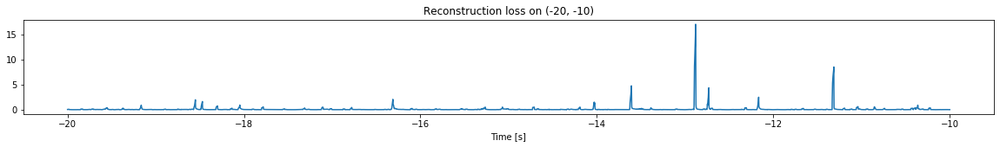

Other trigger time:  [-12.8804]
Their log loss values are:  [3.25829569]


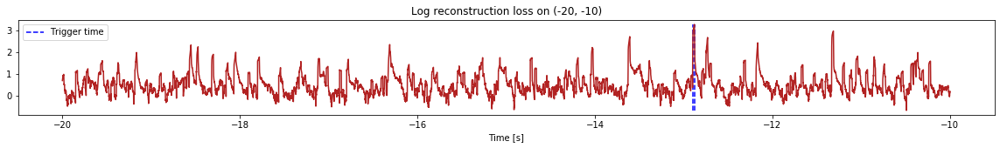

Triggered at:  [-12.8804]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


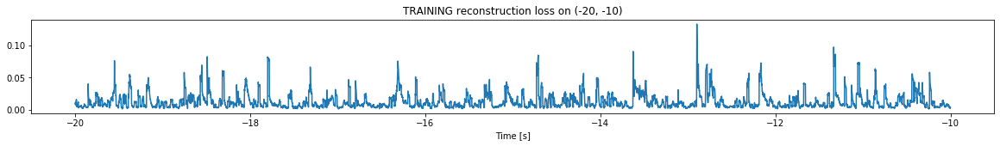

Finished training, median of the log(loss) is:  -2.0569748374060826
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9346753284722653


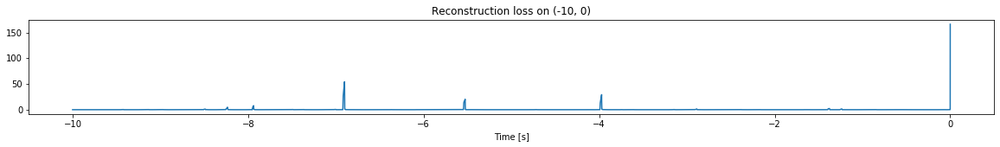

Other trigger time:  [-6.9013 -5.5269 -3.9722]
Their log loss values are:  [3.67014851 3.24285056 3.40016177]


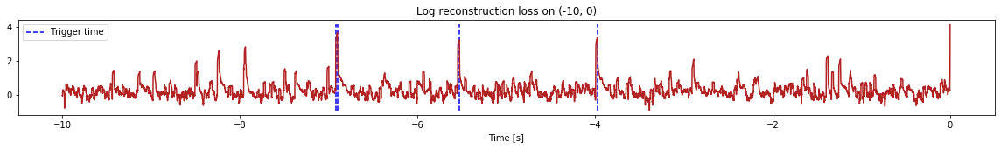

Triggered at:  [-6.9013, -5.5269, -3.9722]
<--------
Finished simulation, all the triggered times are:  [-12.8804, -6.9013, -5.5269, -3.9722]


In [13]:
simulation("./data/Ramp26/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (697500, 12)
Flushing input history
Number of sections: 7
Entering sections:  (-70, -60)
-------->
Entering sections:  (-60, -50)
-------->
Training for section:  (None, -60)


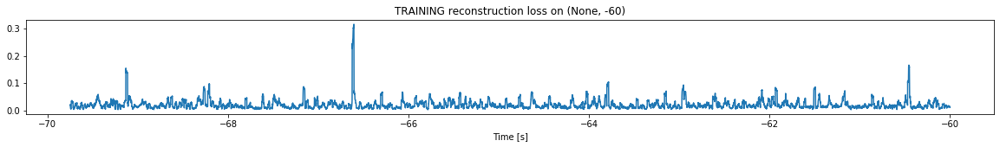

Finished training, median of the log(loss) is:  -1.7640975341737584
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


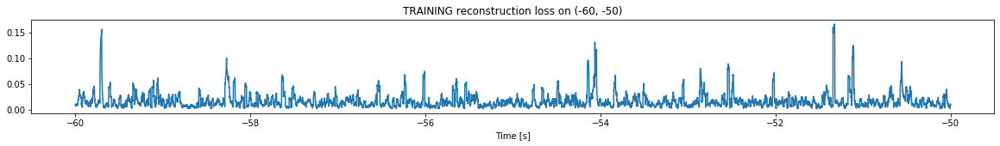

Finished training, median of the log(loss) is:  -1.875118644844715
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7640975341737584


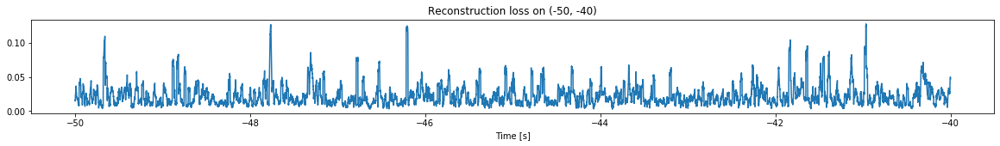

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


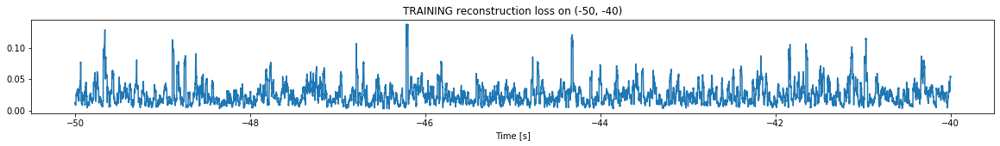

Finished training, median of the log(loss) is:  -1.6555081975453296
Triggering for section:  (-40, -30)
Using this median for triggering: -1.875118644844715


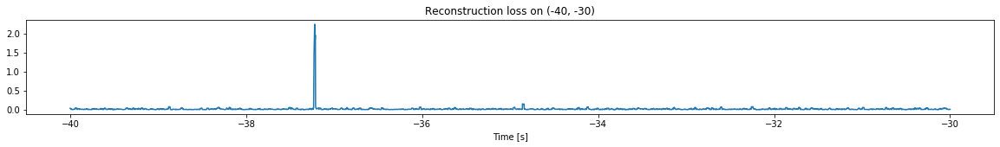

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


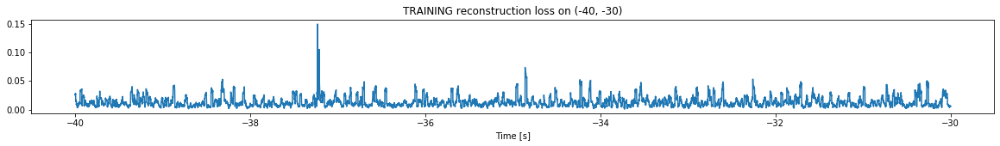

Finished training, median of the log(loss) is:  -1.9625281145837241
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6555081975453296


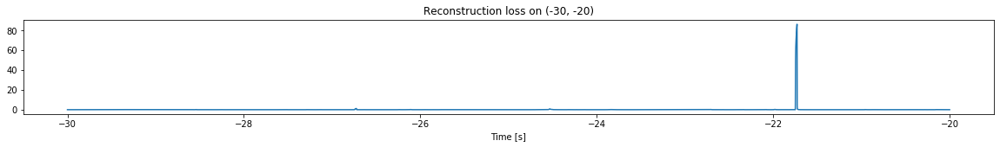

Other trigger time:  [-21.7299]
Their log loss values are:  [3.59261658]


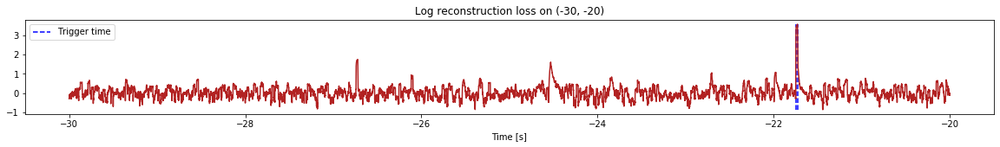

Triggered at:  [-21.7299]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


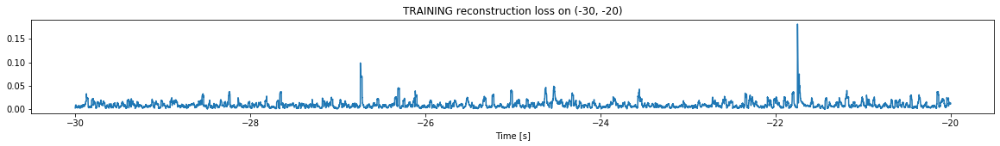

Finished training, median of the log(loss) is:  -2.0914861260985838
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9625281145837241


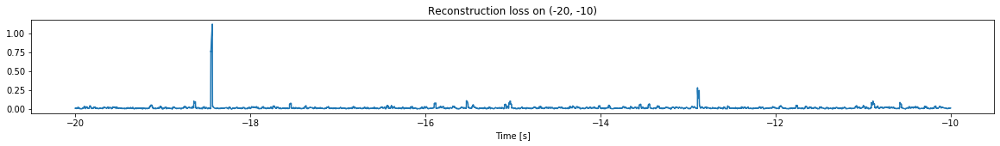

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


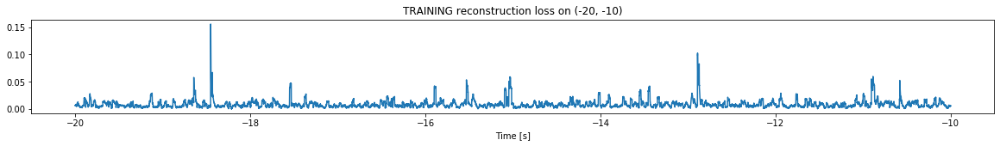

Finished training, median of the log(loss) is:  -2.1256964318172904
Triggering for section:  (-10, 0)
Using this median for triggering: -2.0914861260985838


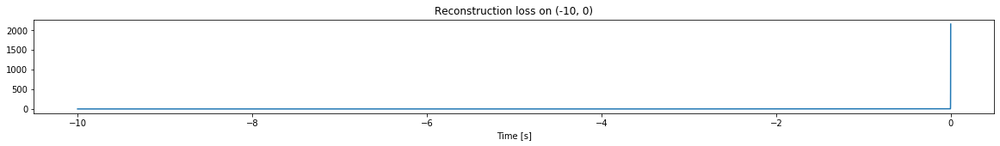

Other trigger time:  []
Their log loss values are:  []


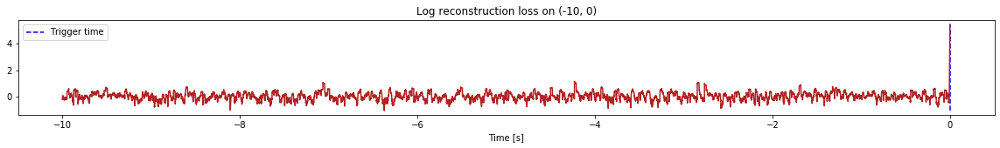

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [-21.7299]


In [14]:
simulation("./data/Ramp27/", 10, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (597500, 12)
Flushing input history
Number of sections: 6
Entering sections:  (-60, -50)
-------->
Entering sections:  (-50, -40)
-------->
Training for section:  (None, -50)


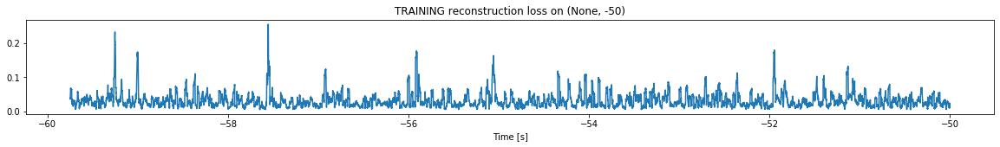

Finished training, median of the log(loss) is:  -1.5741368796113446
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


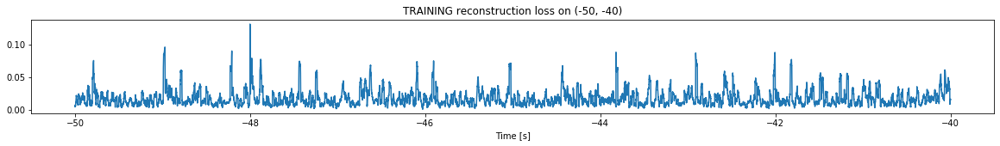

Finished training, median of the log(loss) is:  -1.8366073854300506
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5741368796113446


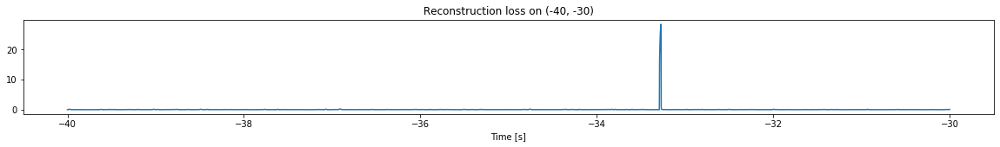

Other trigger time:  [-33.271297]
Their log loss values are:  [3.02886434]


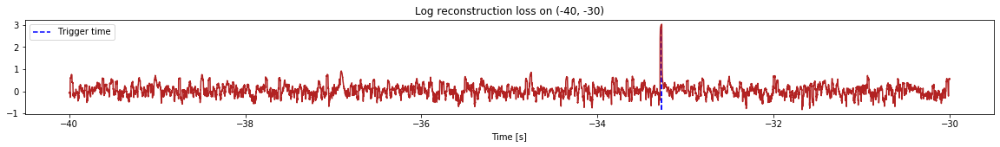

Triggered at:  [-33.271297]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


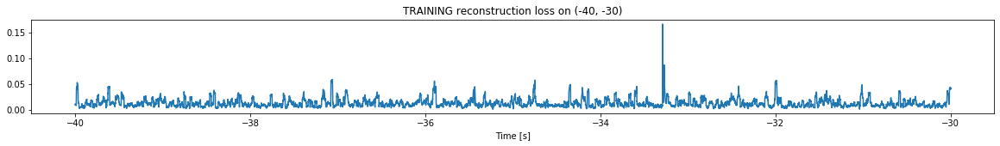

Finished training, median of the log(loss) is:  -1.975178001011351
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8366073854300506


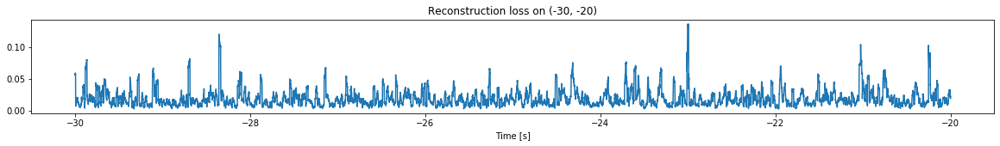

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


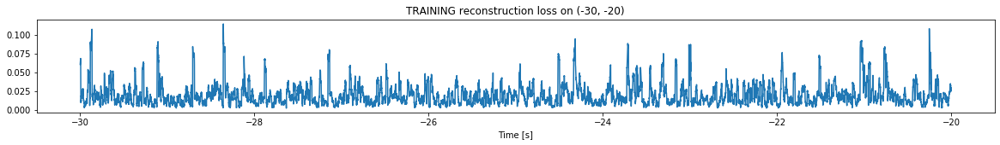

Finished training, median of the log(loss) is:  -1.766040720795114
Triggering for section:  (-20, -10)
Using this median for triggering: -1.975178001011351


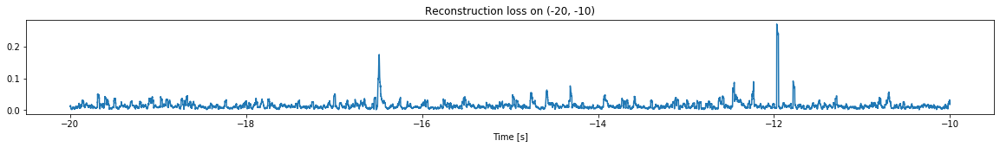

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


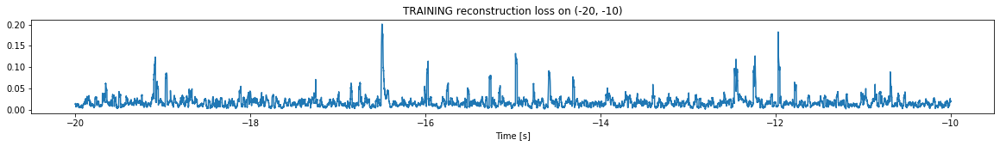

Finished training, median of the log(loss) is:  -1.815250837333048
Triggering for section:  (-10, 0)
Using this median for triggering: -1.766040720795114


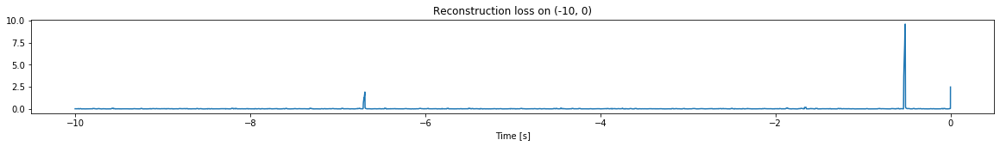

<--------
Finished simulation, all the triggered times are:  [-33.271297]


In [15]:
simulation("./data/Ramp28/", 10, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


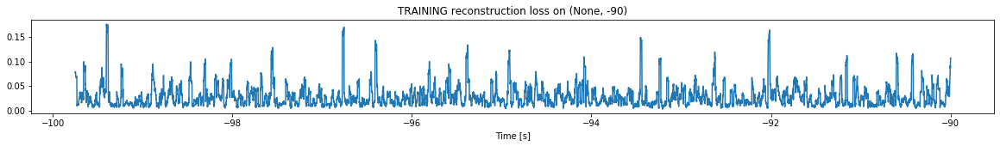

Finished training, median of the log(loss) is:  -1.6354391645839885
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


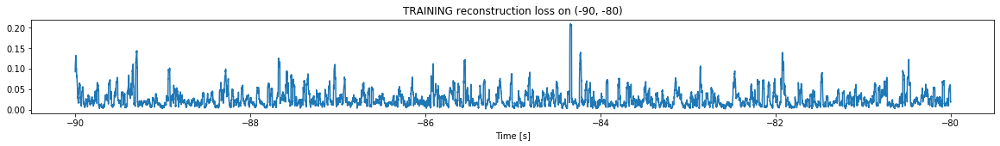

Finished training, median of the log(loss) is:  -1.679896367612793
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6354391645839885


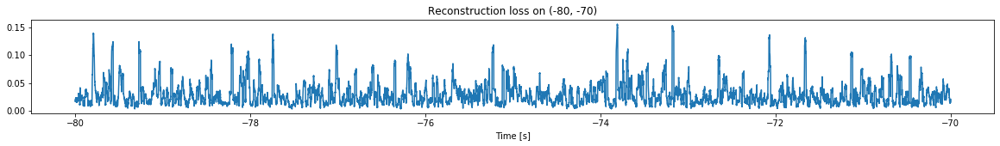

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


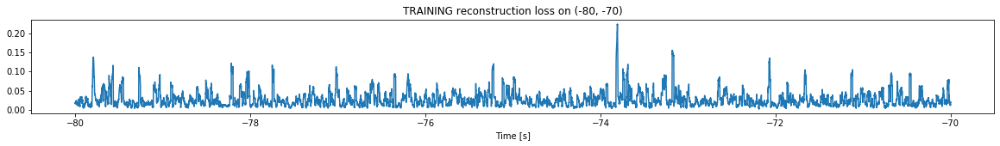

Finished training, median of the log(loss) is:  -1.6553618715130578
Triggering for section:  (-70, -60)
Using this median for triggering: -1.679896367612793


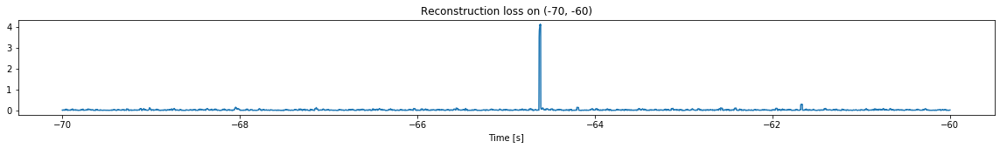

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


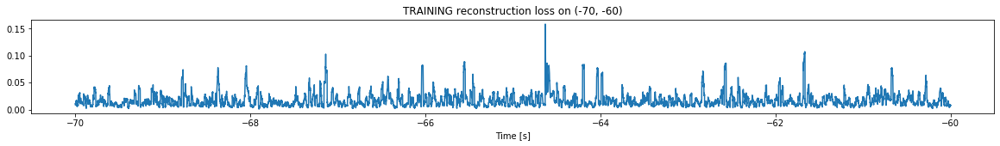

Finished training, median of the log(loss) is:  -1.8475835946210677
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6553618715130578


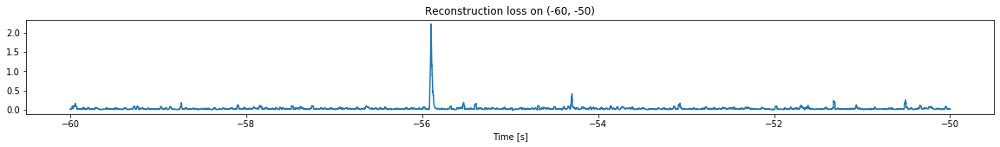

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


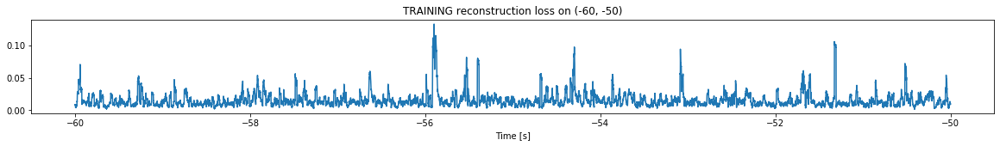

Finished training, median of the log(loss) is:  -1.8915130666292936
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8475835946210677


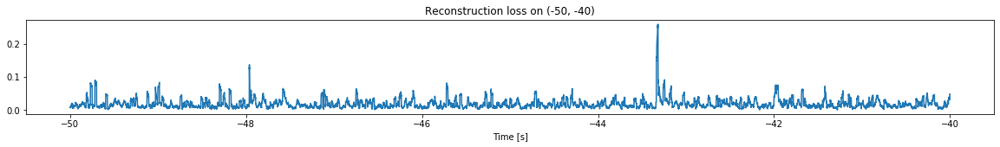

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


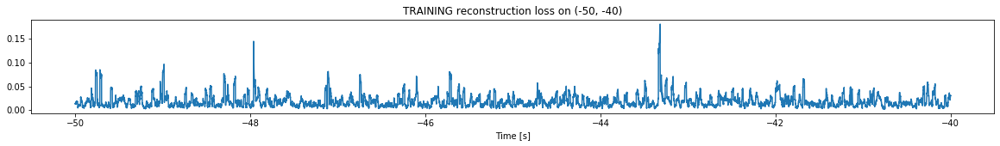

Finished training, median of the log(loss) is:  -1.8199585989338418
Triggering for section:  (-40, -30)
Using this median for triggering: -1.8915130666292936


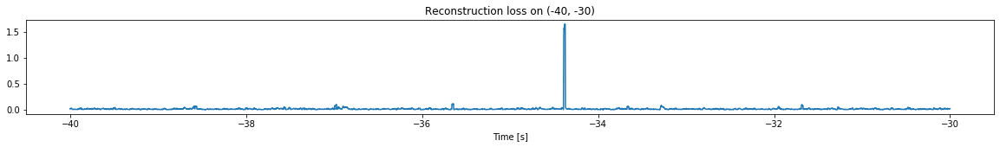

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


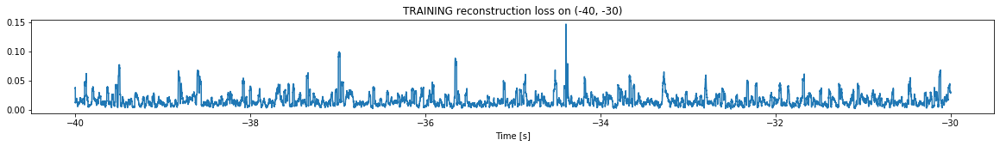

Finished training, median of the log(loss) is:  -1.8929399269358487
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8199585989338418


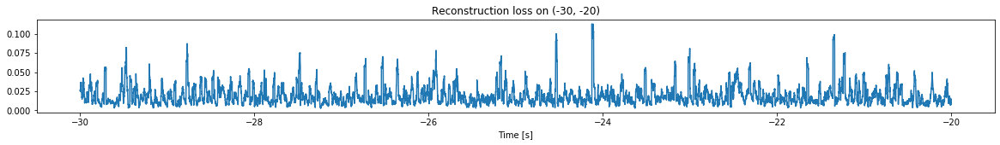

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


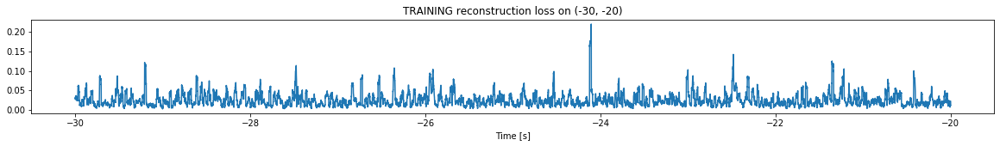

Finished training, median of the log(loss) is:  -1.6679501473919358
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8929399269358487


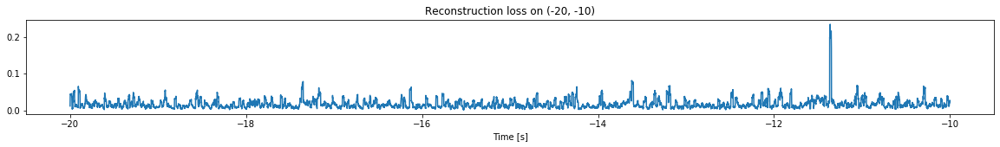

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


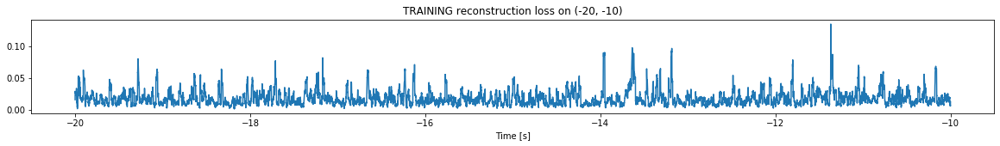

Finished training, median of the log(loss) is:  -1.803901817956604
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6679501473919358


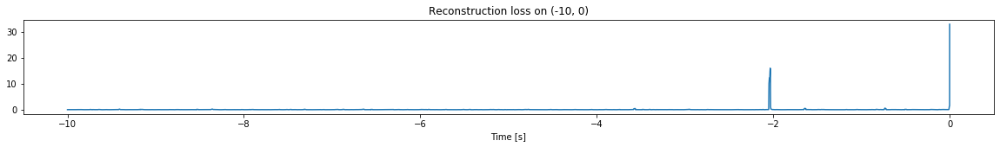

Other trigger time:  []
Their log loss values are:  []


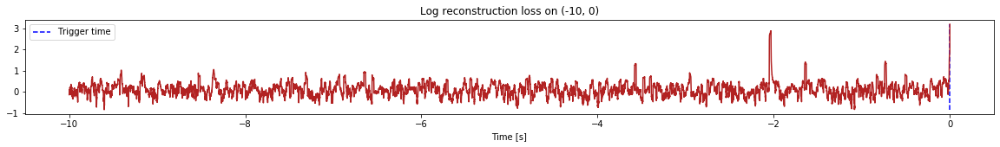

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [16]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


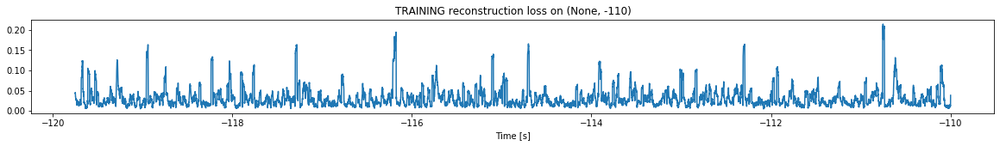

Finished training, median of the log(loss) is:  -1.5896639378361705
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


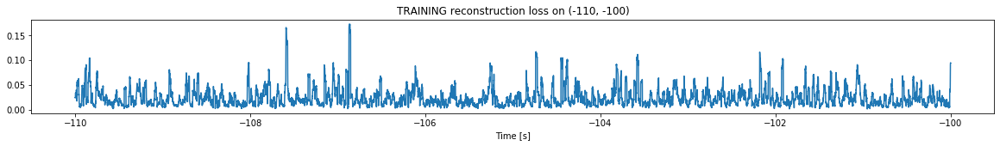

Finished training, median of the log(loss) is:  -1.700865644806899
Triggering for section:  (-100, -90)
Using this median for triggering: -1.5896639378361705


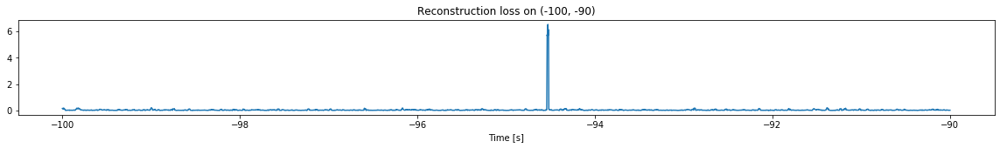

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


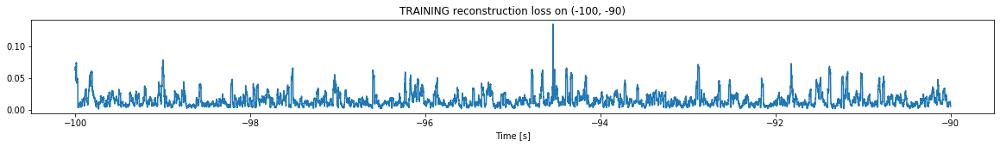

Finished training, median of the log(loss) is:  -1.9129649243417415
Triggering for section:  (-90, -80)
Using this median for triggering: -1.700865644806899


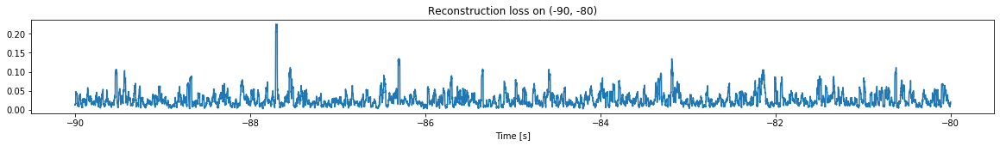

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


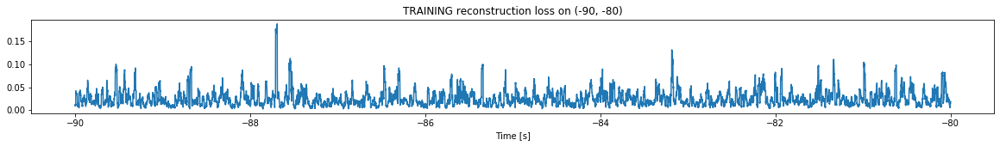

Finished training, median of the log(loss) is:  -1.671925125016109
Triggering for section:  (-80, -70)
Using this median for triggering: -1.9129649243417415


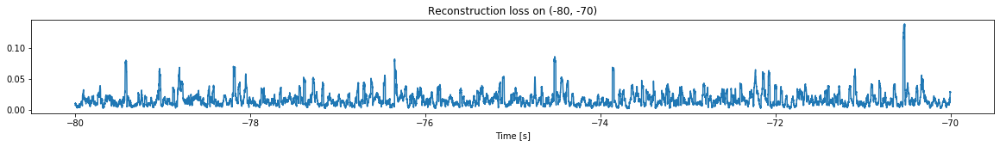

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


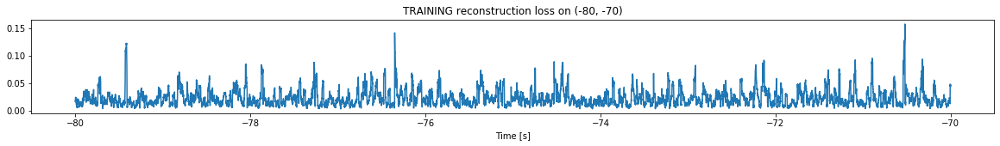

Finished training, median of the log(loss) is:  -1.7194772159505893
Triggering for section:  (-70, -60)
Using this median for triggering: -1.671925125016109


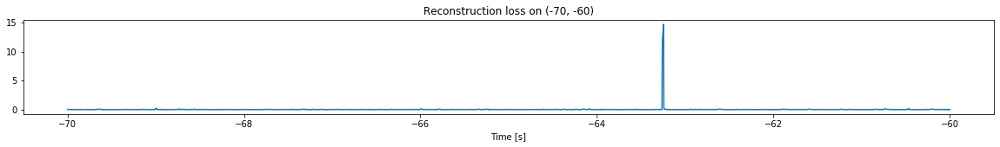

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


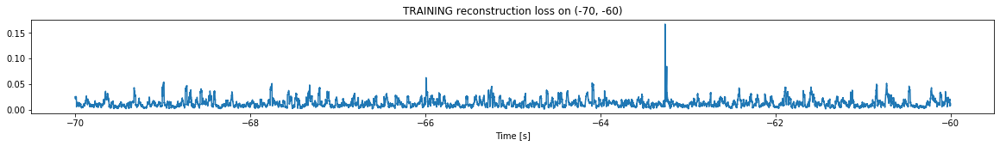

Finished training, median of the log(loss) is:  -1.9867331766503118
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7194772159505893


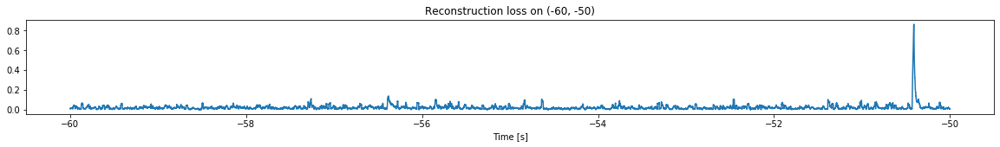

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


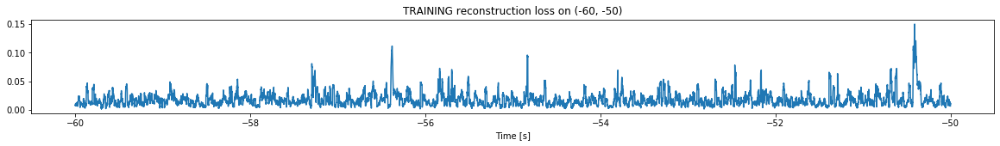

Finished training, median of the log(loss) is:  -1.801492938280191
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9867331766503118


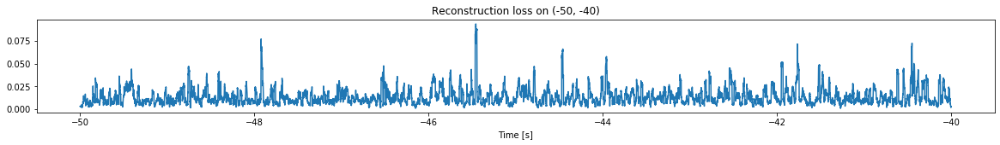

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


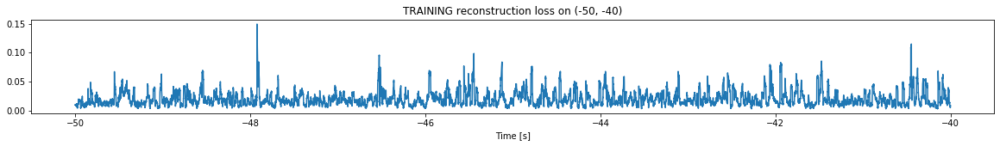

Finished training, median of the log(loss) is:  -1.7666341069929927
Triggering for section:  (-40, -30)
Using this median for triggering: -1.801492938280191


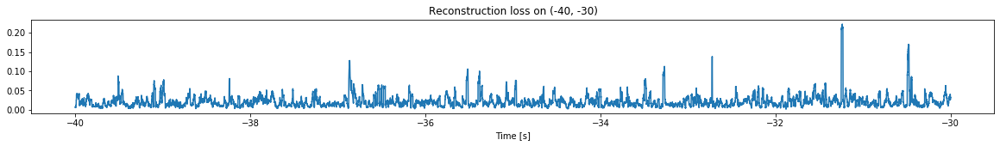

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


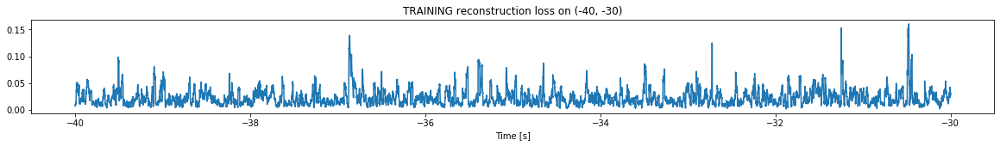

Finished training, median of the log(loss) is:  -1.7158690512878079
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7666341069929927


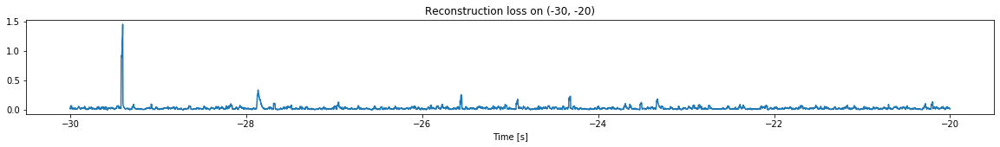

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


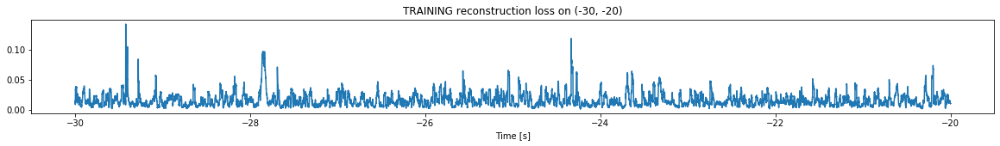

Finished training, median of the log(loss) is:  -1.858575008593786
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7158690512878079


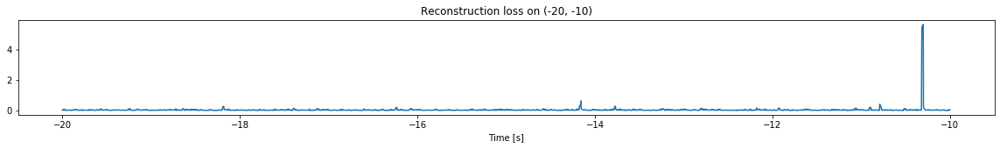

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


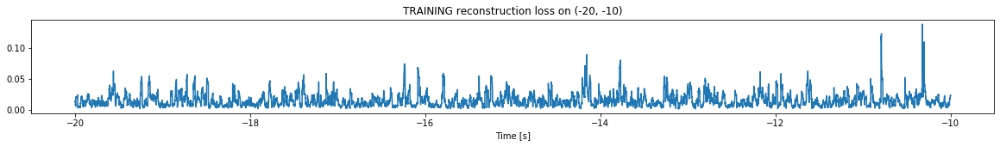

Finished training, median of the log(loss) is:  -1.882687739532964
Triggering for section:  (-10, 0)
Using this median for triggering: -1.858575008593786


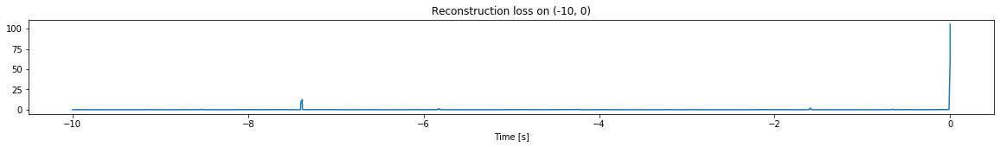

Other trigger time:  []
Their log loss values are:  []


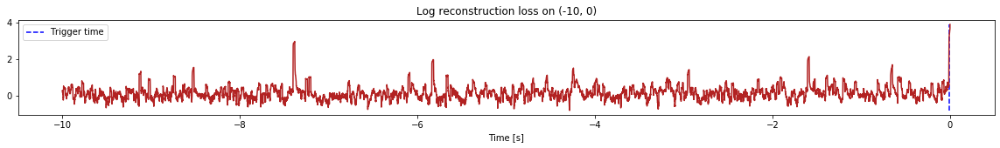

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [17]:
simulation("./data/Ramp30/", 10, (-120,0))

----------------

## Threshold 3.3

In [2]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings


def generate_data(dir_path, time_range, window = 2000, thres_win = 25000, step = 10):
    
    #Selection index due to using different window
    selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step)[selection_index:]
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)[selection_index:]
    #moving_thres_crossings = generate_crossings_data(dir_path, time_range, window = thres_win, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)[selection_index:]
    
    all_data = np.concatenate((moving_mean, moving_sd), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=12))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(12,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 3.3)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        
        
        ### Find trigger times
        peaks, _ = find_peaks(log_test_loss, height=3.3, distance = 5000)
        print("Other trigger time: ", time_test[peaks])
        print("Their log loss values are: ", log_test_loss[peaks])
        
        for i in range(len(peaks)):
            plt.vlines(time_test[peaks[i]], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed")
            
        plt.show()
        
        return list(time_test[peaks])
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time is not None:
                print("Triggered at: ", trigger_time)
                trigger_log.extend(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


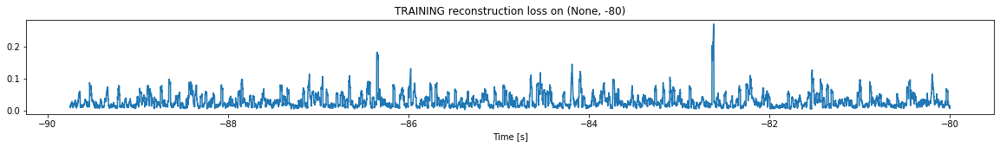

Finished training, median of the log(loss) is:  -1.6488380055128329
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


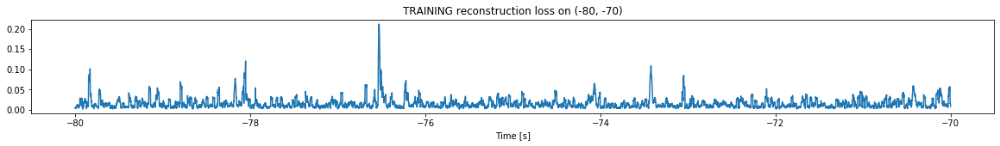

Finished training, median of the log(loss) is:  -1.9025458410072411
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6488380055128329


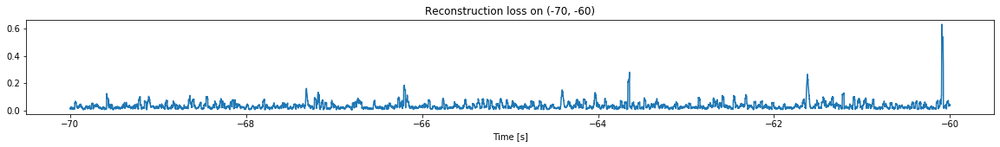

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


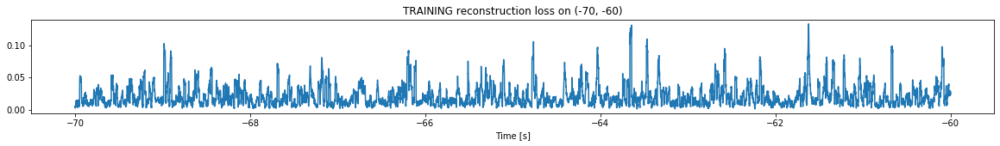

Finished training, median of the log(loss) is:  -1.772723875053917
Triggering for section:  (-60, -50)
Using this median for triggering: -1.9025458410072411


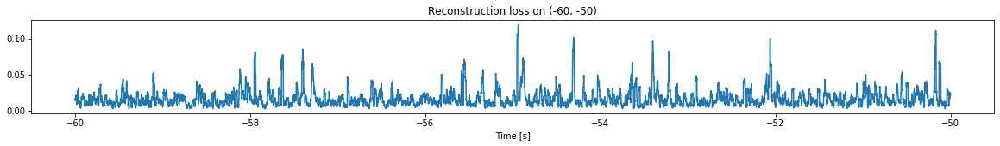

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


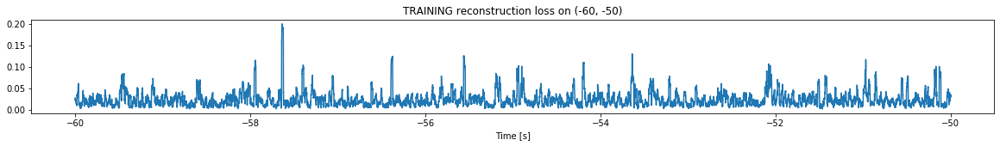

Finished training, median of the log(loss) is:  -1.7135446715550549
Triggering for section:  (-50, -40)
Using this median for triggering: -1.772723875053917


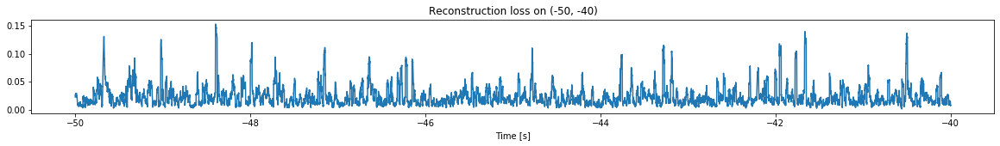

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


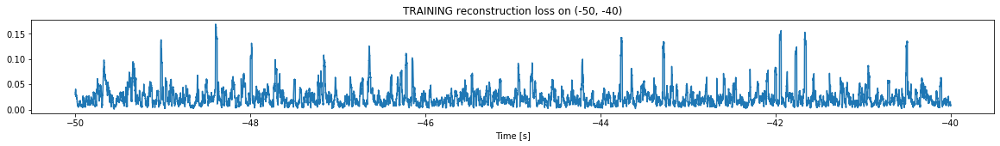

Finished training, median of the log(loss) is:  -1.6994062079555379
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7135446715550549


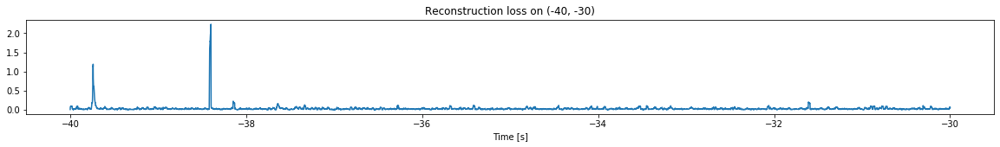

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


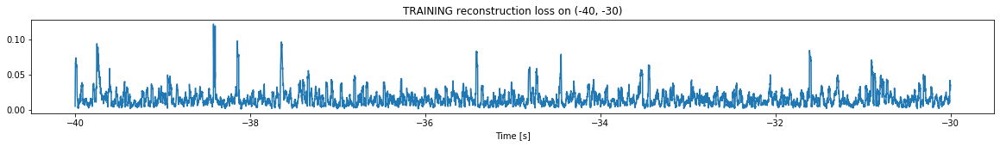

Finished training, median of the log(loss) is:  -1.8780372160255139
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6994062079555379


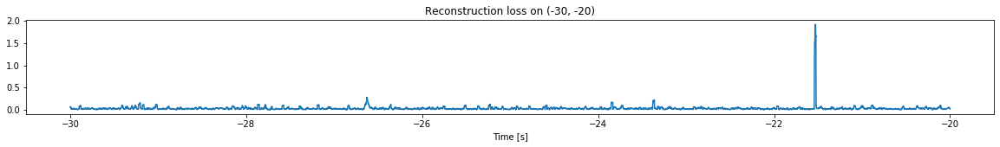

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


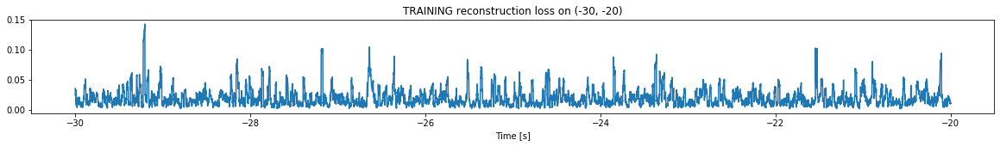

Finished training, median of the log(loss) is:  -1.7868137940514848
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8780372160255139


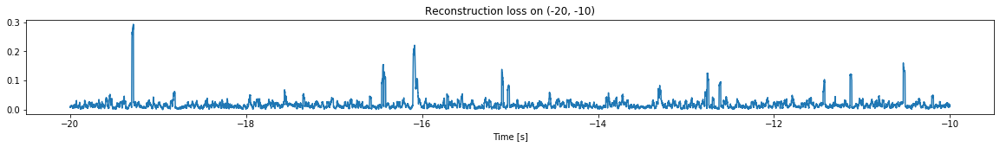

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


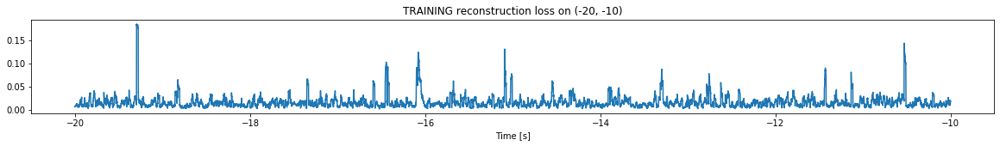

Finished training, median of the log(loss) is:  -1.8803366602983724
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7868137940514848


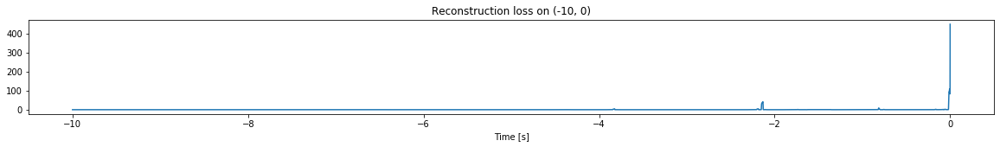

Other trigger time:  [-2.1325998 -0.006    ]
Their log loss values are:  [3.40633381 3.82419546]


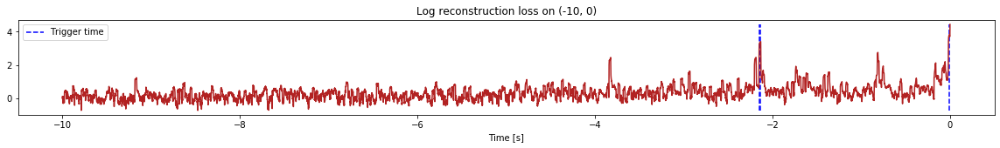

Triggered at:  [-2.1325998, -0.006]
<--------
Finished simulation, all the triggered times are:  [-2.1325998, -0.006]


In [3]:
simulation("./data/Ramp4/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


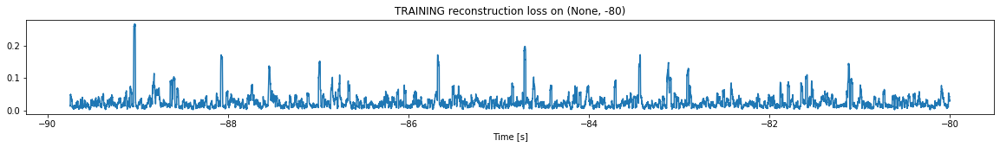

Finished training, median of the log(loss) is:  -1.6865597612014205
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


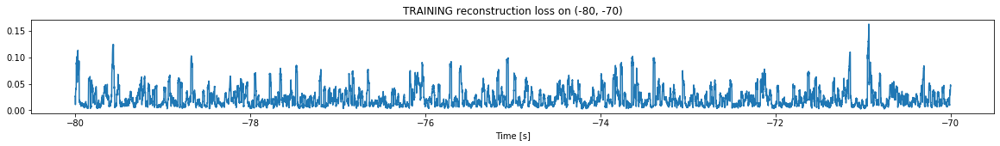

Finished training, median of the log(loss) is:  -1.7491331710398197
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6865597612014205


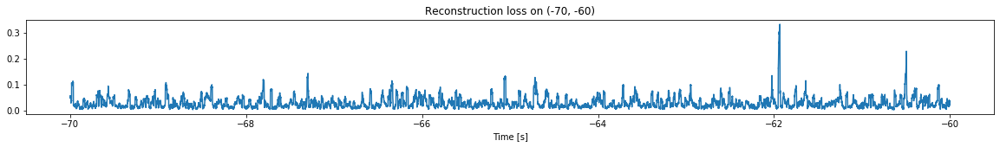

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


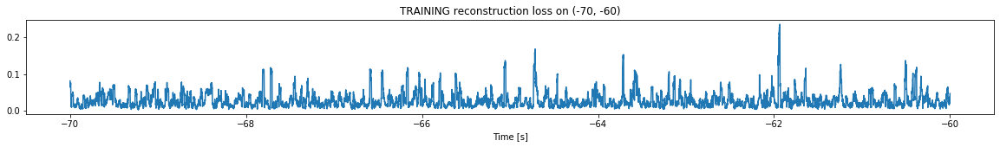

Finished training, median of the log(loss) is:  -1.6474550626268145
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7491331710398197


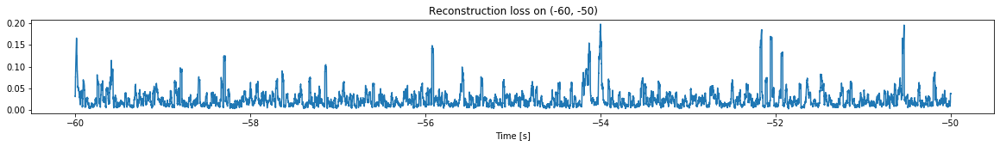

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


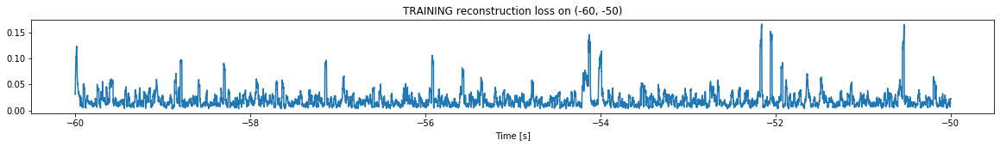

Finished training, median of the log(loss) is:  -1.795264237364242
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6474550626268145


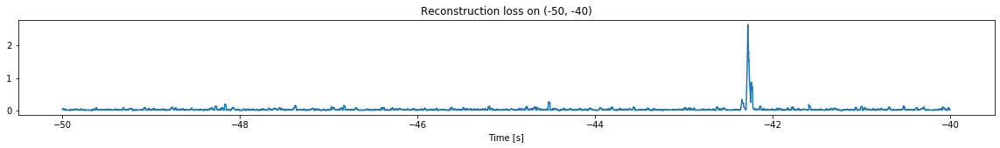

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


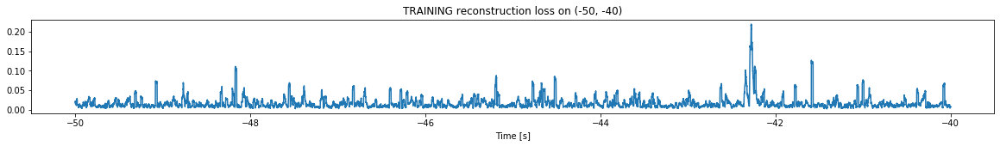

Finished training, median of the log(loss) is:  -1.8975972361505038
Triggering for section:  (-40, -30)
Using this median for triggering: -1.795264237364242


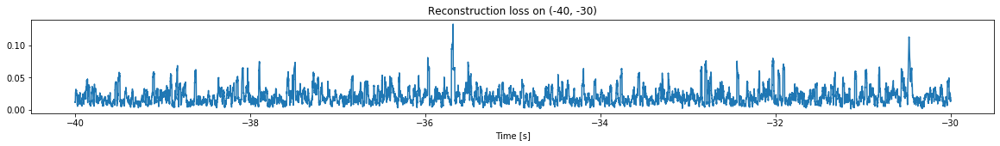

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


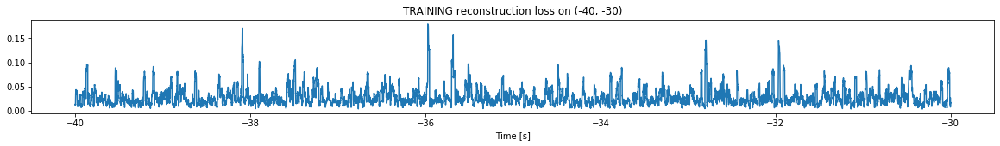

Finished training, median of the log(loss) is:  -1.625185307605165
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8975972361505038


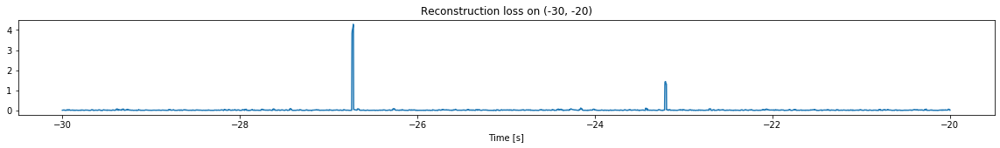

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


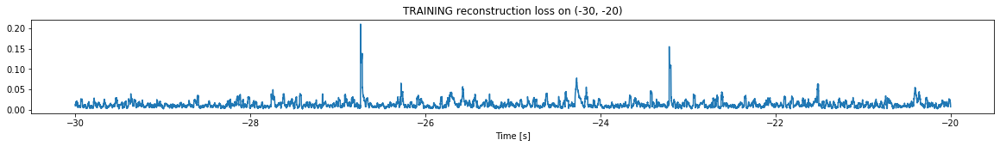

Finished training, median of the log(loss) is:  -1.956855109699129
Triggering for section:  (-20, -10)
Using this median for triggering: -1.625185307605165


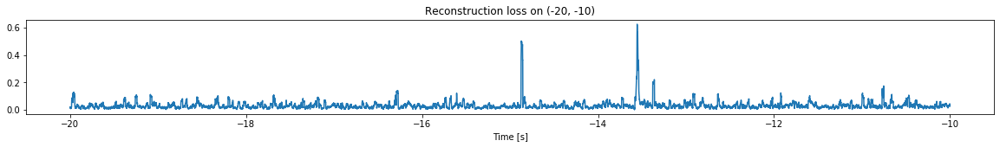

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


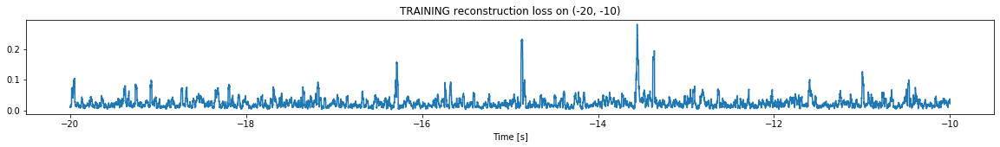

Finished training, median of the log(loss) is:  -1.6956802389924133
Triggering for section:  (-10, 0)
Using this median for triggering: -1.956855109699129


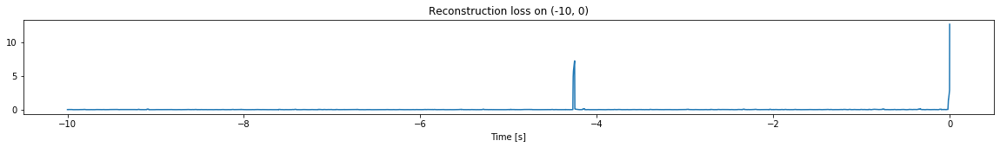

<--------
Finished simulation, all the triggered times are:  []


In [4]:
simulation("./data/Ramp5/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


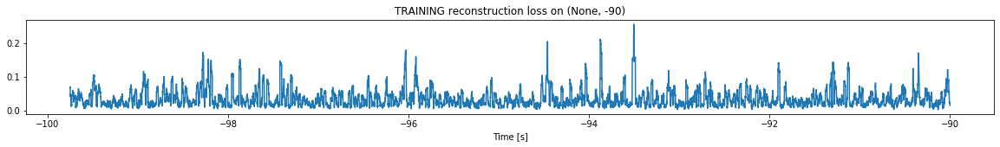

Finished training, median of the log(loss) is:  -1.5387421638610275
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


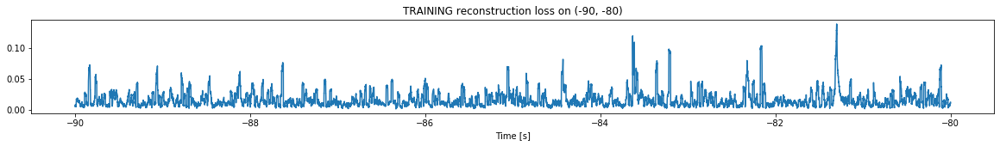

Finished training, median of the log(loss) is:  -1.8758860998771785
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5387421638610275


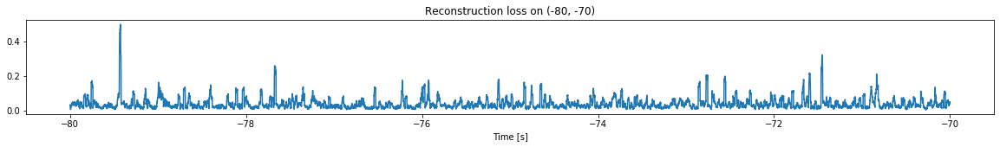

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


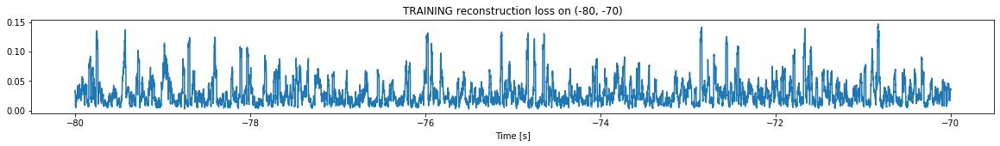

Finished training, median of the log(loss) is:  -1.6314683310946818
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8758860998771785


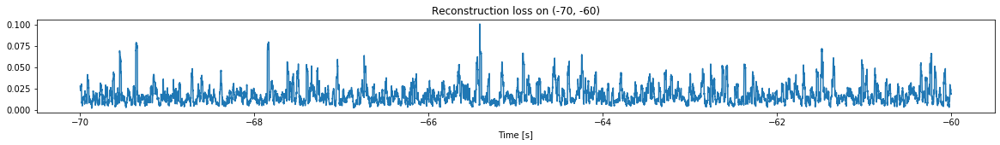

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


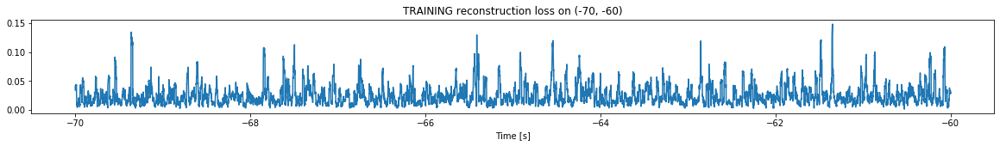

Finished training, median of the log(loss) is:  -1.6768566877649838
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6314683310946818


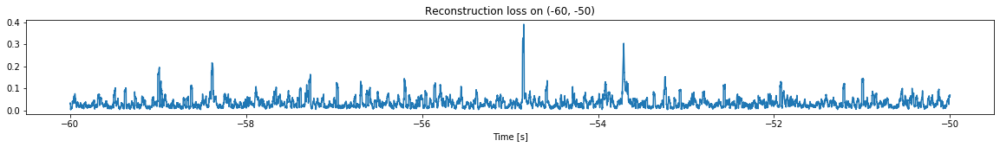

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


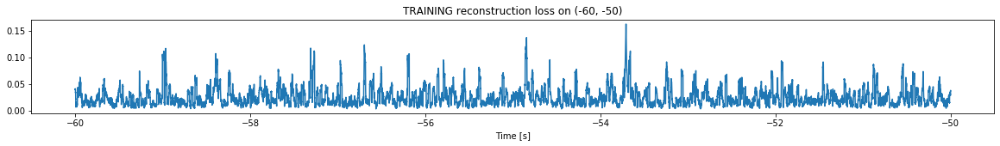

Finished training, median of the log(loss) is:  -1.6874025081322837
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6768566877649838


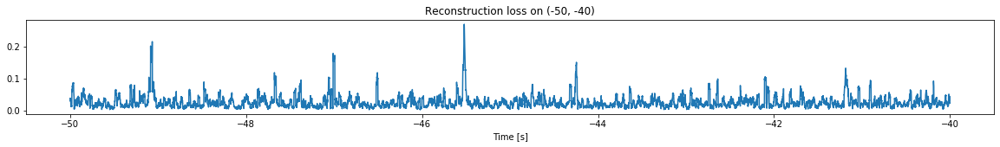

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


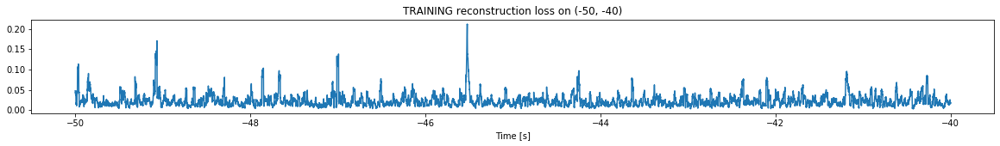

Finished training, median of the log(loss) is:  -1.7042748114220787
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6874025081322837


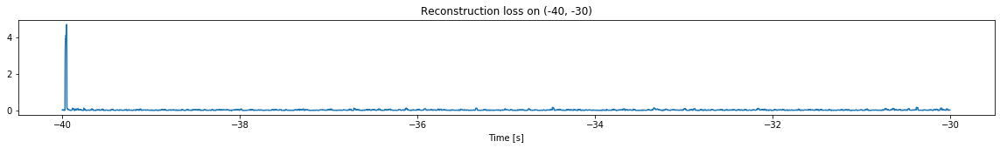

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


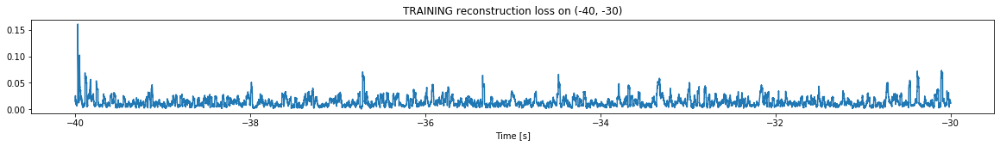

Finished training, median of the log(loss) is:  -1.9372175557101263
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7042748114220787


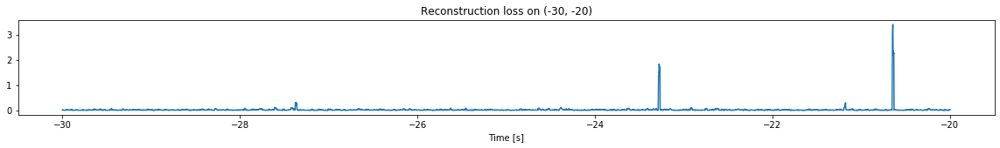

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


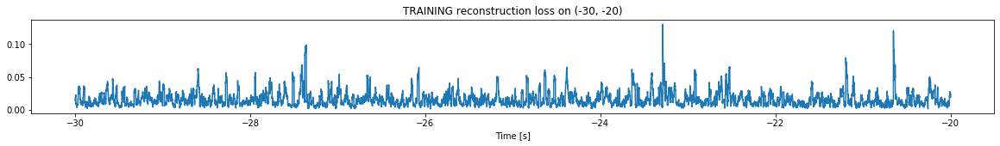

Finished training, median of the log(loss) is:  -1.8543699538221068
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9372175557101263


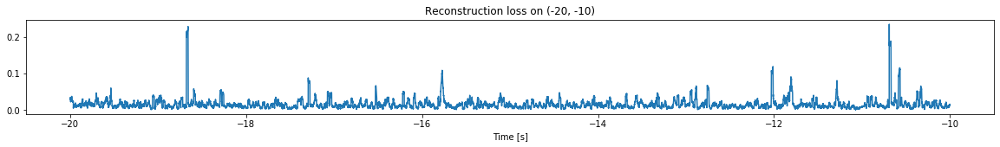

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


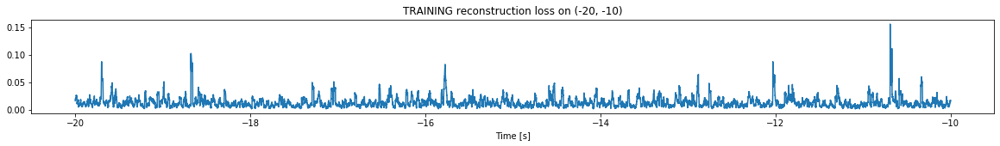

Finished training, median of the log(loss) is:  -1.9558704653787995
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8543699538221068


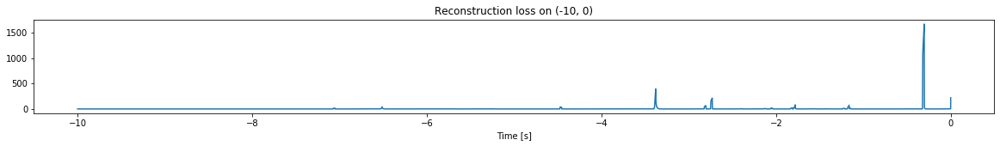

Other trigger time:  [-6.5119996 -4.4707    -3.3790998 -2.731     -1.7816    -1.1640999
 -0.3037   ]
Their log loss values are:  [3.44696488 3.44837503 4.44932121 4.18216747 3.76889225 3.72325978
 5.07733007]


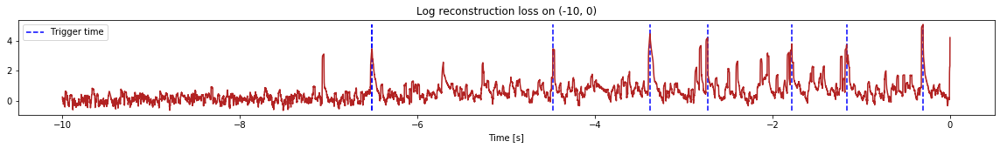

Triggered at:  [-6.5119996, -4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.3037]
<--------
Finished simulation, all the triggered times are:  [-6.5119996, -4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.3037]


In [5]:
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 30
Entering sections:  (-300, -290)
-------->
Entering sections:  (-290, -280)
-------->
Training for section:  (None, -290)


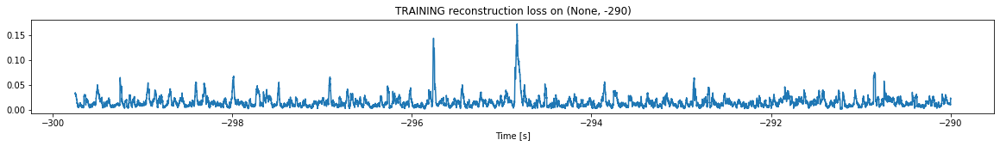

Finished training, median of the log(loss) is:  -1.8847200276343792
<--------
Entering sections:  (-280, -270)
-------->
Training for section:  (-290, -280)


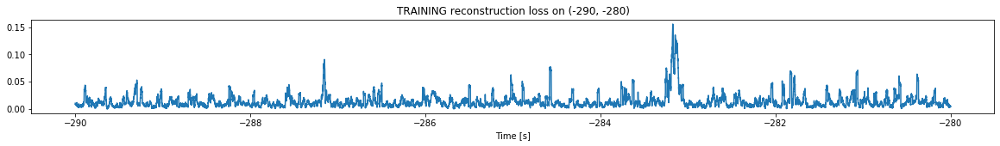

Finished training, median of the log(loss) is:  -1.9608249861926468
Triggering for section:  (-280, -270)
Using this median for triggering: -1.8847200276343792


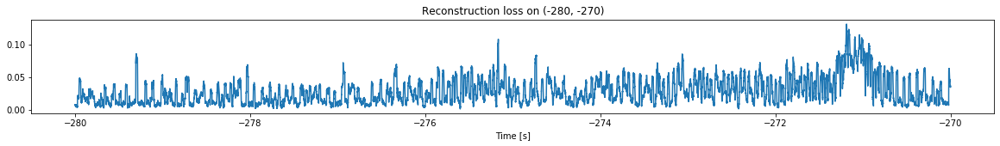

<--------
Entering sections:  (-270, -260)
-------->
Training for section:  (-280, -270)


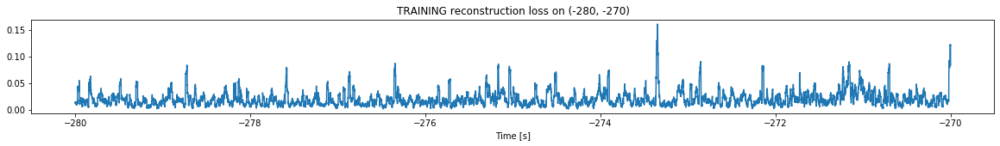

Finished training, median of the log(loss) is:  -1.776941618548114
Triggering for section:  (-270, -260)
Using this median for triggering: -1.9608249861926468


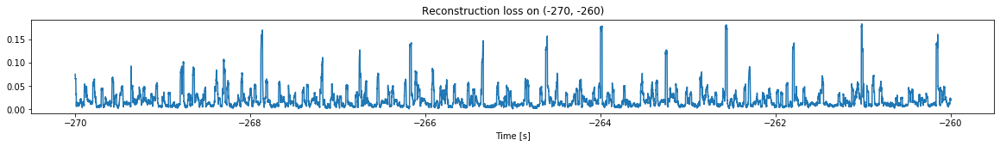

<--------
Entering sections:  (-260, -250)
-------->
Training for section:  (-270, -260)


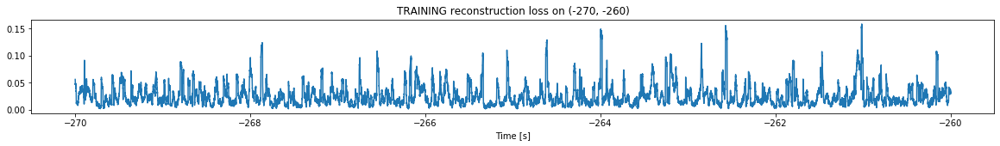

Finished training, median of the log(loss) is:  -1.6794996130111133
Triggering for section:  (-260, -250)
Using this median for triggering: -1.776941618548114


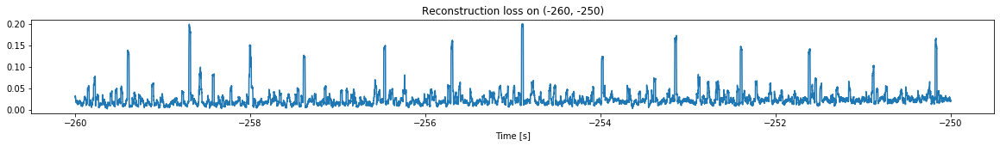

<--------
Entering sections:  (-250, -240)
-------->
Training for section:  (-260, -250)


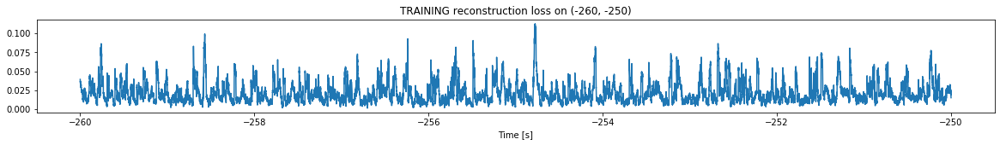

Finished training, median of the log(loss) is:  -1.7420560664973817
Triggering for section:  (-250, -240)
Using this median for triggering: -1.6794996130111133


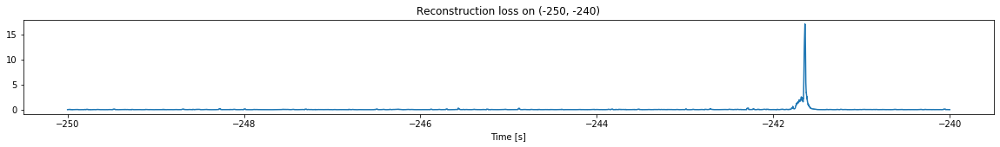

<--------
Entering sections:  (-240, -230)
-------->
Training for section:  (-250, -240)


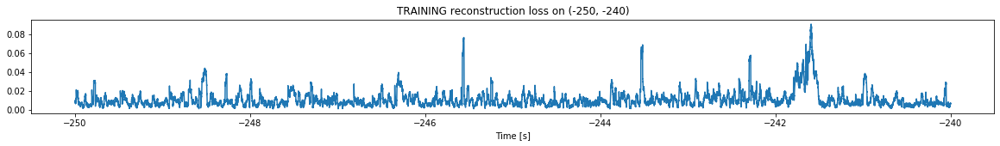

Finished training, median of the log(loss) is:  -2.0544704042794715
Triggering for section:  (-240, -230)
Using this median for triggering: -1.7420560664973817


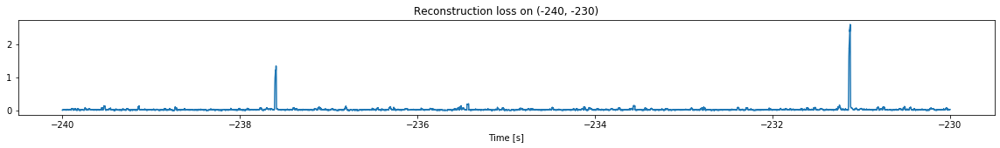

<--------
Entering sections:  (-230, -220)
-------->
Training for section:  (-240, -230)


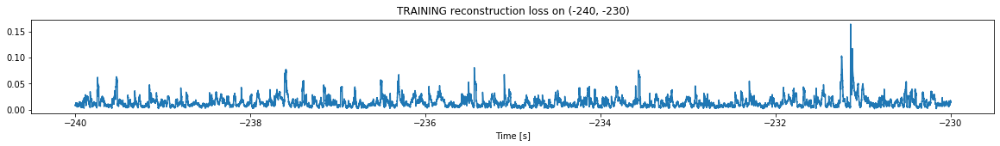

Finished training, median of the log(loss) is:  -1.941975260113647
Triggering for section:  (-230, -220)
Using this median for triggering: -2.0544704042794715


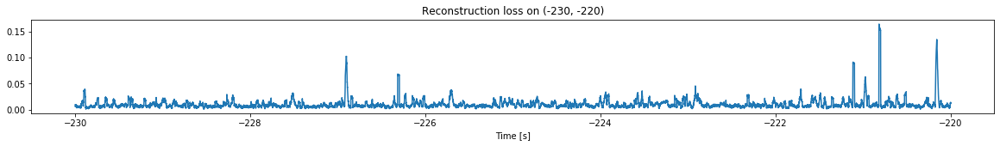

<--------
Entering sections:  (-220, -210)
-------->
Training for section:  (-230, -220)


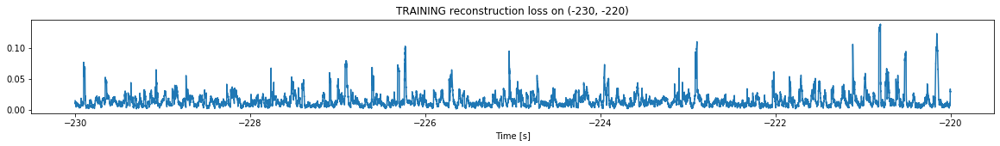

Finished training, median of the log(loss) is:  -1.9235780339604631
Triggering for section:  (-220, -210)
Using this median for triggering: -1.941975260113647


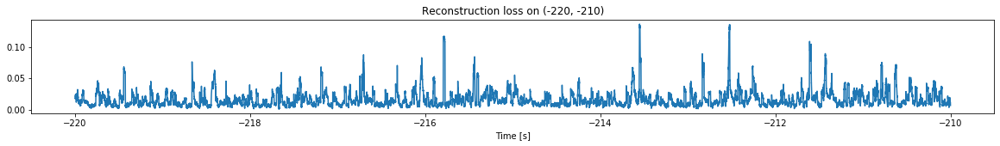

<--------
Entering sections:  (-210, -200)
-------->
Training for section:  (-220, -210)


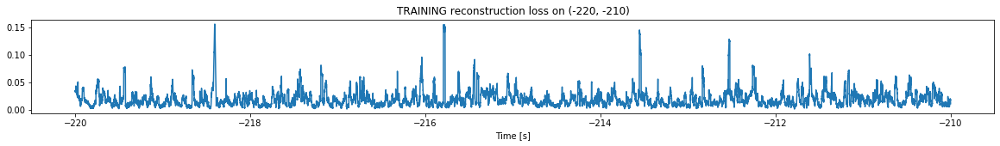

Finished training, median of the log(loss) is:  -1.7839896307034482
Triggering for section:  (-210, -200)
Using this median for triggering: -1.9235780339604631


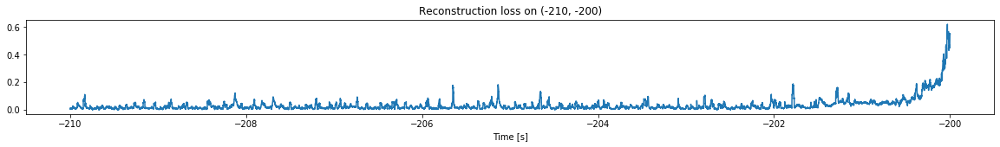

<--------
Entering sections:  (-200, -190)
-------->
Training for section:  (-210, -200)


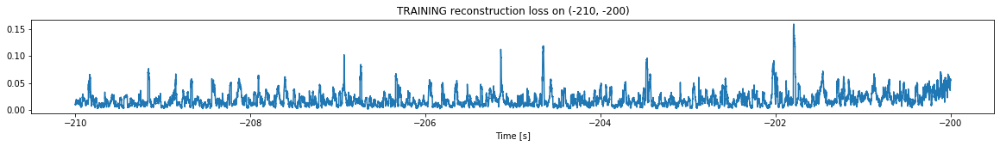

Finished training, median of the log(loss) is:  -1.8091034365565104
Triggering for section:  (-200, -190)
Using this median for triggering: -1.7839896307034482


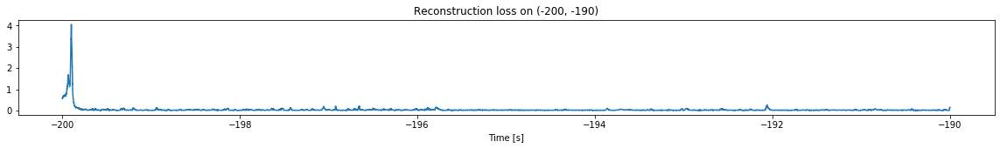

<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


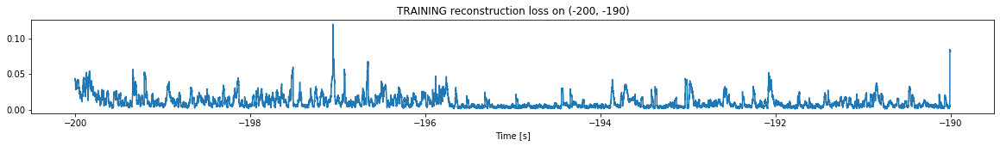

Finished training, median of the log(loss) is:  -2.121930972918618
Triggering for section:  (-190, -180)
Using this median for triggering: -1.8091034365565104


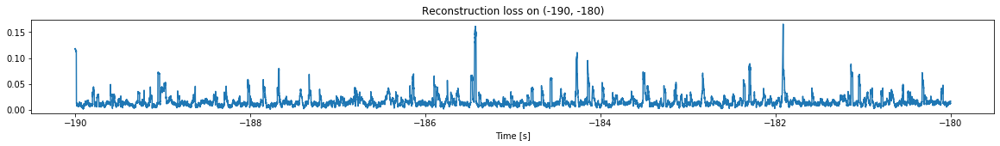

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


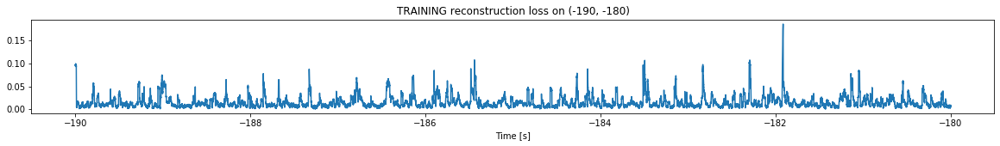

Finished training, median of the log(loss) is:  -1.9445716232464187
Triggering for section:  (-180, -170)
Using this median for triggering: -2.121930972918618


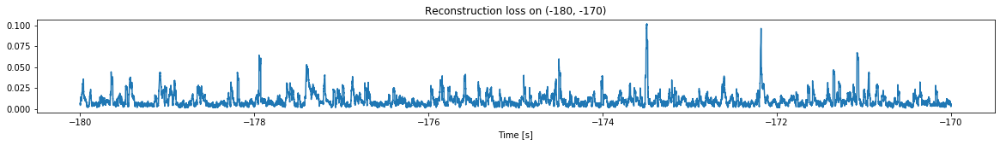

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


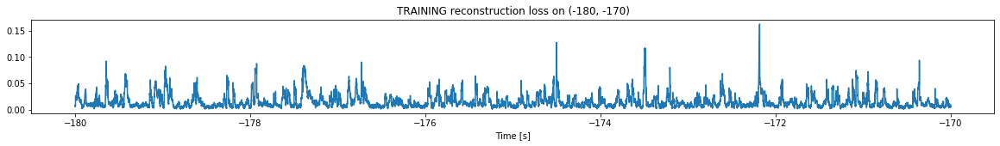

Finished training, median of the log(loss) is:  -1.9230564009539695
Triggering for section:  (-170, -160)
Using this median for triggering: -1.9445716232464187


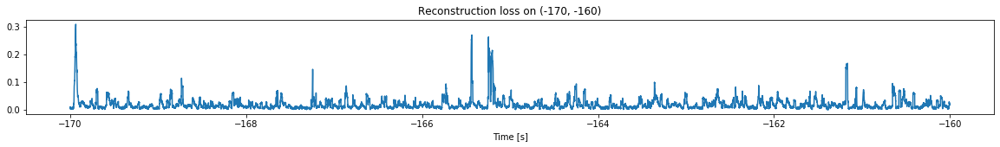

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


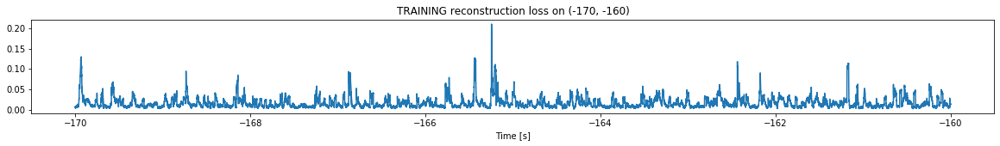

Finished training, median of the log(loss) is:  -1.9128545960552659
Triggering for section:  (-160, -150)
Using this median for triggering: -1.9230564009539695


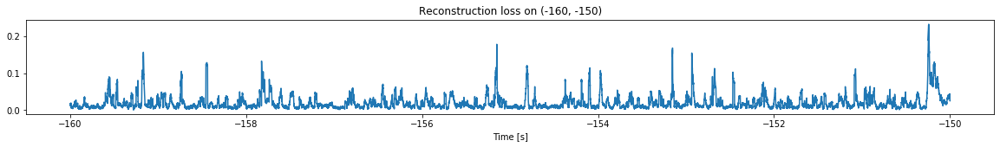

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


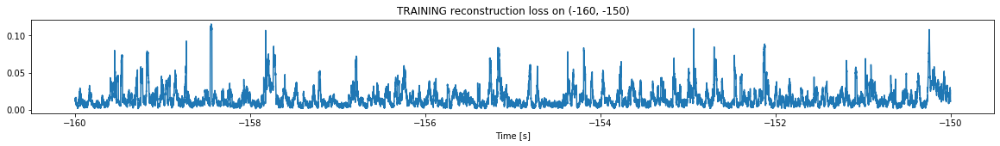

Finished training, median of the log(loss) is:  -1.930642840669373
Triggering for section:  (-150, -140)
Using this median for triggering: -1.9128545960552659


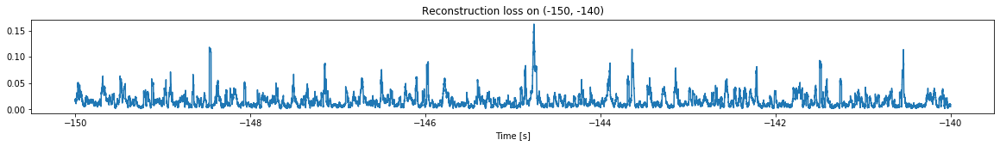

<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


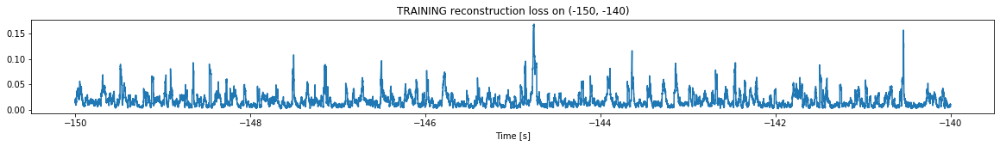

Finished training, median of the log(loss) is:  -1.850681617707545
Triggering for section:  (-140, -130)
Using this median for triggering: -1.930642840669373


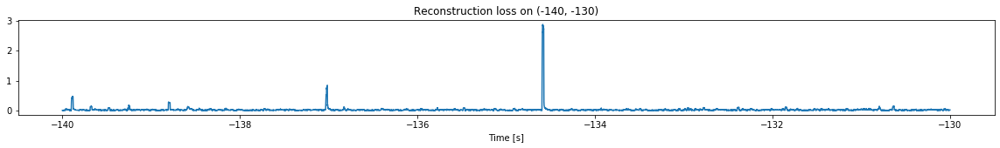

<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


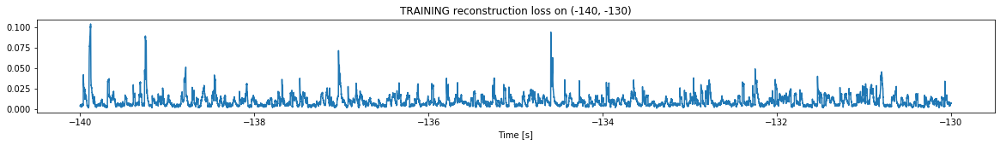

Finished training, median of the log(loss) is:  -2.1357049743125156
Triggering for section:  (-130, -120)
Using this median for triggering: -1.850681617707545


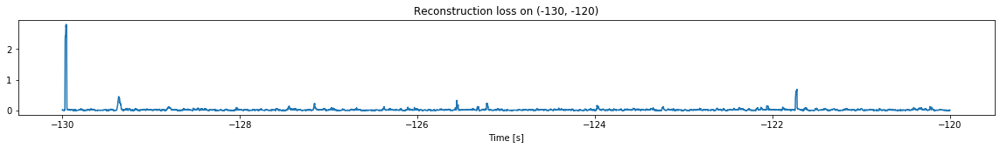

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


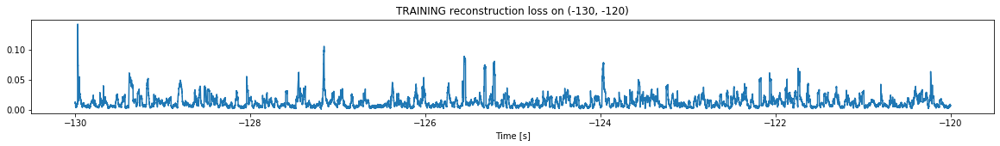

Finished training, median of the log(loss) is:  -2.014237708051359
Triggering for section:  (-120, -110)
Using this median for triggering: -2.1357049743125156


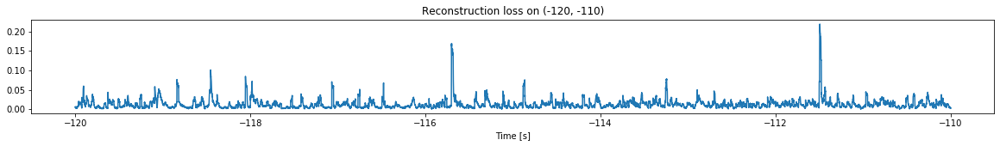

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


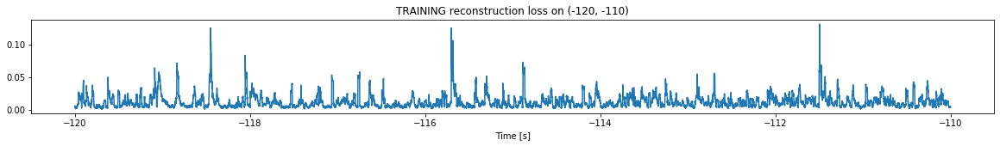

Finished training, median of the log(loss) is:  -2.016724186779531
Triggering for section:  (-110, -100)
Using this median for triggering: -2.014237708051359


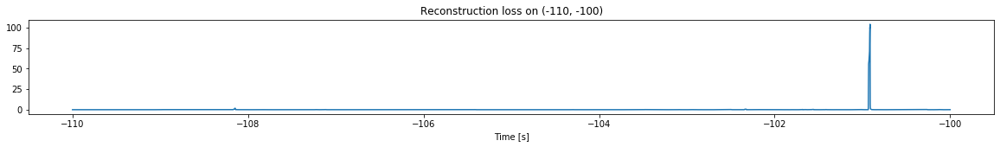

Other trigger time:  [-100.91249]
Their log loss values are:  [4.0323529]


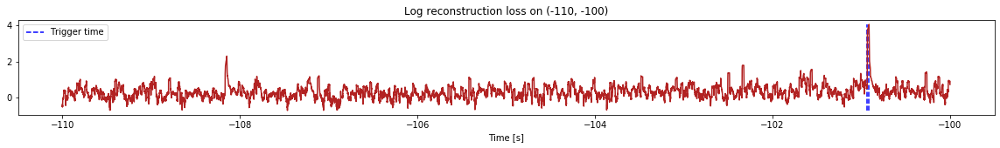

Triggered at:  [-100.91249]
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


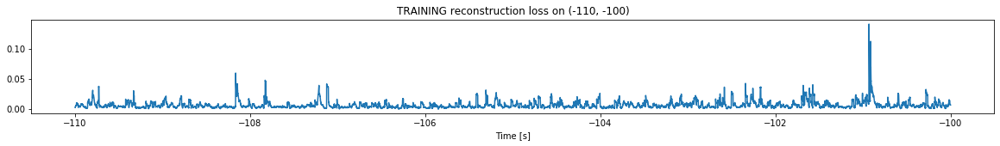

Finished training, median of the log(loss) is:  -2.2746034976072407
Triggering for section:  (-100, -90)
Using this median for triggering: -2.016724186779531


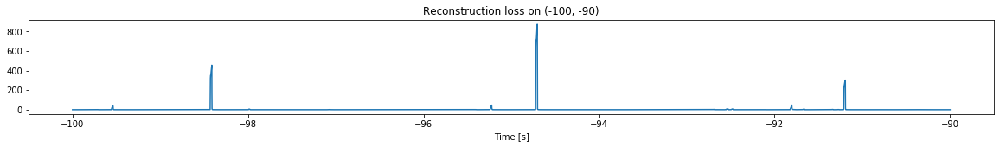

Other trigger time:  [-99.53959  -98.41249  -95.22369  -94.704185 -91.80379  -91.193886]
Their log loss values are:  [3.63456363 4.67531103 3.68665141 4.95859524 3.72540605 4.49857452]


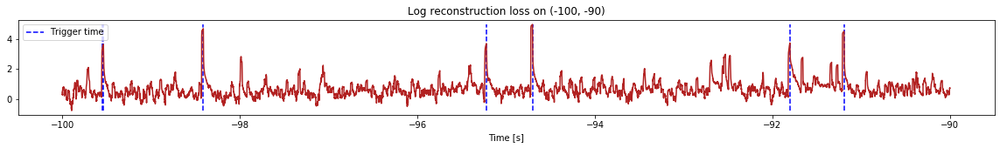

Triggered at:  [-99.53959, -98.41249, -95.22369, -94.704185, -91.80379, -91.193886]
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


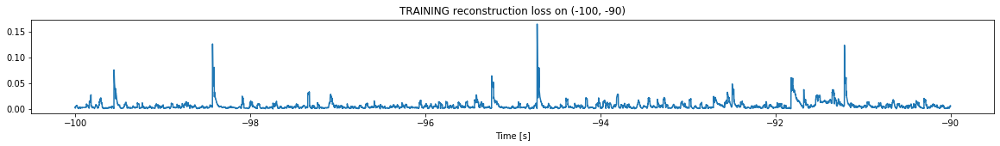

Finished training, median of the log(loss) is:  -2.3260929455296475
Triggering for section:  (-90, -80)
Using this median for triggering: -2.2746034976072407


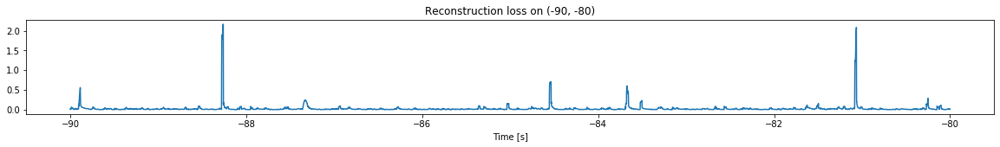

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


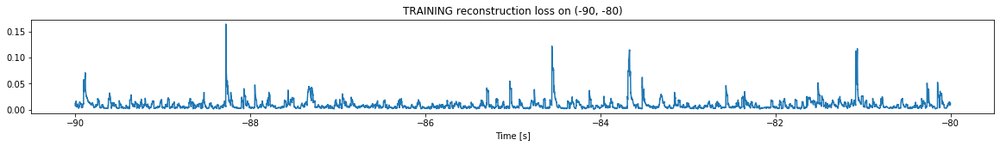

Finished training, median of the log(loss) is:  -2.2081183989213096
Triggering for section:  (-80, -70)
Using this median for triggering: -2.3260929455296475


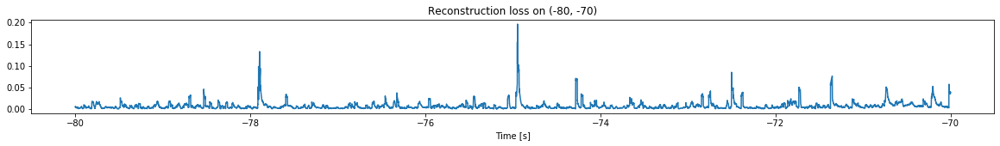

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


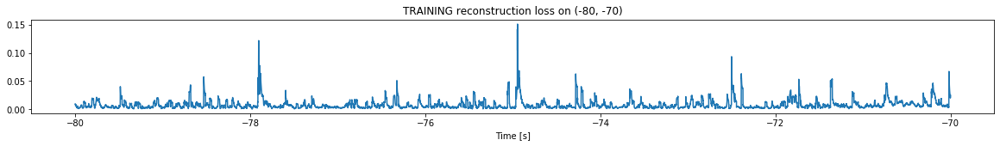

Finished training, median of the log(loss) is:  -2.239570114673094
Triggering for section:  (-70, -60)
Using this median for triggering: -2.2081183989213096


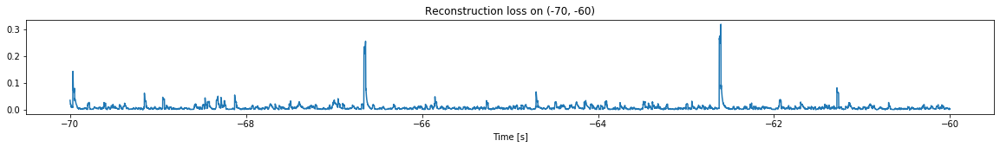

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


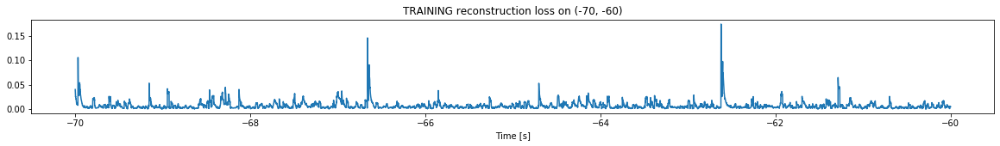

Finished training, median of the log(loss) is:  -2.2671321142586924
Triggering for section:  (-60, -50)
Using this median for triggering: -2.239570114673094


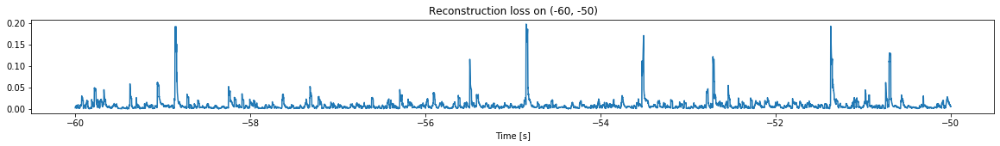

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


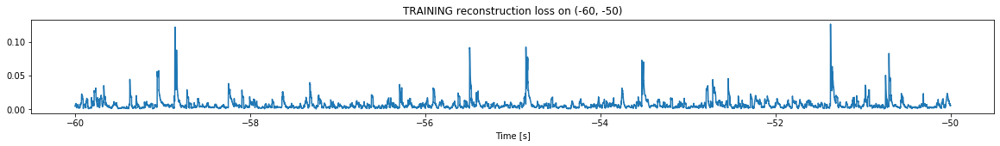

Finished training, median of the log(loss) is:  -2.2862225495056085
Triggering for section:  (-50, -40)
Using this median for triggering: -2.2671321142586924


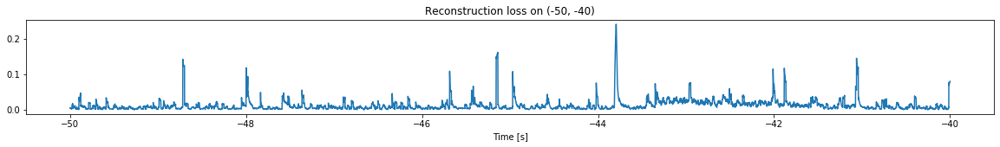

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


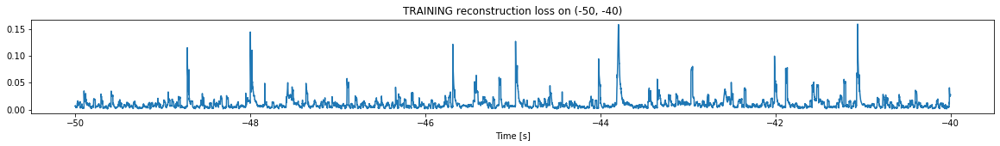

Finished training, median of the log(loss) is:  -2.102709262227074
Triggering for section:  (-40, -30)
Using this median for triggering: -2.2862225495056085


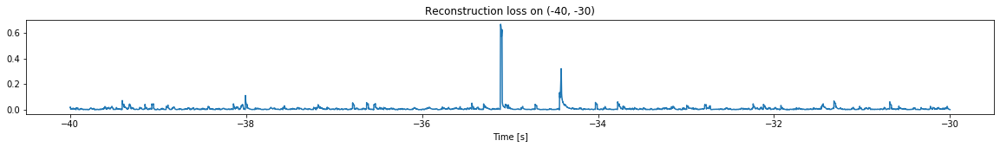

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


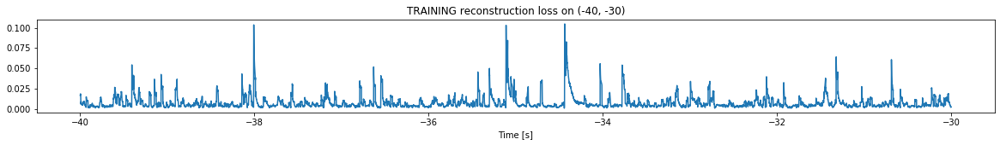

Finished training, median of the log(loss) is:  -2.3186821449214112
Triggering for section:  (-30, -20)
Using this median for triggering: -2.102709262227074


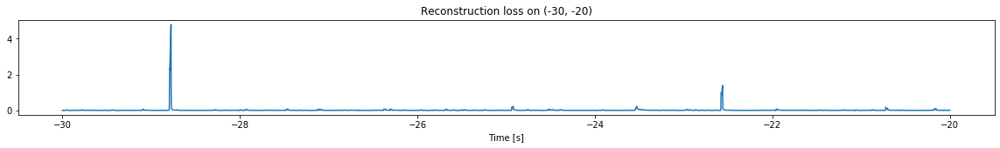

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


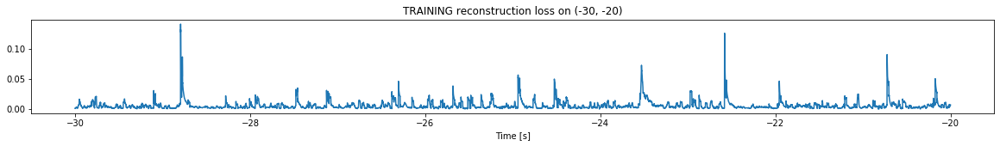

Finished training, median of the log(loss) is:  -2.38891254577629
Triggering for section:  (-20, -10)
Using this median for triggering: -2.3186821449214112


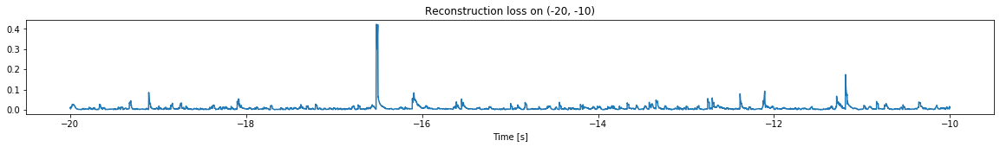

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


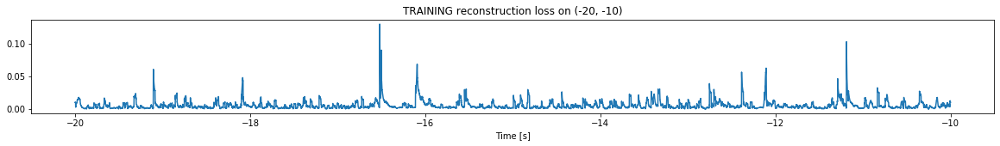

Finished training, median of the log(loss) is:  -2.365224013784677
Triggering for section:  (-10, 0)
Using this median for triggering: -2.38891254577629


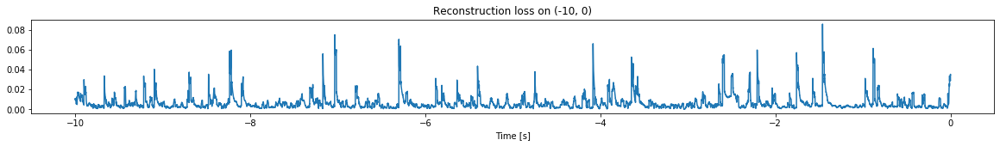

<--------
Finished simulation, all the triggered times are:  [-100.91249, -99.53959, -98.41249, -95.22369, -94.704185, -91.80379, -91.193886]


In [6]:
simulation("./data/Ramp19/", 10, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2117500, 12)
Flushing input history
Number of sections: 21
Entering sections:  (-210, -200)
-------->
Entering sections:  (-200, -190)
-------->
Training for section:  (None, -200)


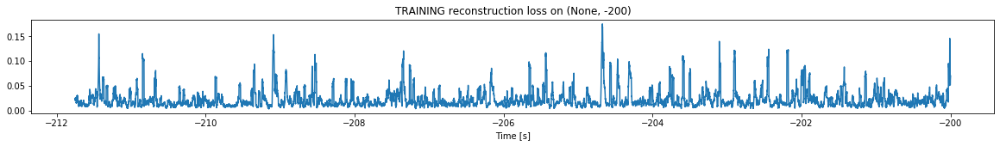

Finished training, median of the log(loss) is:  -1.771063074560604
<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


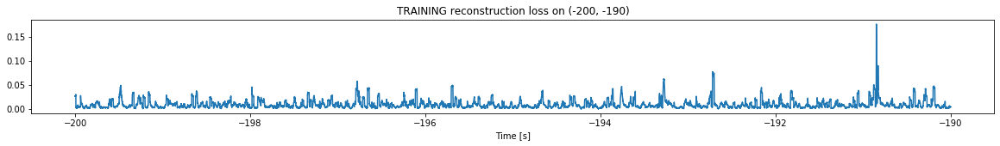

Finished training, median of the log(loss) is:  -2.1233735848320734
Triggering for section:  (-190, -180)
Using this median for triggering: -1.771063074560604


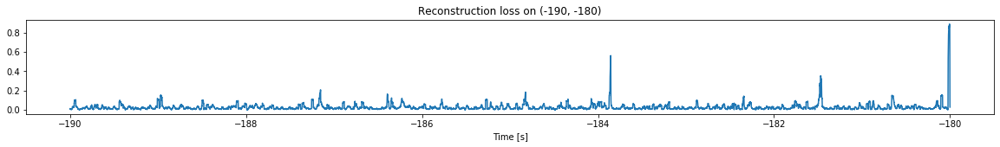

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


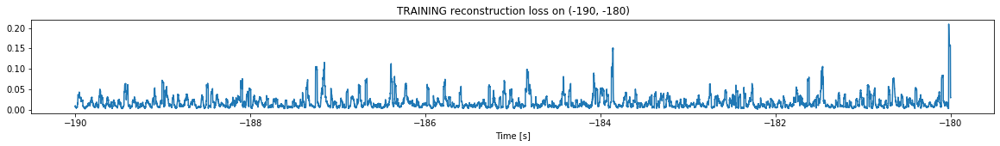

Finished training, median of the log(loss) is:  -1.8934789196565363
Triggering for section:  (-180, -170)
Using this median for triggering: -2.1233735848320734


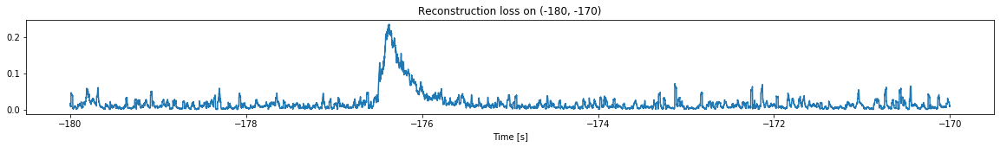

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


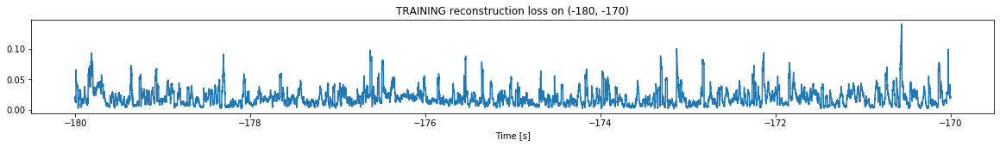

Finished training, median of the log(loss) is:  -1.7697858236420865
Triggering for section:  (-170, -160)
Using this median for triggering: -1.8934789196565363


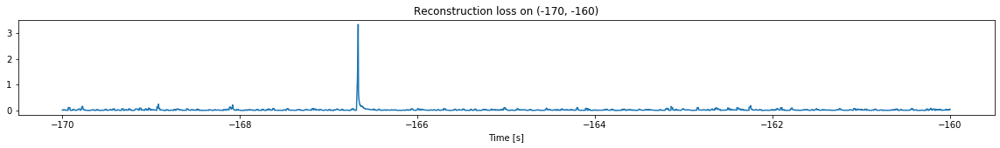

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


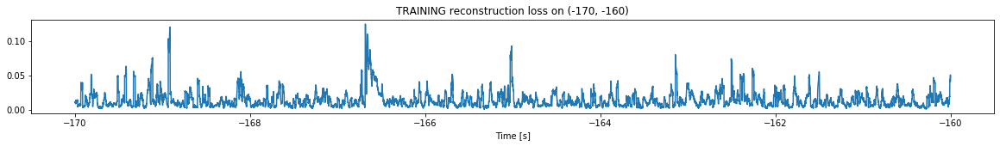

Finished training, median of the log(loss) is:  -1.9583779049564152
Triggering for section:  (-160, -150)
Using this median for triggering: -1.7697858236420865


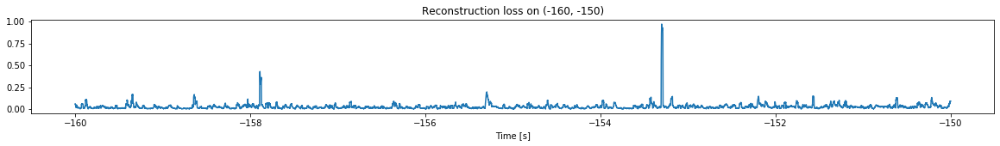

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


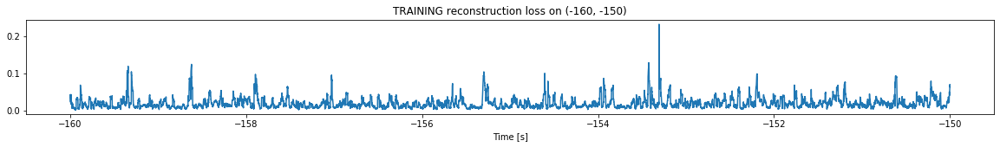

Finished training, median of the log(loss) is:  -1.8101993347535503
Triggering for section:  (-150, -140)
Using this median for triggering: -1.9583779049564152


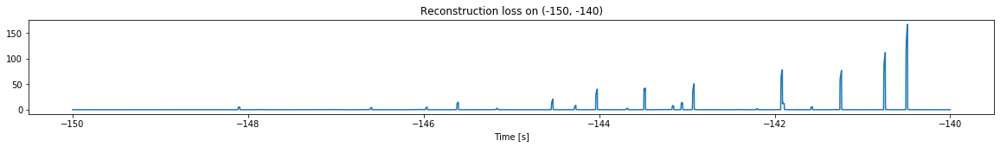

Other trigger time:  [-144.02179 -143.47359 -142.9188  -141.91309 -141.23909 -140.48679]
Their log loss values are:  [3.56329337 3.58566626 3.66545292 3.85212778 3.84425777 4.18287638]


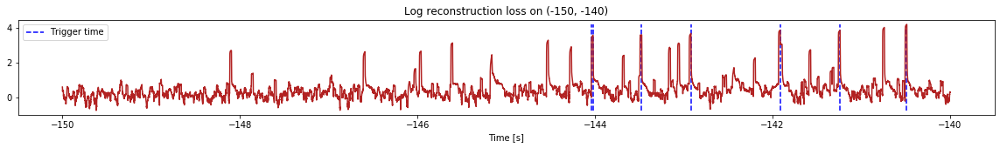

Triggered at:  [-144.02179, -143.47359, -142.9188, -141.91309, -141.23909, -140.48679]
<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


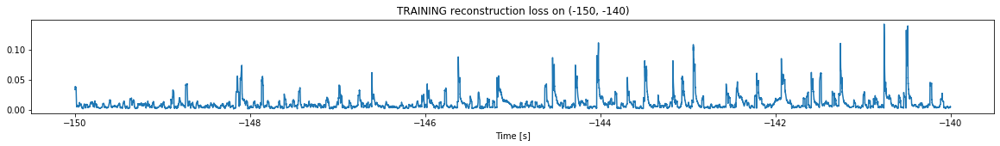

Finished training, median of the log(loss) is:  -2.1573075883960855
Triggering for section:  (-140, -130)
Using this median for triggering: -1.8101993347535503


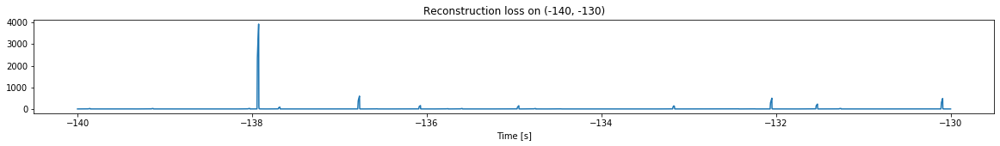

Other trigger time:  [-137.92479 -136.77028 -136.0718  -134.94579 -133.17009 -132.0474
 -131.52489 -130.09099]
Their log loss values are:  [5.40413709 4.58521378 4.00744103 3.98323749 3.96868595 4.50729027
 4.16456756 4.49650146]


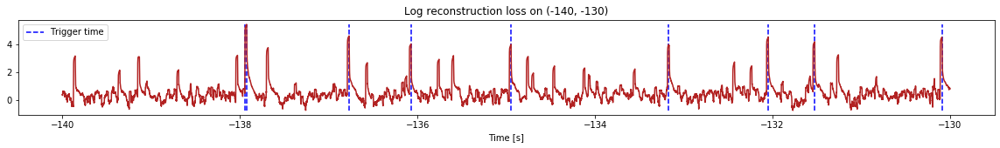

Triggered at:  [-137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]
<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


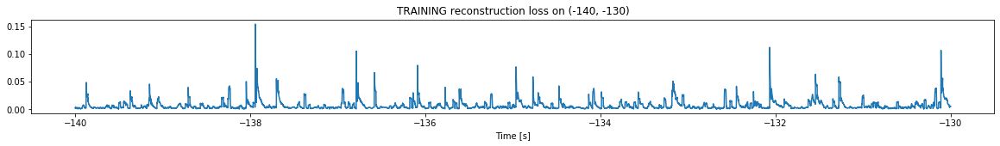

Finished training, median of the log(loss) is:  -2.3664759842949614
Triggering for section:  (-130, -120)
Using this median for triggering: -2.1573075883960855


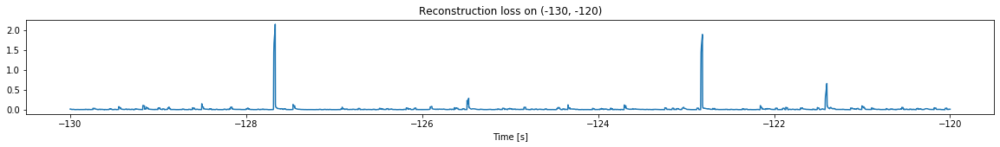

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


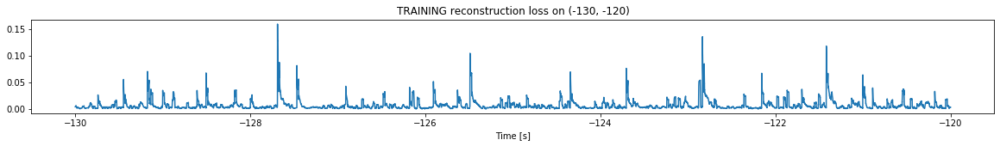

Finished training, median of the log(loss) is:  -2.332622070188311
Triggering for section:  (-120, -110)
Using this median for triggering: -2.3664759842949614


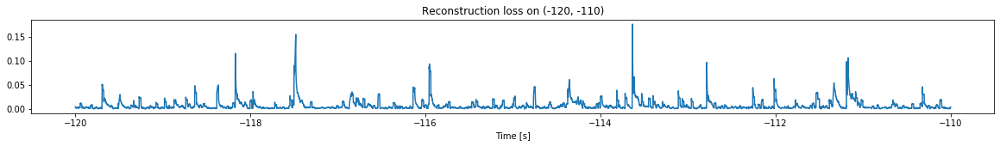

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


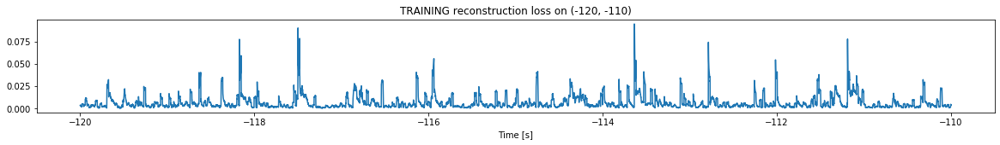

Finished training, median of the log(loss) is:  -2.366613493786616
Triggering for section:  (-110, -100)
Using this median for triggering: -2.332622070188311


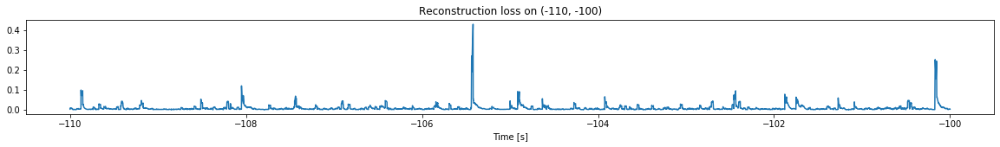

<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


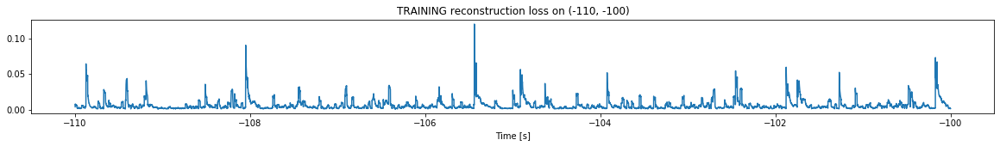

Finished training, median of the log(loss) is:  -2.405650100205883
Triggering for section:  (-100, -90)
Using this median for triggering: -2.366613493786616


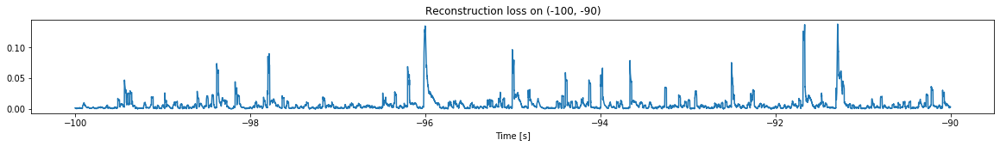

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


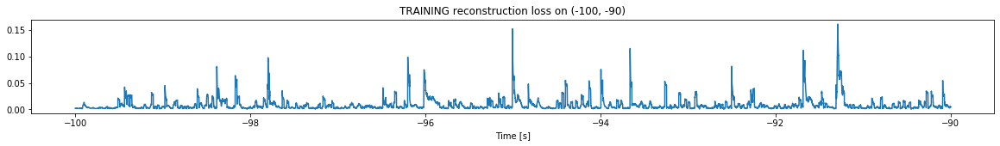

Finished training, median of the log(loss) is:  -2.296924931489758
Triggering for section:  (-90, -80)
Using this median for triggering: -2.405650100205883


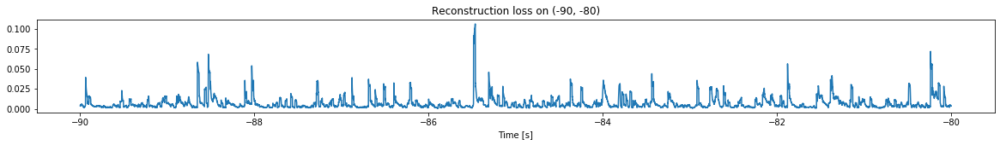

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


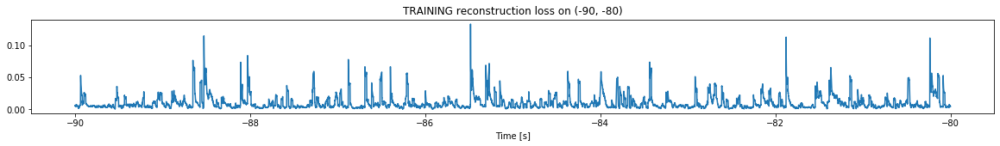

Finished training, median of the log(loss) is:  -2.1675560268644634
Triggering for section:  (-80, -70)
Using this median for triggering: -2.296924931489758


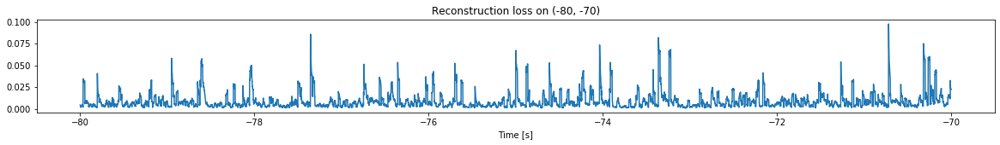

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


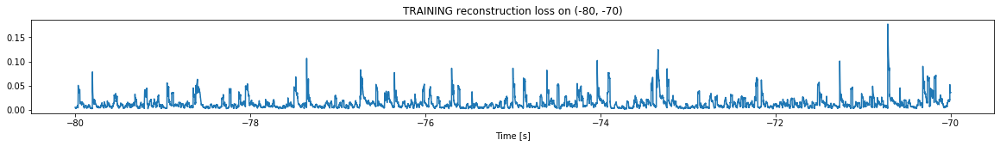

Finished training, median of the log(loss) is:  -2.0173552846827354
Triggering for section:  (-70, -60)
Using this median for triggering: -2.1675560268644634


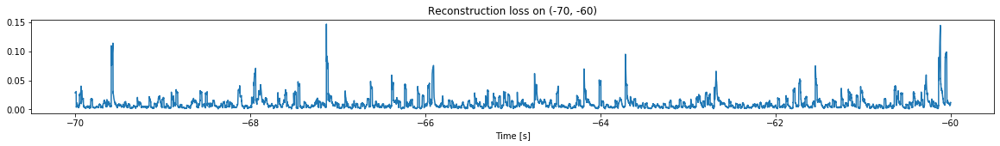

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


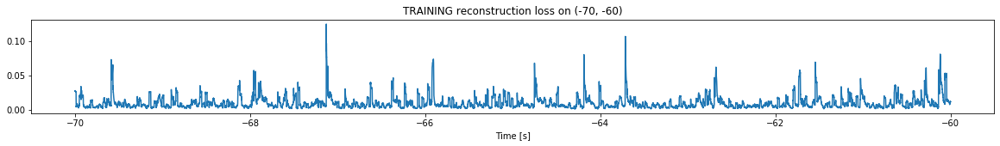

Finished training, median of the log(loss) is:  -2.144170191242544
Triggering for section:  (-60, -50)
Using this median for triggering: -2.0173552846827354


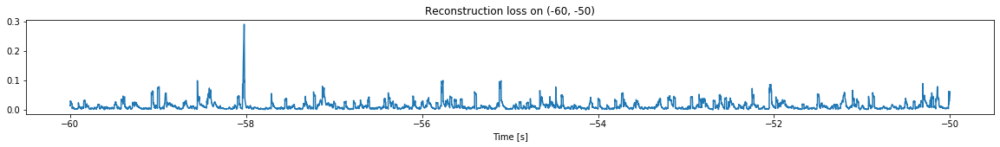

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


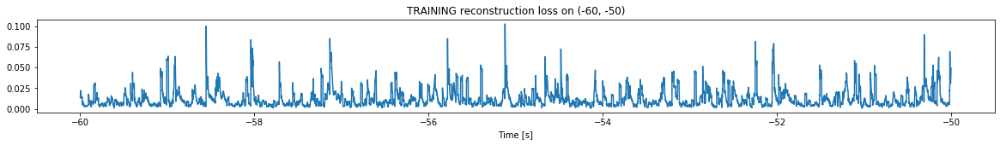

Finished training, median of the log(loss) is:  -2.053710303955401
Triggering for section:  (-50, -40)
Using this median for triggering: -2.144170191242544


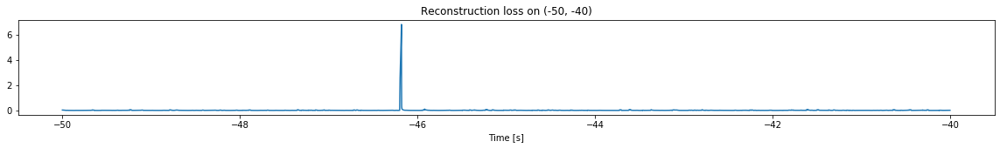

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


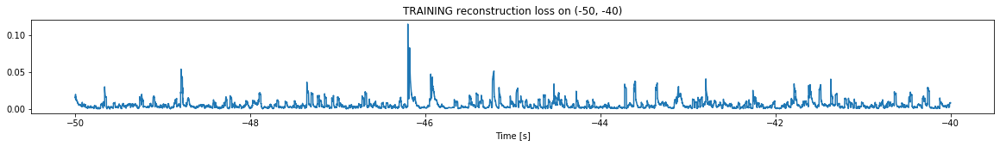

Finished training, median of the log(loss) is:  -2.3471347535989286
Triggering for section:  (-40, -30)
Using this median for triggering: -2.053710303955401


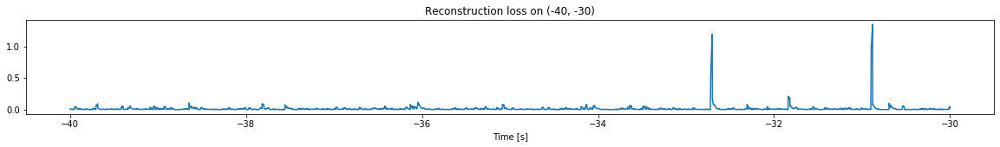

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


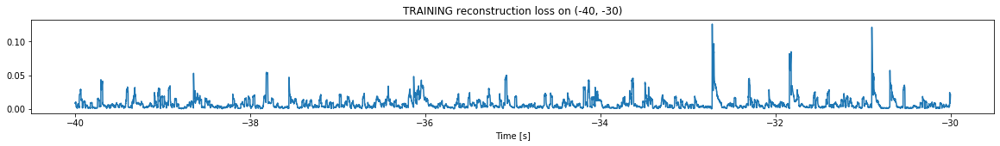

Finished training, median of the log(loss) is:  -2.2446135031544374
Triggering for section:  (-30, -20)
Using this median for triggering: -2.3471347535989286


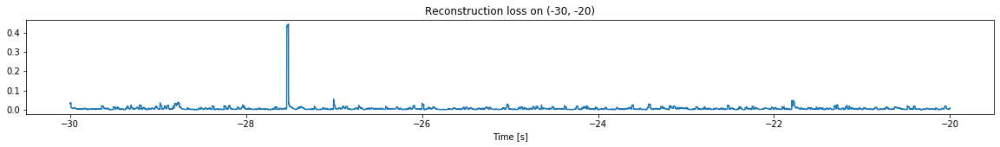

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


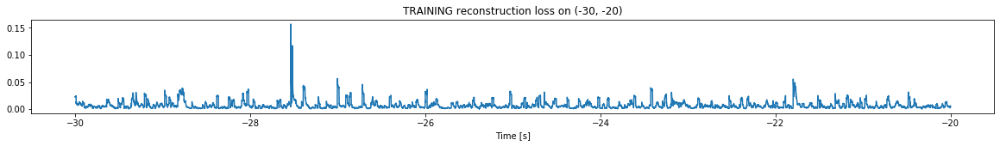

Finished training, median of the log(loss) is:  -2.2628501894285113
Triggering for section:  (-20, -10)
Using this median for triggering: -2.2446135031544374


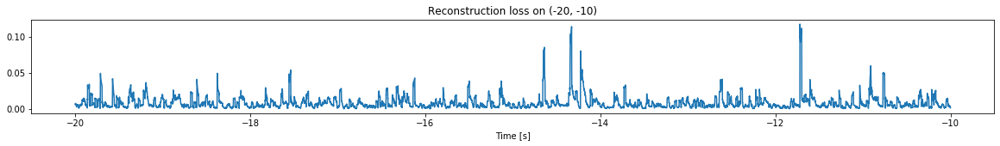

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


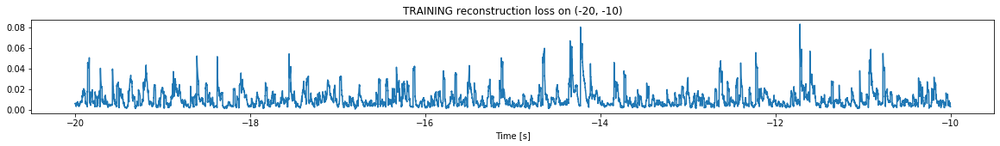

Finished training, median of the log(loss) is:  -2.1000241134583746
Triggering for section:  (-10, 0)
Using this median for triggering: -2.2628501894285113


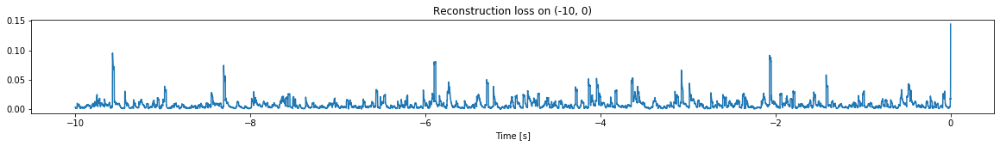

<--------
Finished simulation, all the triggered times are:  [-144.02179, -143.47359, -142.9188, -141.91309, -141.23909, -140.48679, -137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]


In [7]:
simulation("./data/Ramp20/", 10, (-212,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


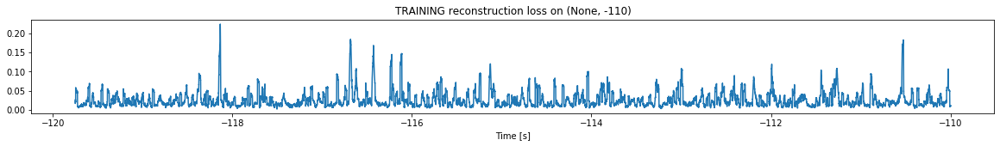

Finished training, median of the log(loss) is:  -1.6949677072749596
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


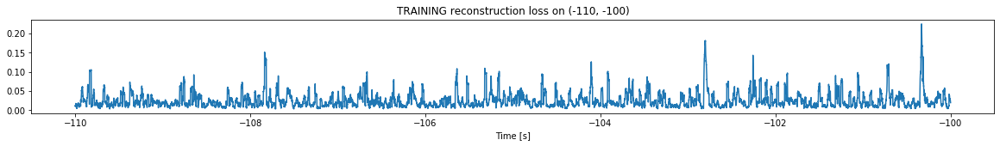

Finished training, median of the log(loss) is:  -1.6950731435073108
Triggering for section:  (-100, -90)
Using this median for triggering: -1.6949677072749596


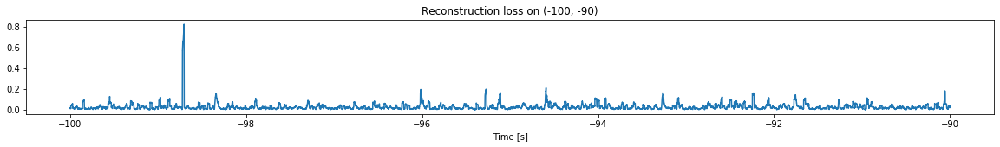

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


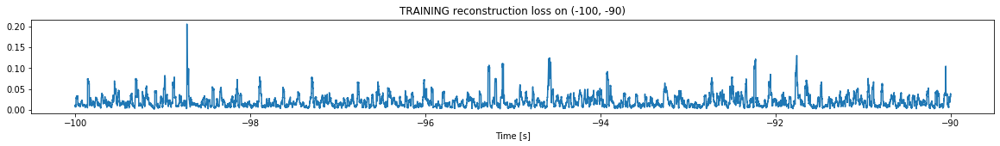

Finished training, median of the log(loss) is:  -1.7947890738497136
Triggering for section:  (-90, -80)
Using this median for triggering: -1.6950731435073108


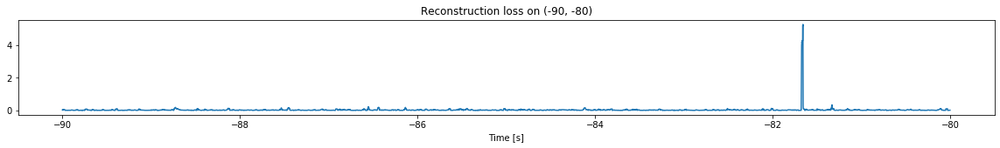

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


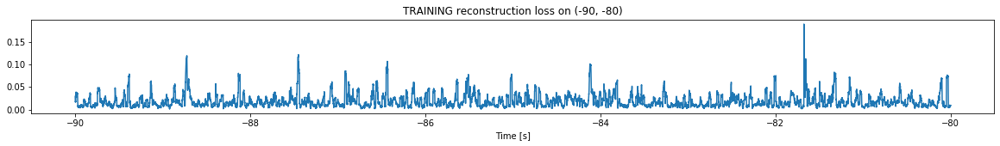

Finished training, median of the log(loss) is:  -1.829939962400567
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7947890738497136


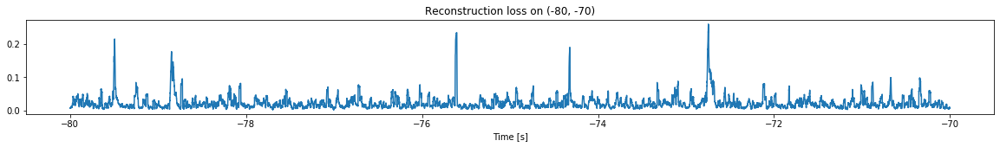

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


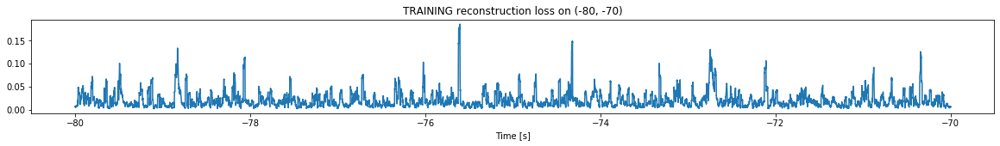

Finished training, median of the log(loss) is:  -1.786066195993787
Triggering for section:  (-70, -60)
Using this median for triggering: -1.829939962400567


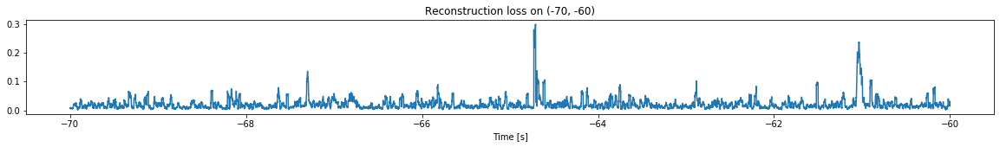

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


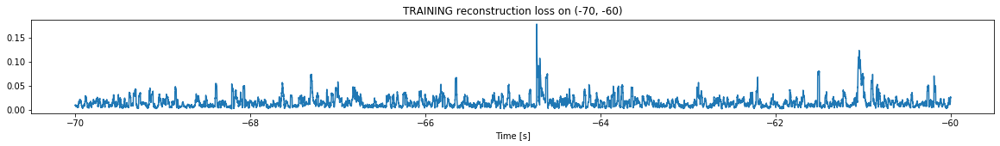

Finished training, median of the log(loss) is:  -1.9031107107938403
Triggering for section:  (-60, -50)
Using this median for triggering: -1.786066195993787


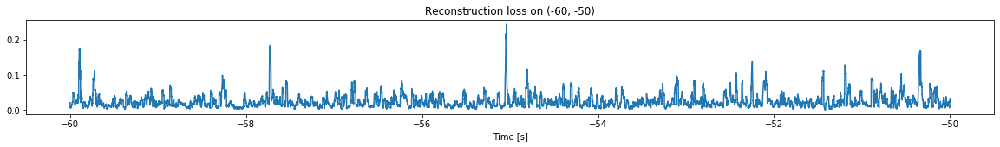

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


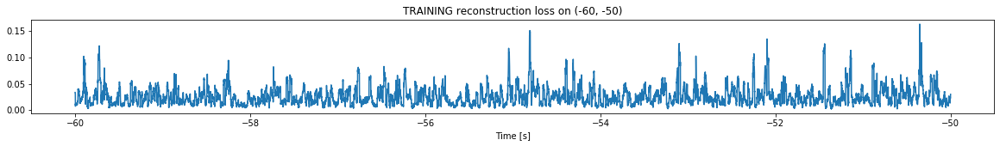

Finished training, median of the log(loss) is:  -1.6436241991527085
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9031107107938403


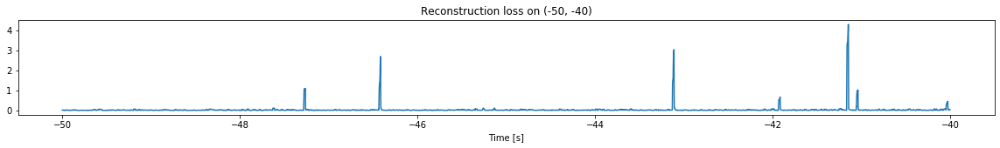

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


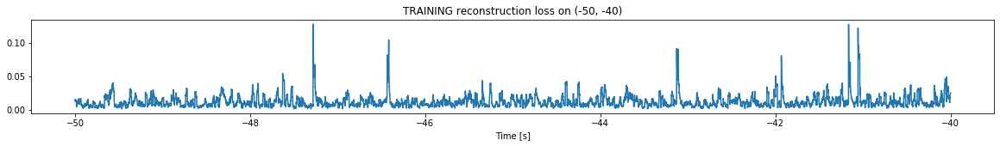

Finished training, median of the log(loss) is:  -2.0084719694740993
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6436241991527085


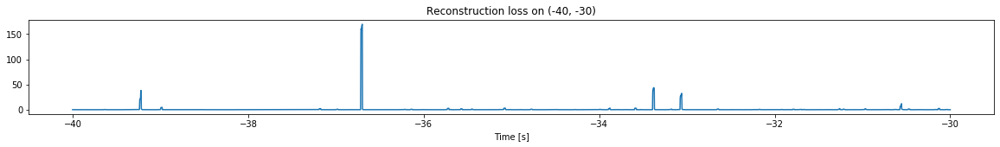

Other trigger time:  [-36.699398]
Their log loss values are:  [3.87290921]


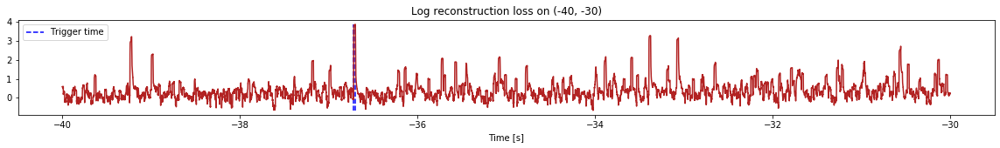

Triggered at:  [-36.699398]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


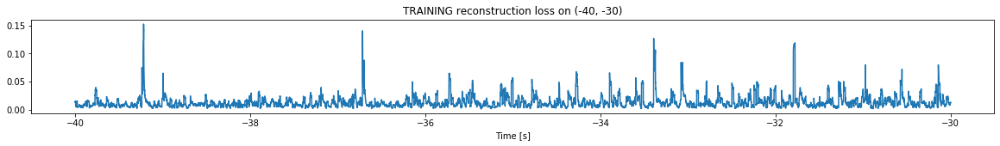

Finished training, median of the log(loss) is:  -1.9615019685718167
Triggering for section:  (-30, -20)
Using this median for triggering: -2.0084719694740993


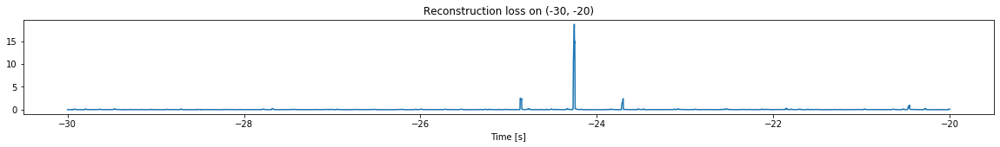

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


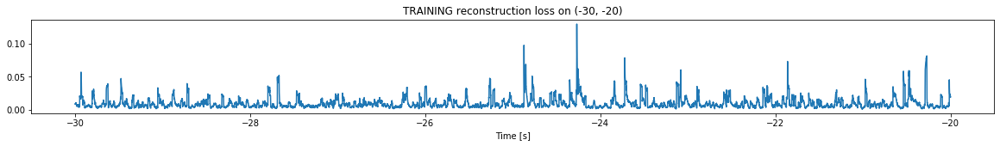

Finished training, median of the log(loss) is:  -2.133920637835561
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9615019685718167


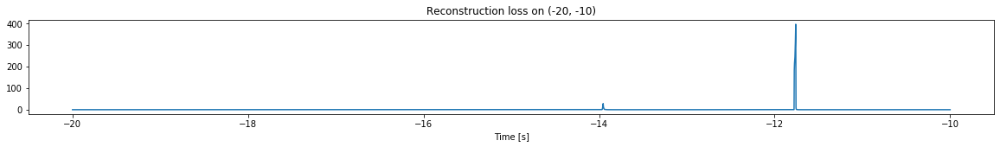

Other trigger time:  [-13.9532995 -11.759    ]
Their log loss values are:  [3.41536454 4.5611384 ]


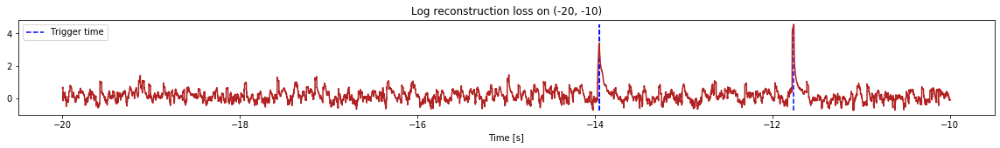

Triggered at:  [-13.9532995, -11.759]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


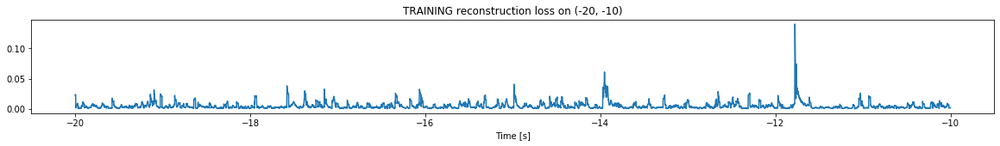

Finished training, median of the log(loss) is:  -2.4129947476768097
Triggering for section:  (-10, 0)
Using this median for triggering: -2.133920637835561


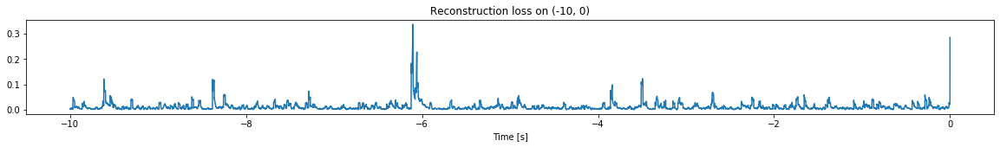

<--------
Finished simulation, all the triggered times are:  [-36.699398, -13.9532995, -11.759]


In [8]:
simulation("./data/Ramp21/", 10, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (797500, 12)
Flushing input history
Number of sections: 8
Entering sections:  (-80, -70)
-------->
Entering sections:  (-70, -60)
-------->
Training for section:  (None, -70)


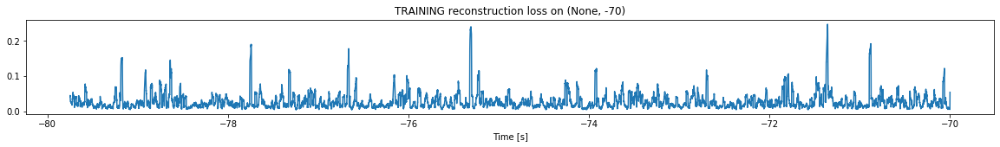

Finished training, median of the log(loss) is:  -1.6635382659377578
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


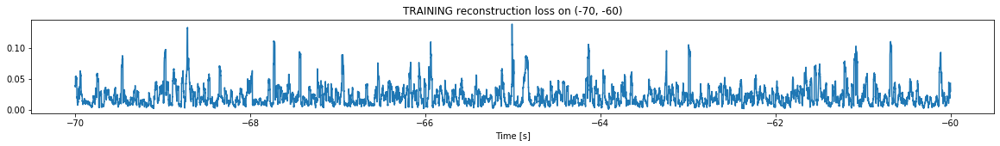

Finished training, median of the log(loss) is:  -1.7233589613733424
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6635382659377578


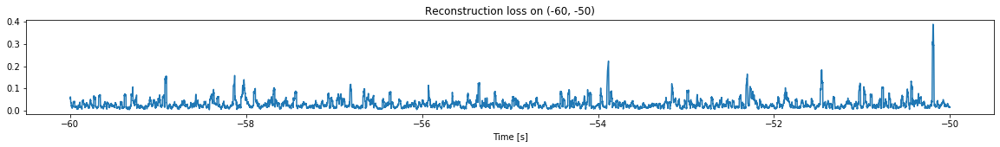

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


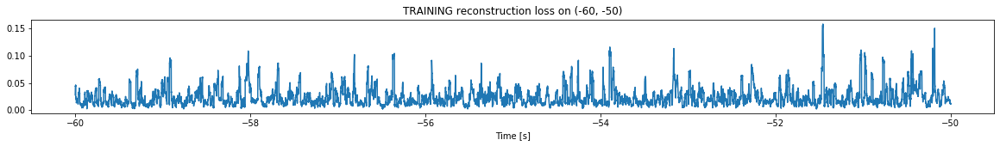

Finished training, median of the log(loss) is:  -1.7149583102301702
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7233589613733424


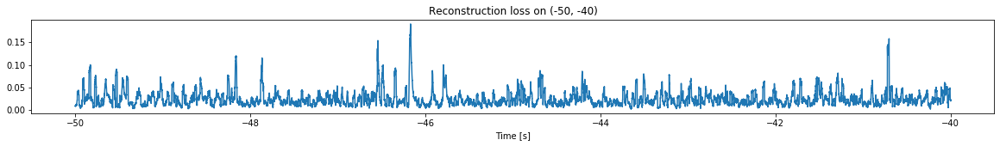

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


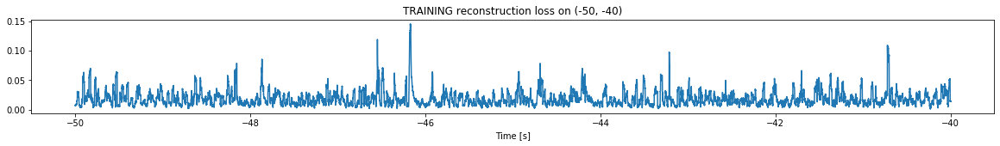

Finished training, median of the log(loss) is:  -1.8048812624591453
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7149583102301702


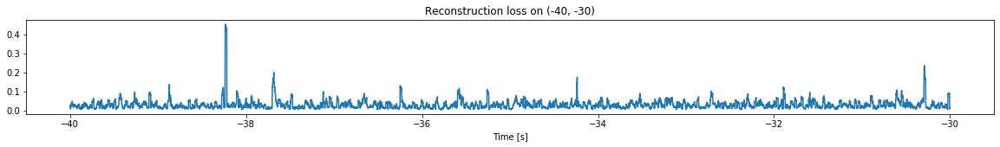

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


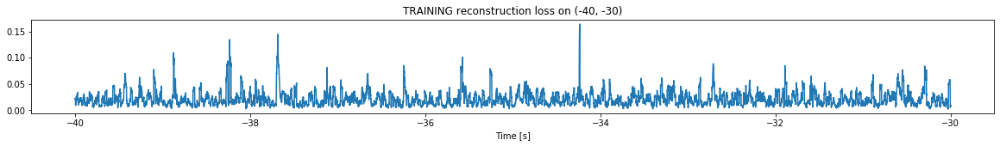

Finished training, median of the log(loss) is:  -1.7317968281934555
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8048812624591453


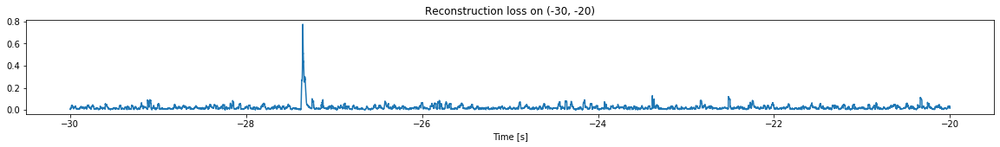

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


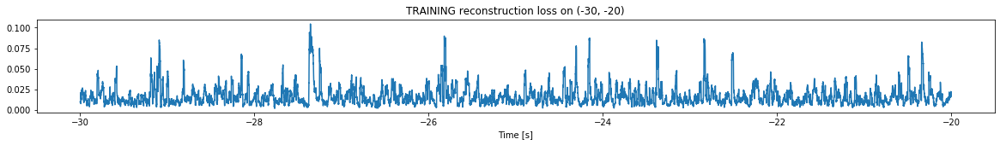

Finished training, median of the log(loss) is:  -1.8683612442511852
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7317968281934555


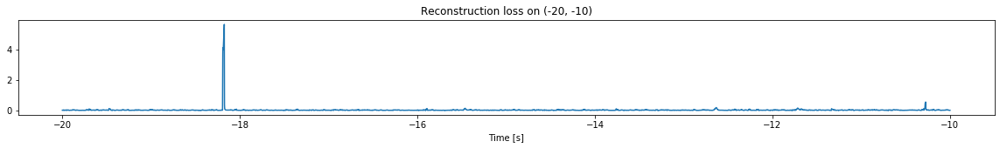

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


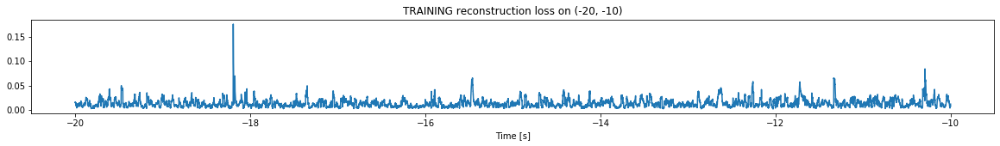

Finished training, median of the log(loss) is:  -1.9448185376247829
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8683612442511852


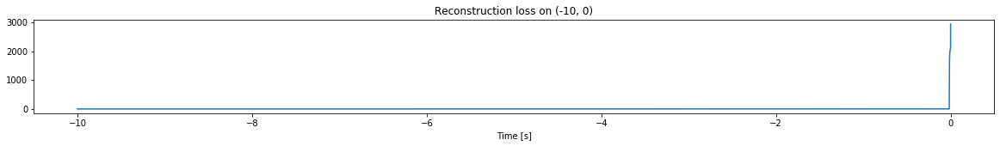

Other trigger time:  [-0.0014]
Their log loss values are:  [5.19248504]


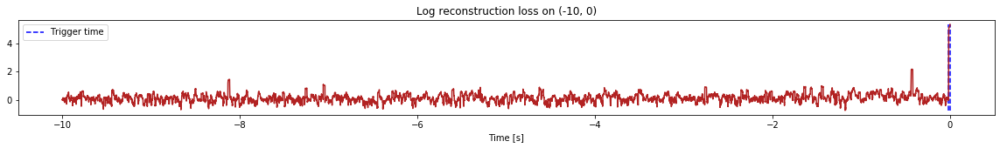

Triggered at:  [-0.0014]
<--------
Finished simulation, all the triggered times are:  [-0.0014]


In [9]:
simulation("./data/Ramp22/", 10, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 5
Entering sections:  (-50, -40)
-------->
Entering sections:  (-40, -30)
-------->
Training for section:  (None, -40)


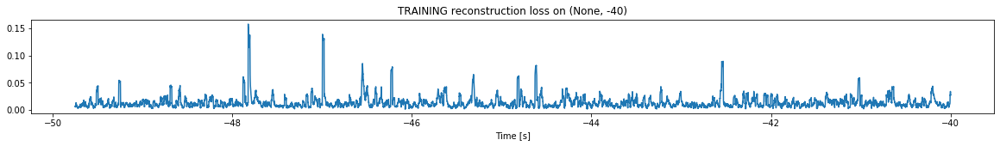

Finished training, median of the log(loss) is:  -1.946189693861925
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


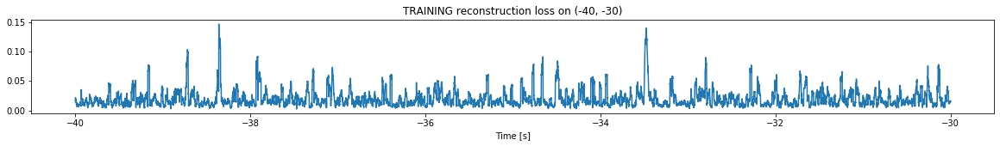

Finished training, median of the log(loss) is:  -1.794820289945875
Triggering for section:  (-30, -20)
Using this median for triggering: -1.946189693861925


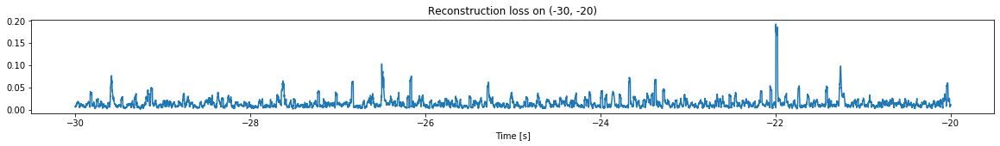

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


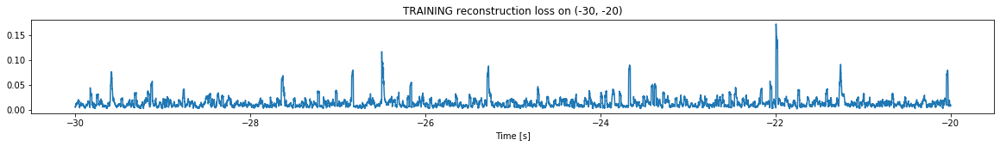

Finished training, median of the log(loss) is:  -1.9663256758711518
Triggering for section:  (-20, -10)
Using this median for triggering: -1.794820289945875


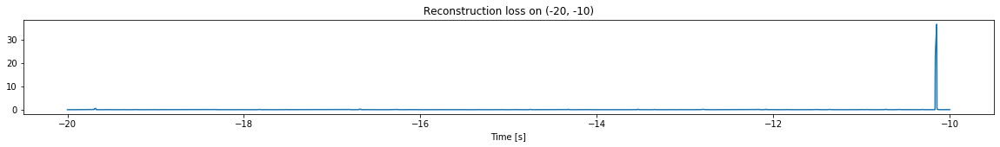

Other trigger time:  [-10.1461]
Their log loss values are:  [3.35986139]


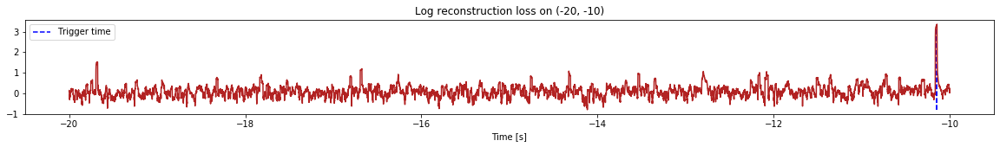

Triggered at:  [-10.1461]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


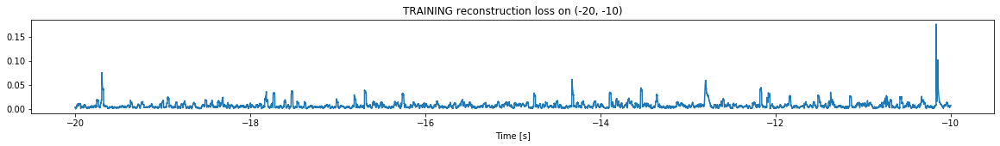

Finished training, median of the log(loss) is:  -2.1901131544075874
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9663256758711518


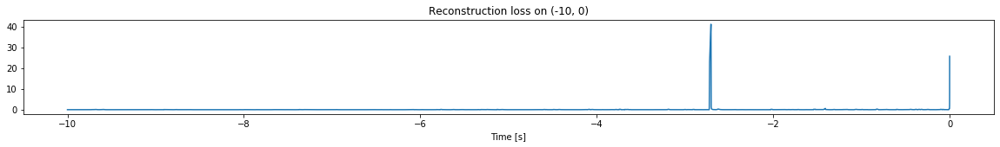

Other trigger time:  [-2.7054]
Their log loss values are:  [3.58092709]


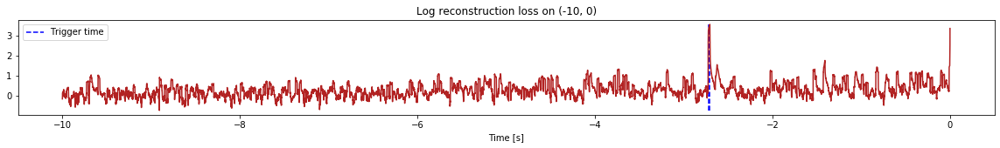

Triggered at:  [-2.7054]
<--------
Finished simulation, all the triggered times are:  [-10.1461, -2.7054]


In [10]:
simulation("./data/Ramp23/", 10, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


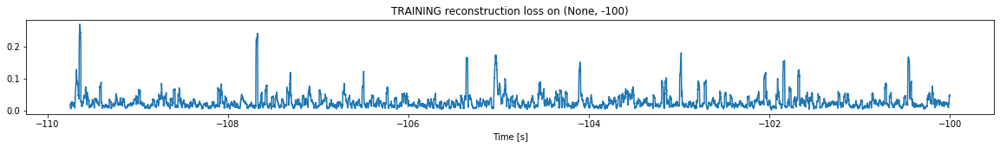

Finished training, median of the log(loss) is:  -1.6485802499139355
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


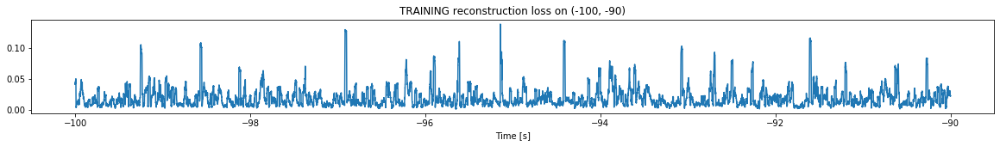

Finished training, median of the log(loss) is:  -1.8014362306827238
Triggering for section:  (-90, -80)
Using this median for triggering: -1.6485802499139355


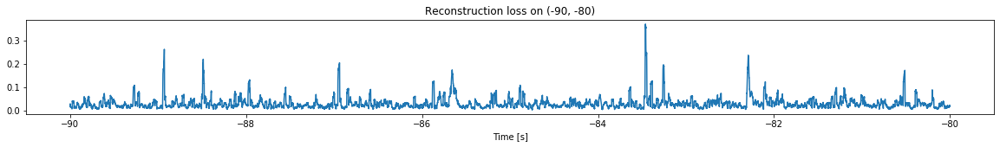

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


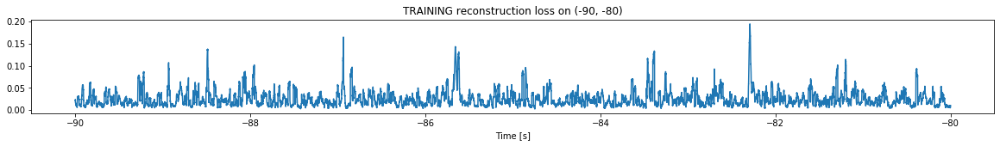

Finished training, median of the log(loss) is:  -1.6741093451000042
Triggering for section:  (-80, -70)
Using this median for triggering: -1.8014362306827238


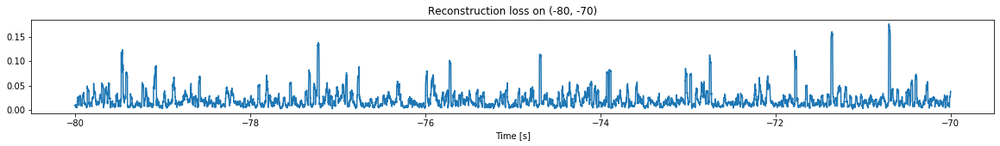

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


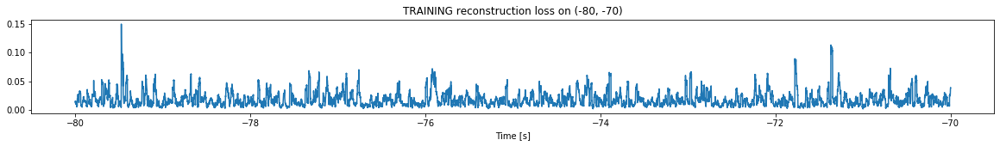

Finished training, median of the log(loss) is:  -1.8184611643213244
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6741093451000042


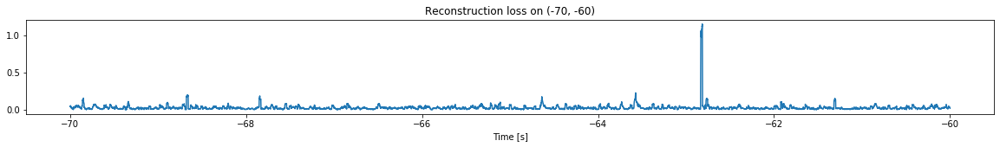

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


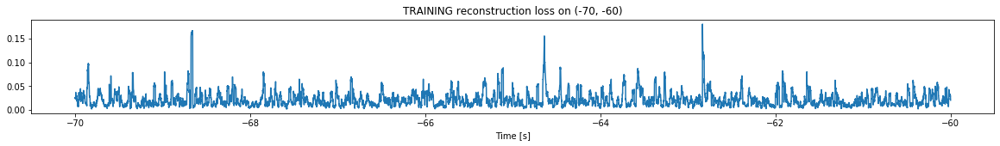

Finished training, median of the log(loss) is:  -1.7406328123135126
Triggering for section:  (-60, -50)
Using this median for triggering: -1.8184611643213244


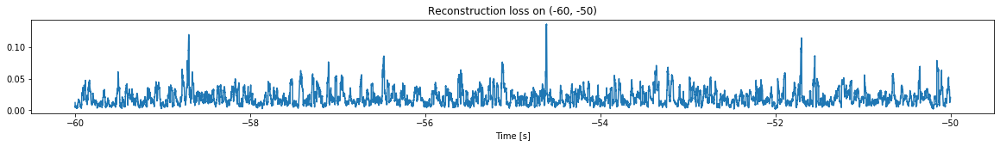

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


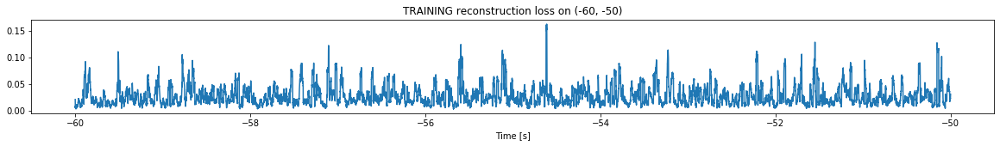

Finished training, median of the log(loss) is:  -1.6346790582377875
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7406328123135126


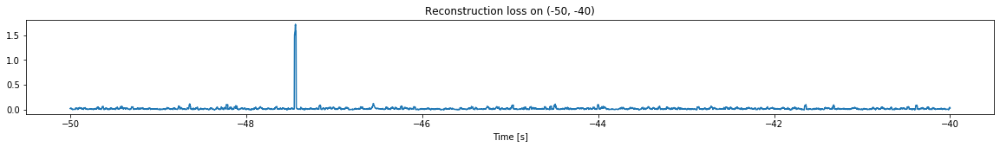

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


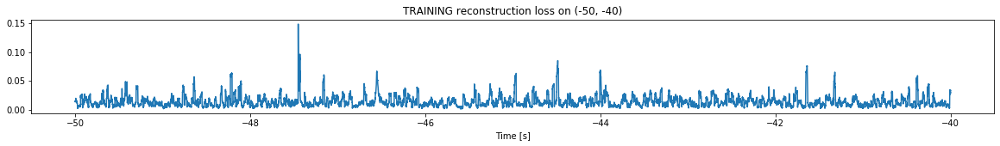

Finished training, median of the log(loss) is:  -1.9140242043133606
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6346790582377875


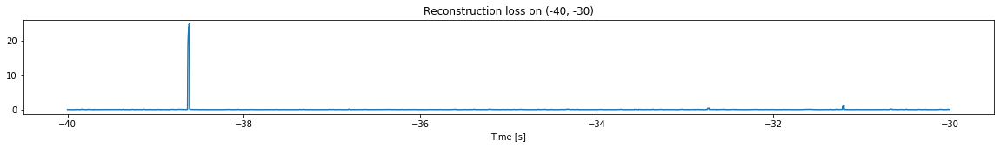

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


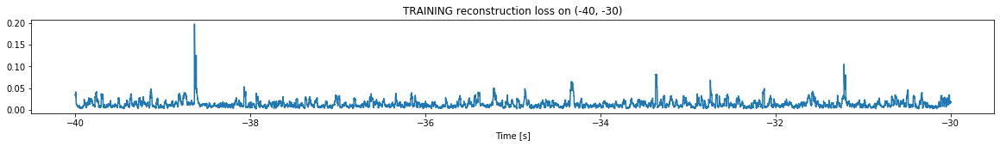

Finished training, median of the log(loss) is:  -1.9600005123730337
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9140242043133606


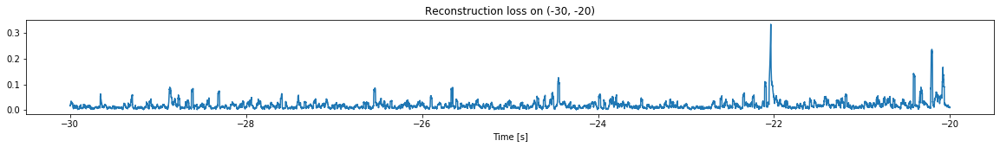

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


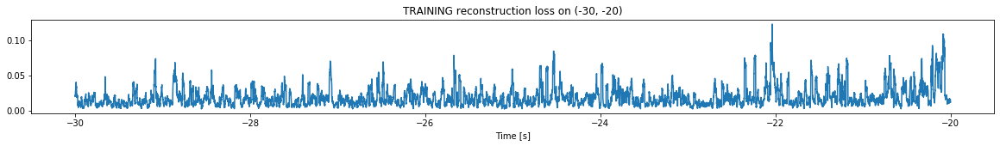

Finished training, median of the log(loss) is:  -1.8068410521438638
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9600005123730337


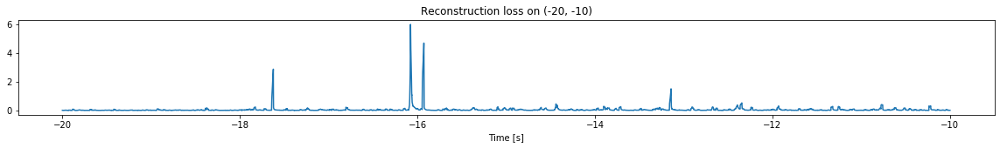

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


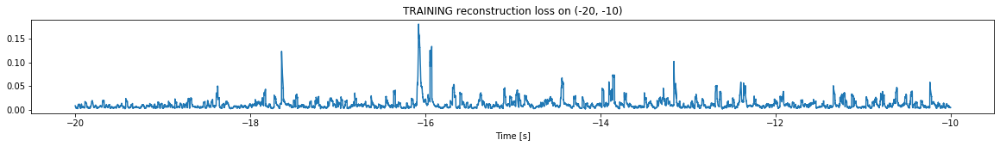

Finished training, median of the log(loss) is:  -2.065197727236916
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8068410521438638


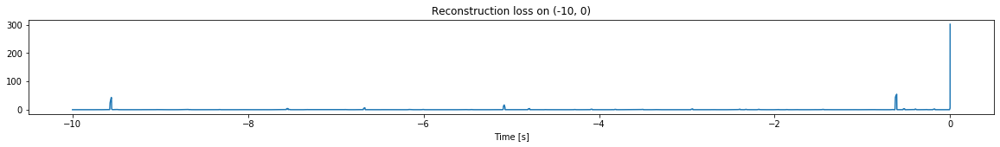

Other trigger time:  [-9.5574 -0.6089]
Their log loss values are:  [3.44322369 3.54440727]


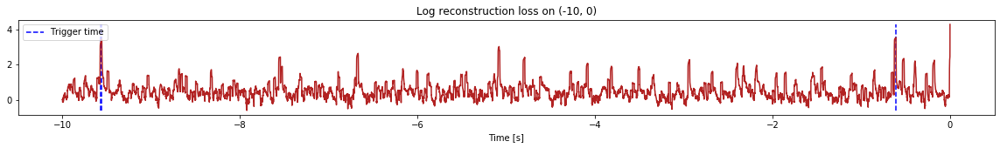

Triggered at:  [-9.5574, -0.6089]
<--------
Finished simulation, all the triggered times are:  [-9.5574, -0.6089]


In [11]:
simulation("./data/Ramp24/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


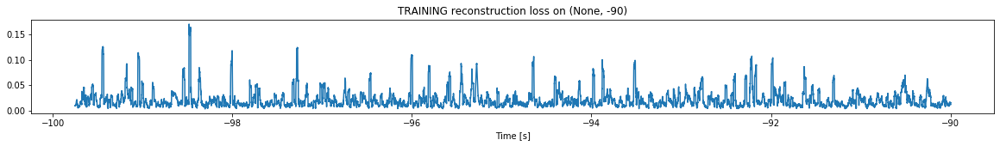

Finished training, median of the log(loss) is:  -1.7951325839972694
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


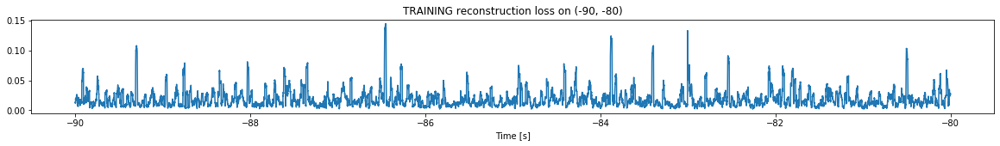

Finished training, median of the log(loss) is:  -1.820980479607869
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7951325839972694


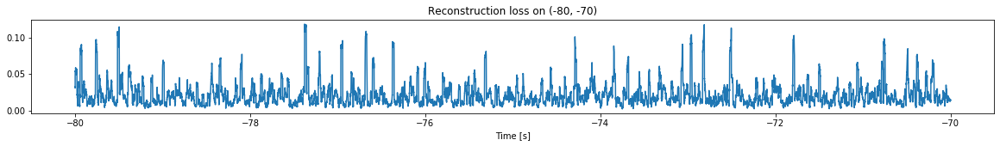

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


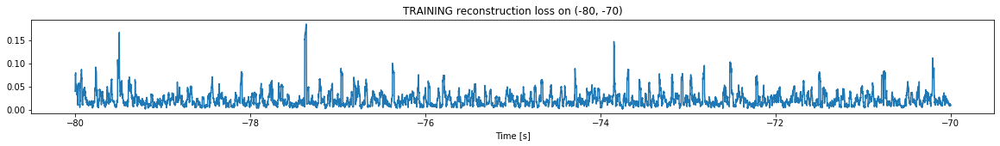

Finished training, median of the log(loss) is:  -1.719665652668842
Triggering for section:  (-70, -60)
Using this median for triggering: -1.820980479607869


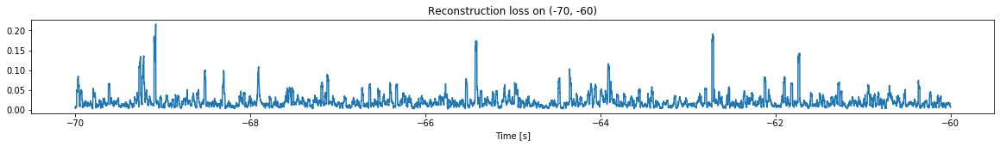

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


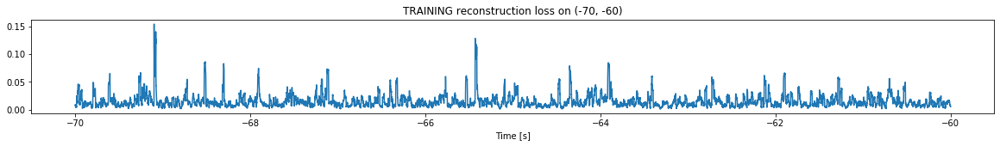

Finished training, median of the log(loss) is:  -1.9095380552727723
Triggering for section:  (-60, -50)
Using this median for triggering: -1.719665652668842


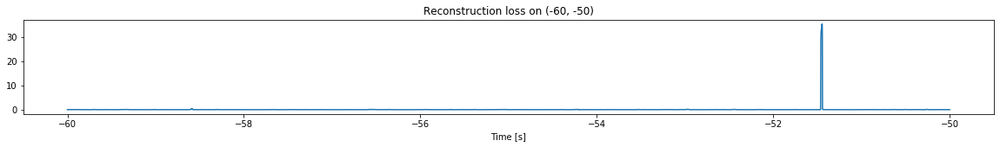

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


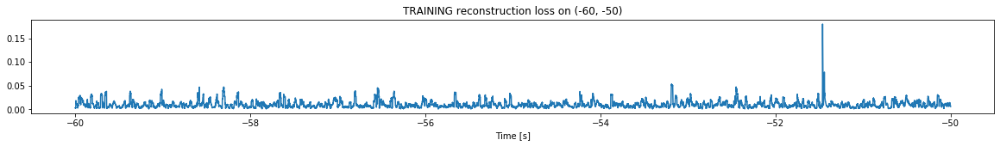

Finished training, median of the log(loss) is:  -2.046634533097598
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9095380552727723


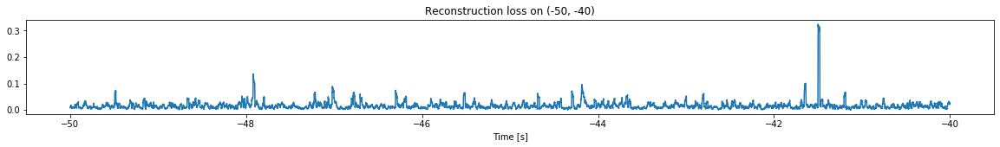

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


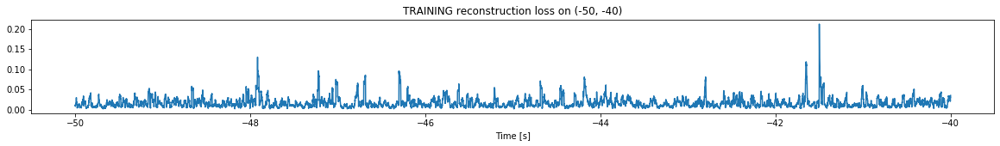

Finished training, median of the log(loss) is:  -1.8510743939178353
Triggering for section:  (-40, -30)
Using this median for triggering: -2.046634533097598


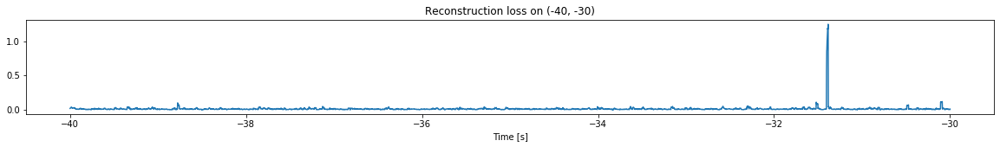

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


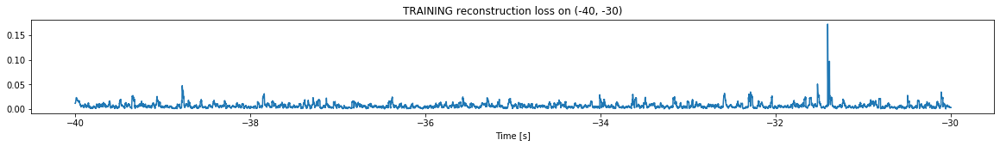

Finished training, median of the log(loss) is:  -2.218133827139326
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8510743939178353


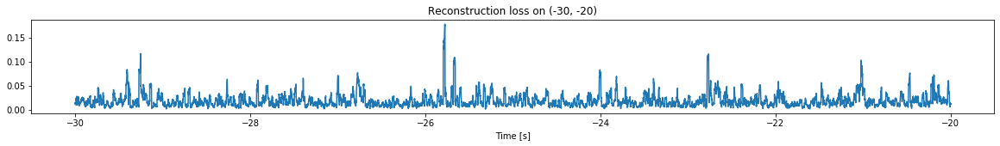

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


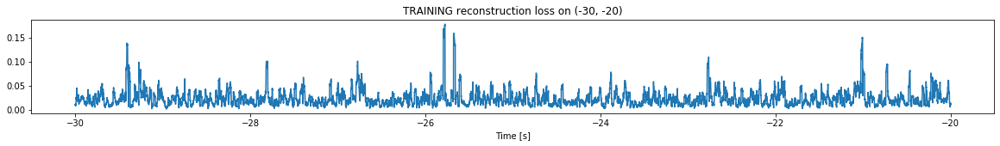

Finished training, median of the log(loss) is:  -1.7012377661553648
Triggering for section:  (-20, -10)
Using this median for triggering: -2.218133827139326


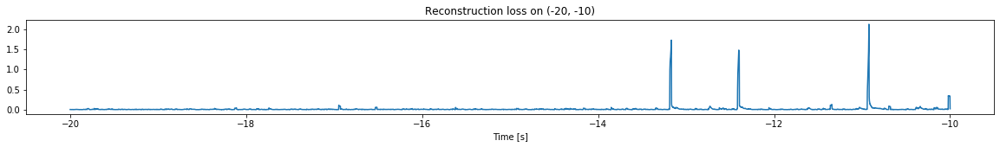

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


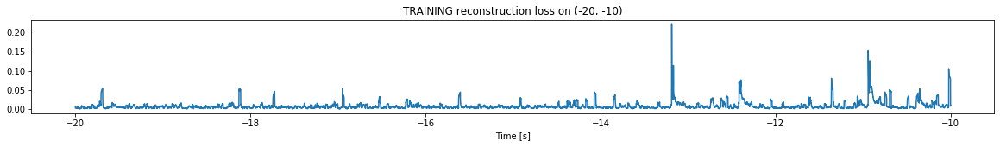

Finished training, median of the log(loss) is:  -2.2499549955764744
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7012377661553648


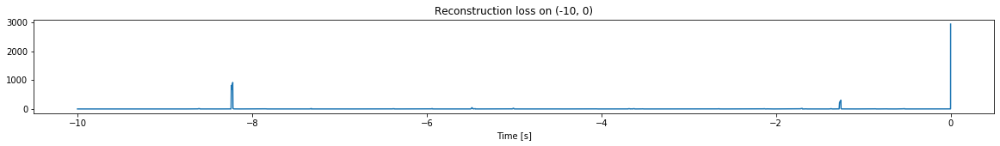

Other trigger time:  [-8.2217    -5.4825    -1.2574999]
Their log loss values are:  [4.66430488 3.36858172 4.18572622]


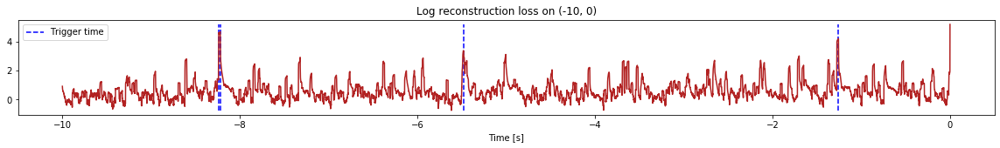

Triggered at:  [-8.2217, -5.4825, -1.2574999]
<--------
Finished simulation, all the triggered times are:  [-8.2217, -5.4825, -1.2574999]


In [12]:
simulation("./data/Ramp25/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


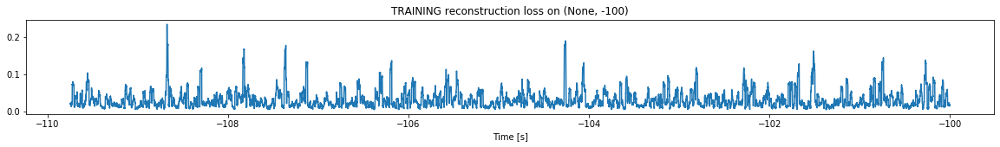

Finished training, median of the log(loss) is:  -1.5999466225666326
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


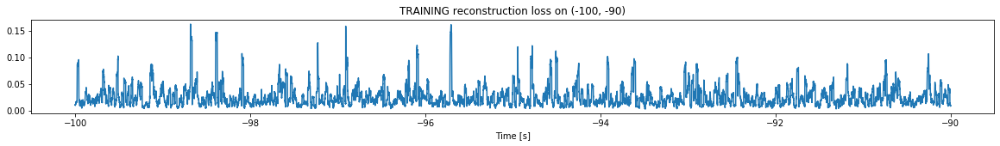

Finished training, median of the log(loss) is:  -1.6690411936108802
Triggering for section:  (-90, -80)
Using this median for triggering: -1.5999466225666326


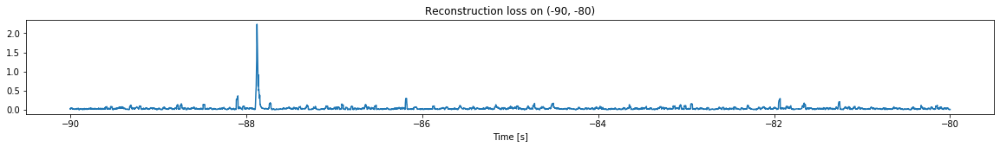

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


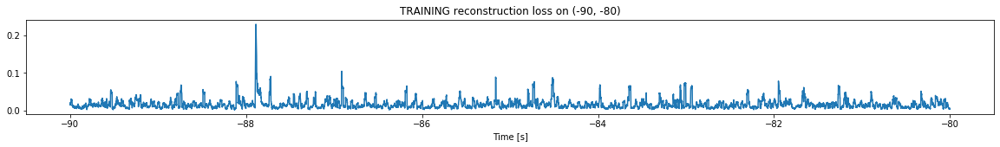

Finished training, median of the log(loss) is:  -1.8744229026062729
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6690411936108802


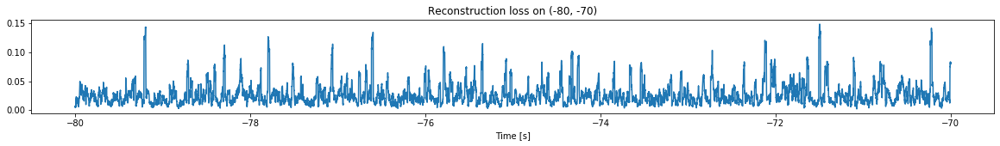

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


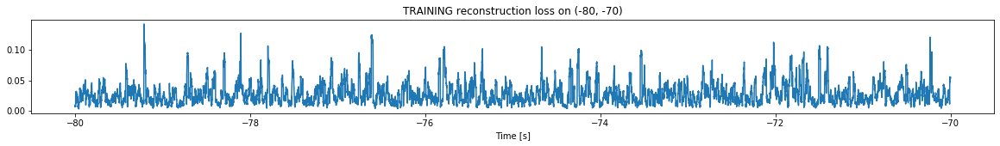

Finished training, median of the log(loss) is:  -1.6193327731144338
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8744229026062729


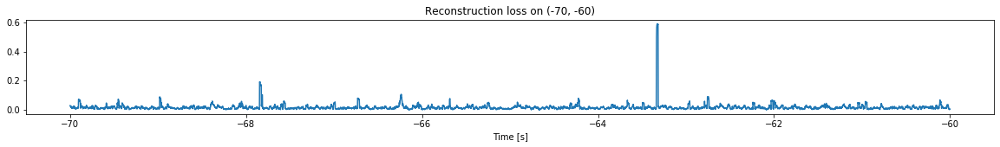

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


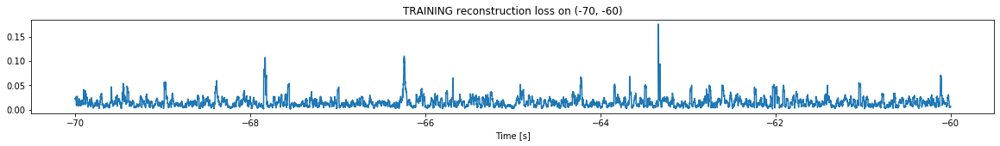

Finished training, median of the log(loss) is:  -1.8898109807849226
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6193327731144338


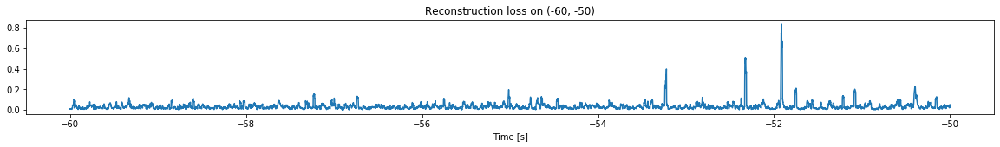

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


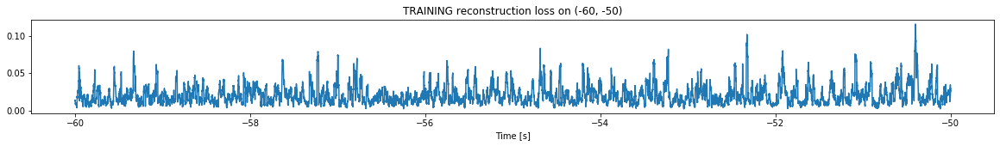

Finished training, median of the log(loss) is:  -1.7505896333113873
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8898109807849226


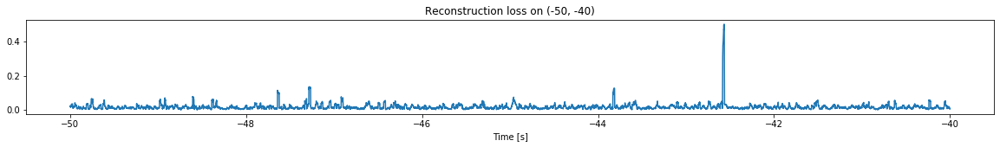

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


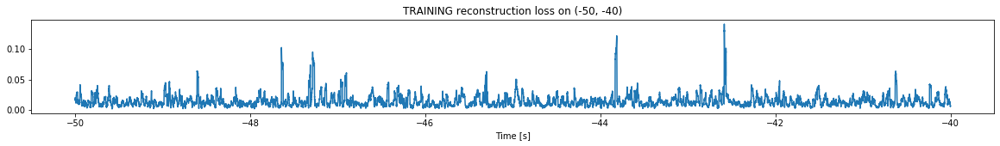

Finished training, median of the log(loss) is:  -1.9225390782560927
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7505896333113873


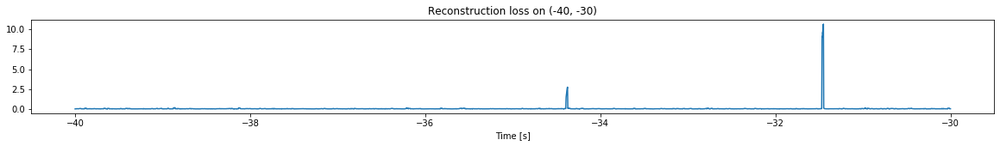

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


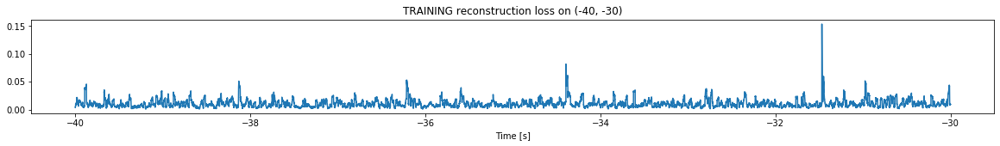

Finished training, median of the log(loss) is:  -2.0279614581211276
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9225390782560927


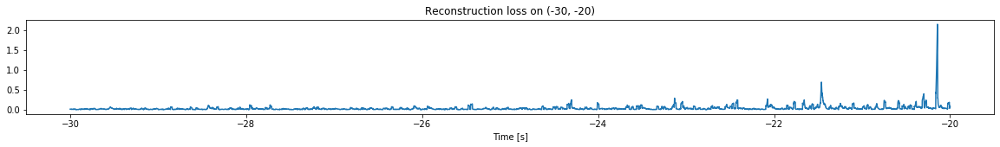

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


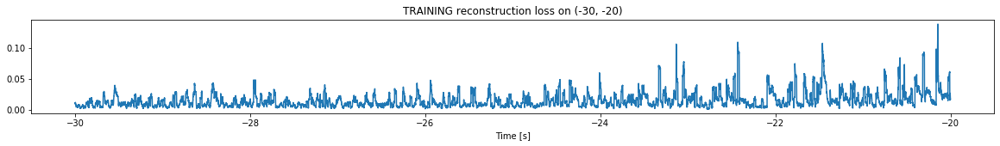

Finished training, median of the log(loss) is:  -1.9345662642158494
Triggering for section:  (-20, -10)
Using this median for triggering: -2.0279614581211276


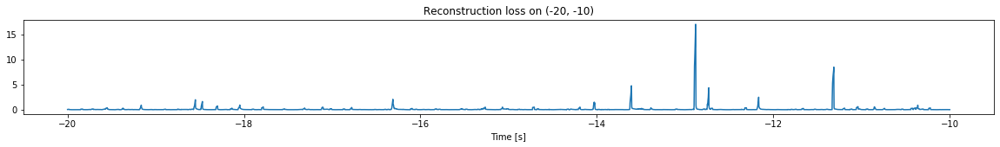

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


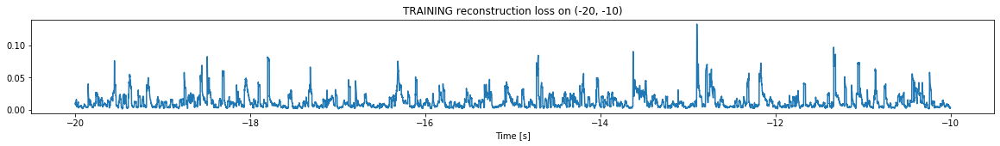

Finished training, median of the log(loss) is:  -2.0568213710670893
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9345662642158494


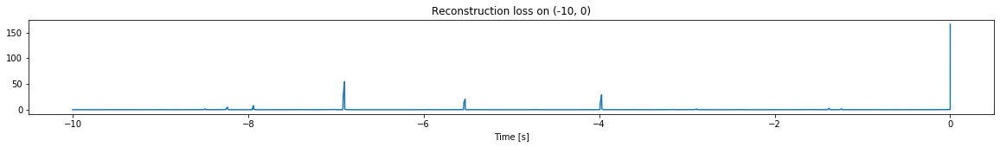

Other trigger time:  [-6.9013 -3.9722]
Their log loss values are:  [3.67075531 3.40050525]


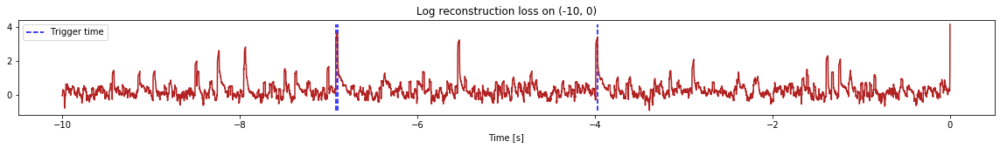

Triggered at:  [-6.9013, -3.9722]
<--------
Finished simulation, all the triggered times are:  [-6.9013, -3.9722]


In [13]:
simulation("./data/Ramp26/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (697500, 12)
Flushing input history
Number of sections: 7
Entering sections:  (-70, -60)
-------->
Entering sections:  (-60, -50)
-------->
Training for section:  (None, -60)


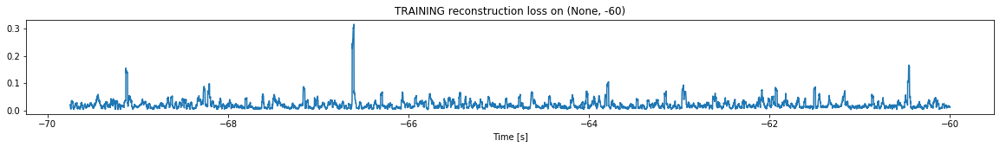

Finished training, median of the log(loss) is:  -1.76455227547742
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


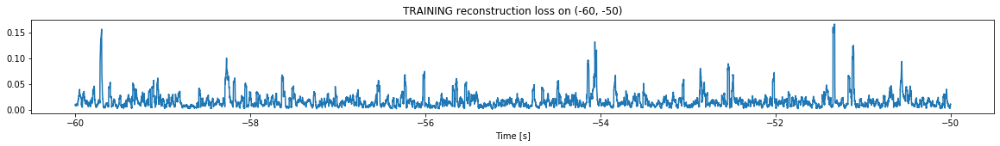

Finished training, median of the log(loss) is:  -1.8751783916030769
Triggering for section:  (-50, -40)
Using this median for triggering: -1.76455227547742


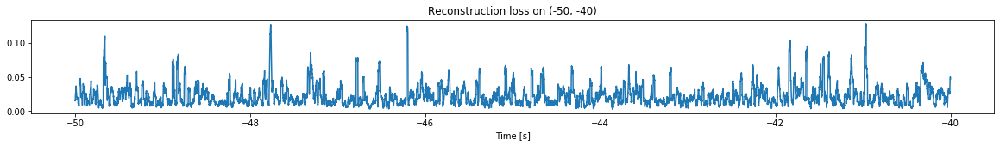

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


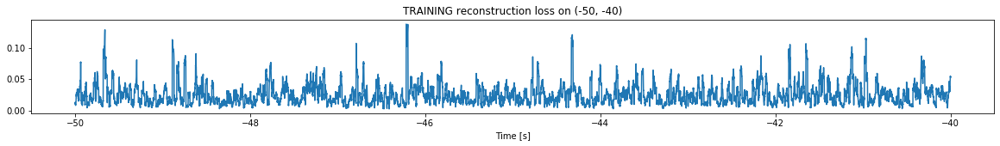

Finished training, median of the log(loss) is:  -1.6554495932669688
Triggering for section:  (-40, -30)
Using this median for triggering: -1.8751783916030769


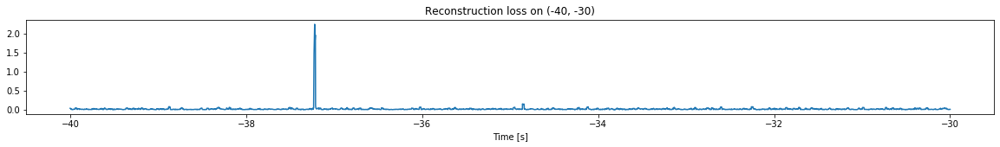

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


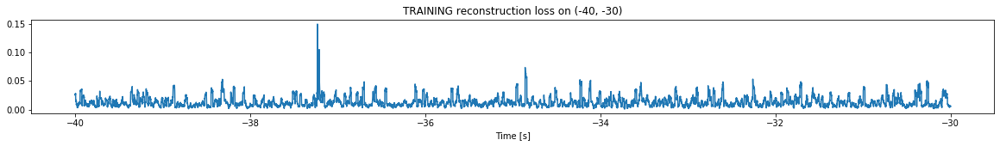

Finished training, median of the log(loss) is:  -1.9625224542316952
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6554495932669688


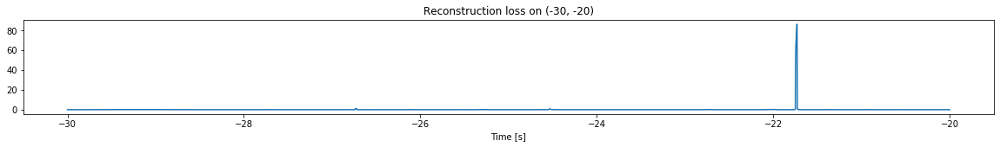

Other trigger time:  [-21.7299]
Their log loss values are:  [3.5925628]


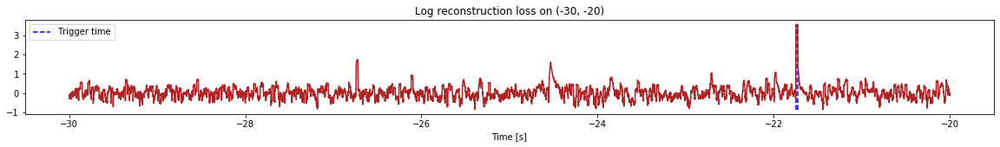

Triggered at:  [-21.7299]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


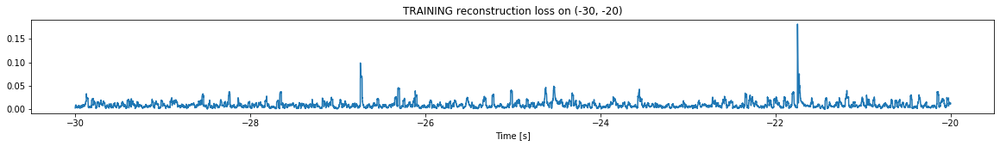

Finished training, median of the log(loss) is:  -2.0914459450897467
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9625224542316952


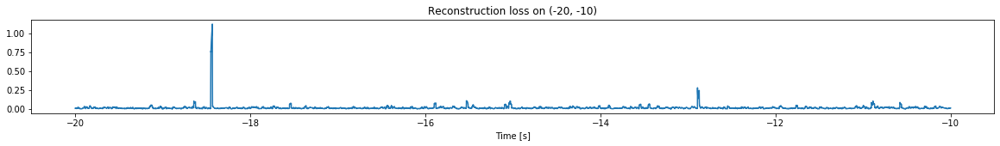

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


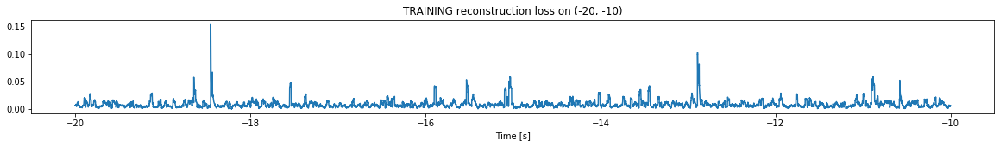

Finished training, median of the log(loss) is:  -2.1255204707874777
Triggering for section:  (-10, 0)
Using this median for triggering: -2.0914459450897467


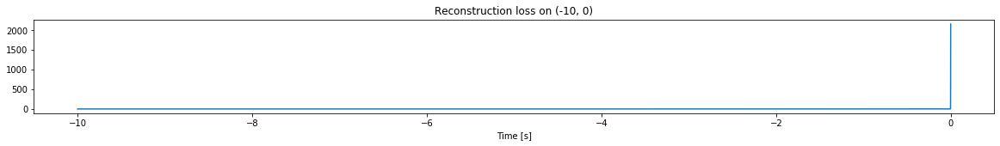

Other trigger time:  []
Their log loss values are:  []


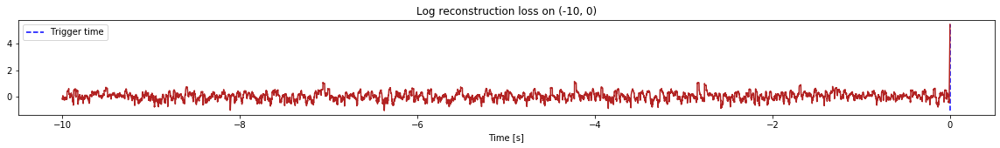

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [-21.7299]


In [14]:
simulation("./data/Ramp27/", 10, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (597500, 12)
Flushing input history
Number of sections: 6
Entering sections:  (-60, -50)
-------->
Entering sections:  (-50, -40)
-------->
Training for section:  (None, -50)


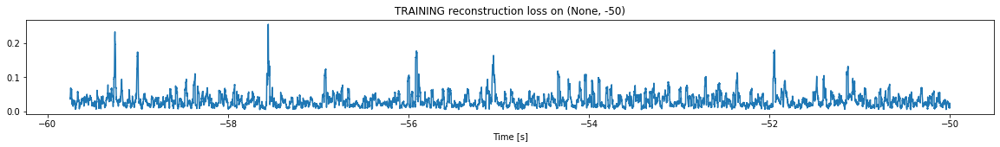

Finished training, median of the log(loss) is:  -1.5739558972957584
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


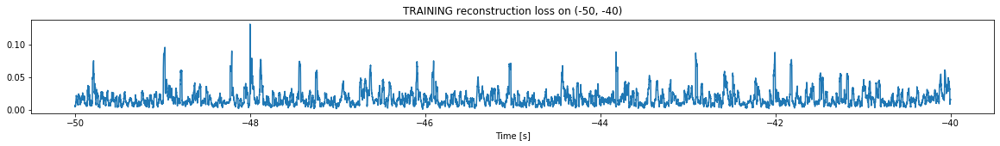

Finished training, median of the log(loss) is:  -1.8363075880230837
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5739558972957584


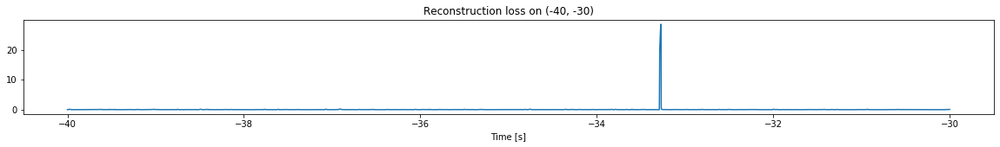

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


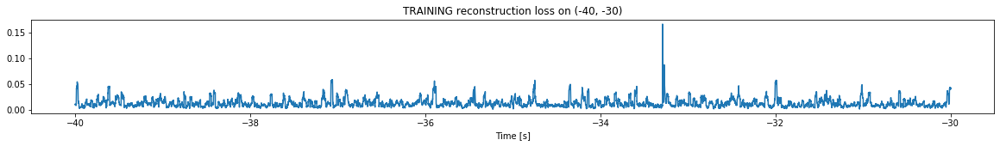

Finished training, median of the log(loss) is:  -1.9755524749960691
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8363075880230837


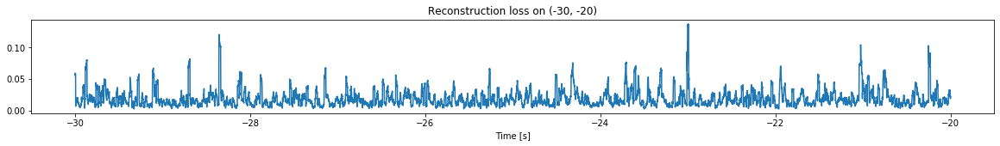

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


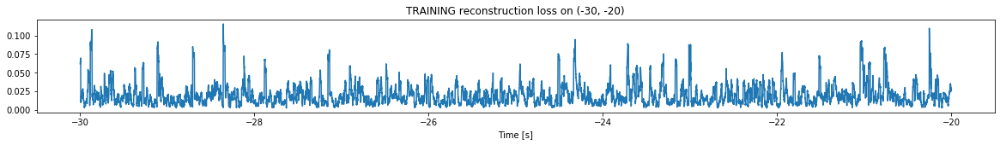

Finished training, median of the log(loss) is:  -1.7654620899526154
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9755524749960691


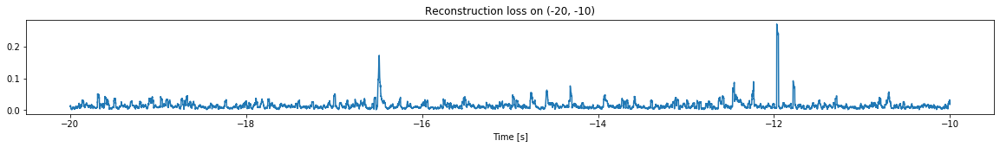

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


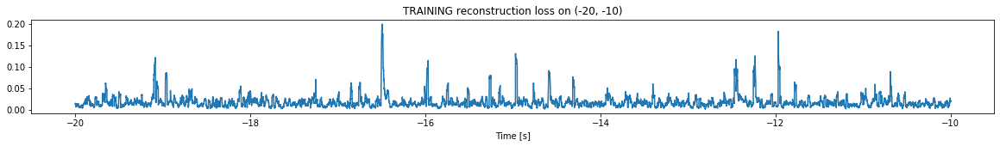

Finished training, median of the log(loss) is:  -1.8153796025393631
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7654620899526154


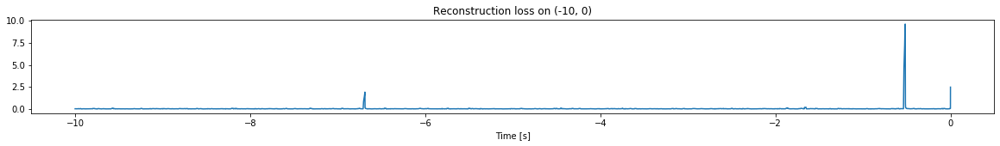

<--------
Finished simulation, all the triggered times are:  []


In [15]:
simulation("./data/Ramp28/", 10, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


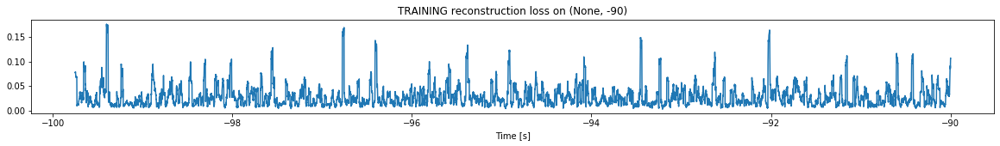

Finished training, median of the log(loss) is:  -1.6357758367601627
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


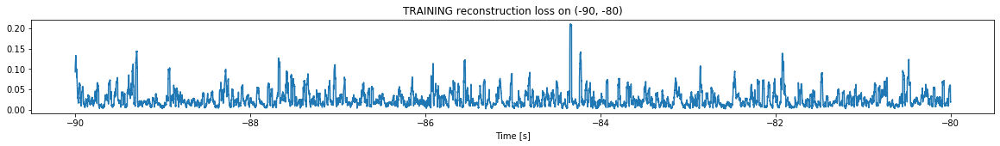

Finished training, median of the log(loss) is:  -1.6794928968229657
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6357758367601627


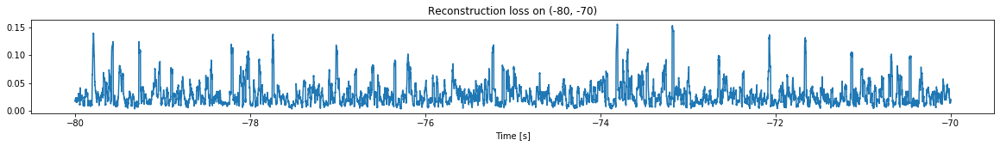

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


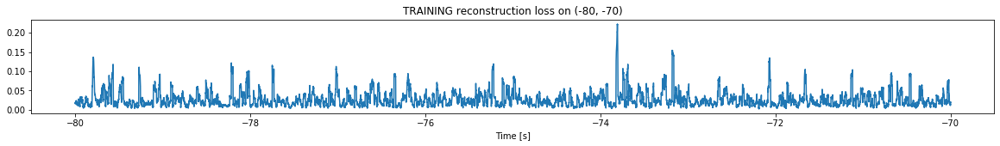

Finished training, median of the log(loss) is:  -1.6549162955938979
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6794928968229657


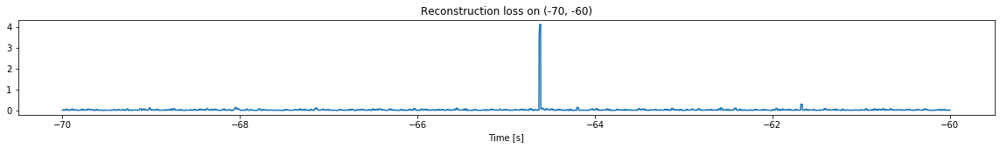

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


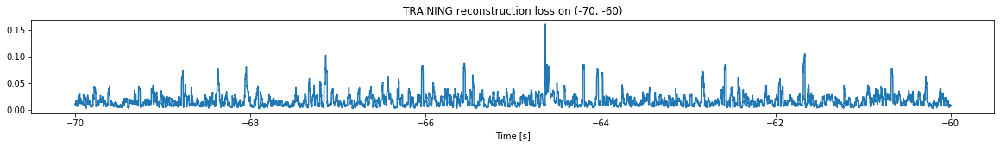

Finished training, median of the log(loss) is:  -1.8477330895645618
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6549162955938979


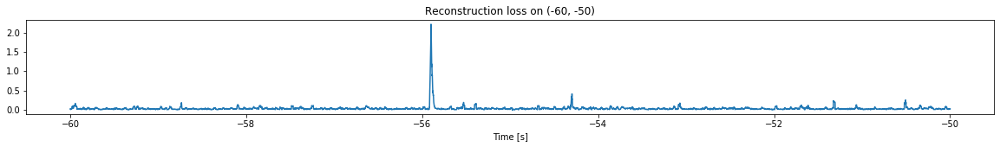

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


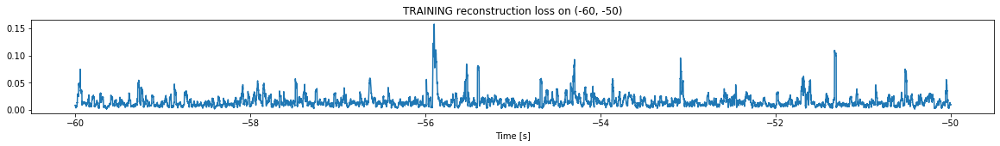

Finished training, median of the log(loss) is:  -1.8894354522969885
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8477330895645618


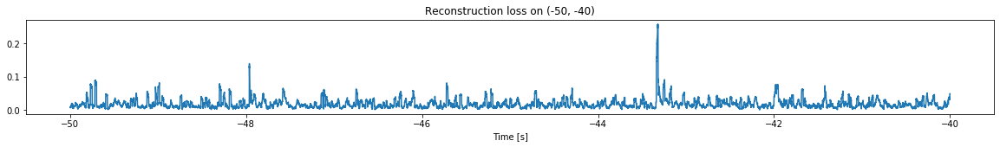

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


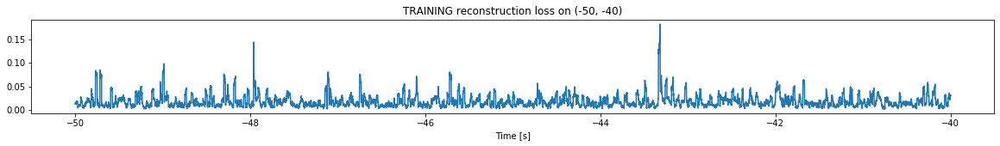

Finished training, median of the log(loss) is:  -1.8200075751862566
Triggering for section:  (-40, -30)
Using this median for triggering: -1.8894354522969885


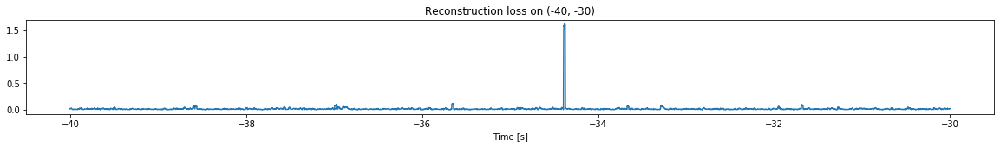

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


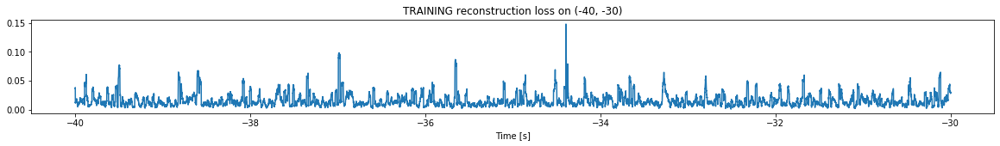

Finished training, median of the log(loss) is:  -1.8952320108624994
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8200075751862566


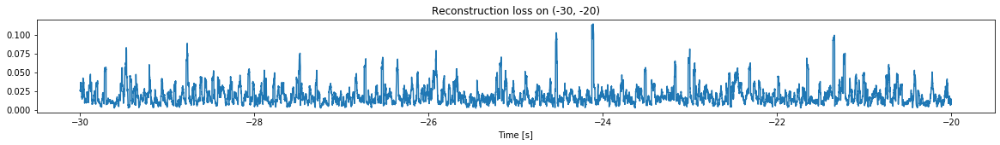

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


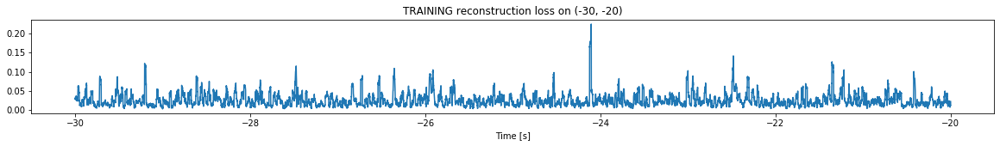

Finished training, median of the log(loss) is:  -1.6681265921006132
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8952320108624994


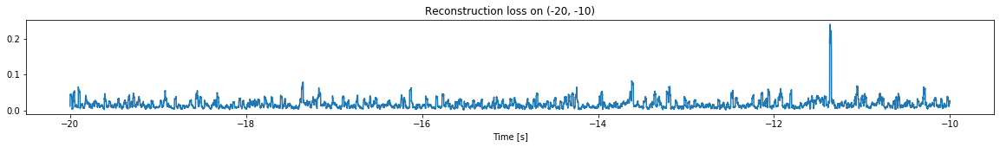

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


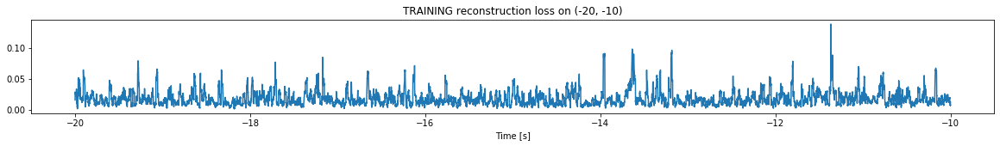

Finished training, median of the log(loss) is:  -1.8009338988640187
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6681265921006132


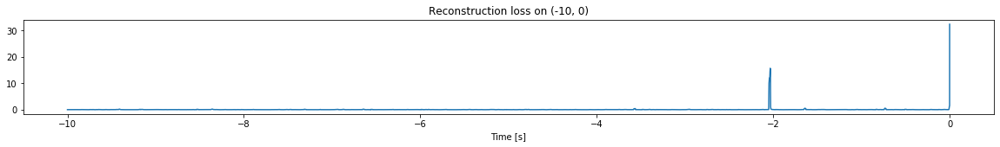

<--------
Finished simulation, all the triggered times are:  []


In [16]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


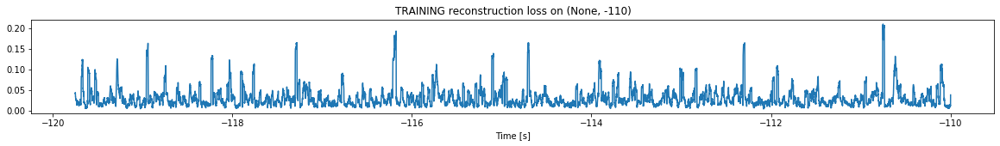

Finished training, median of the log(loss) is:  -1.592603948732808
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


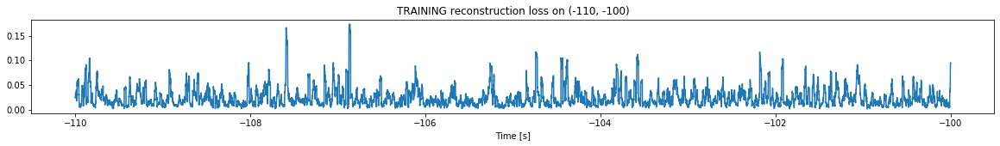

Finished training, median of the log(loss) is:  -1.7008558326976253
Triggering for section:  (-100, -90)
Using this median for triggering: -1.592603948732808


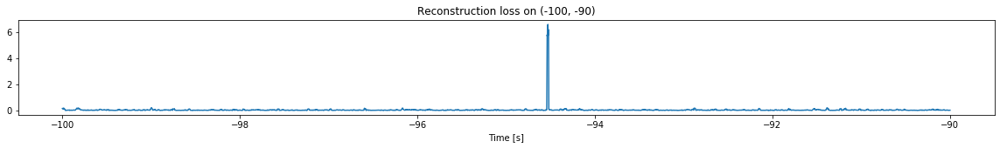

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


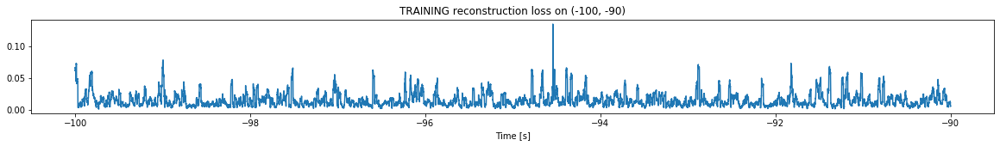

Finished training, median of the log(loss) is:  -1.9126288623959995
Triggering for section:  (-90, -80)
Using this median for triggering: -1.7008558326976253


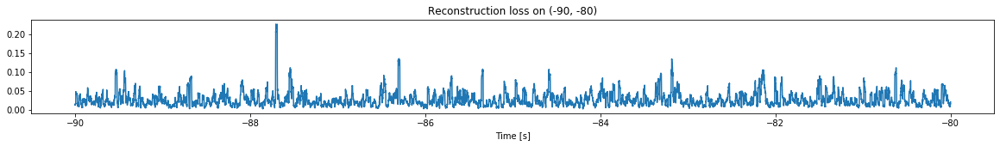

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


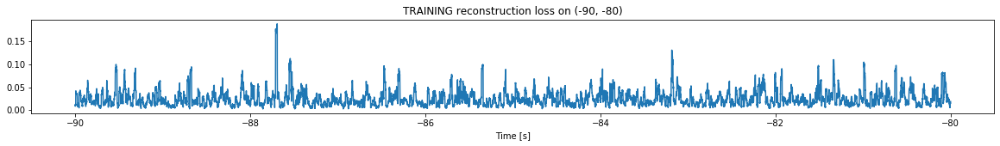

Finished training, median of the log(loss) is:  -1.671687508787742
Triggering for section:  (-80, -70)
Using this median for triggering: -1.9126288623959995


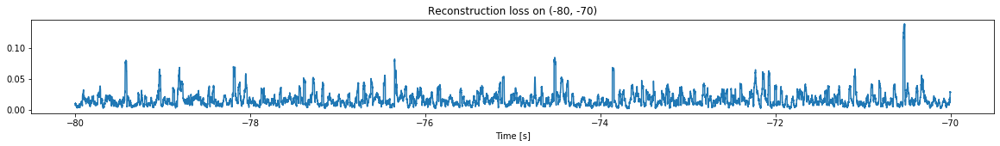

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


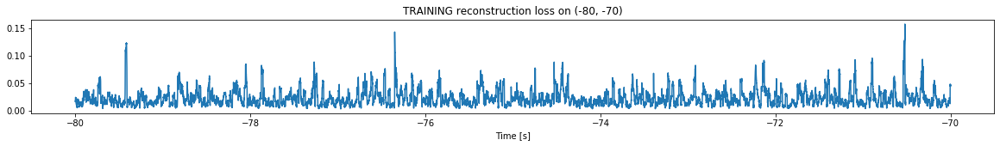

Finished training, median of the log(loss) is:  -1.7197085403426062
Triggering for section:  (-70, -60)
Using this median for triggering: -1.671687508787742


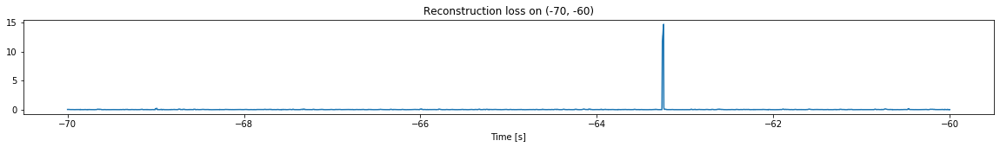

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


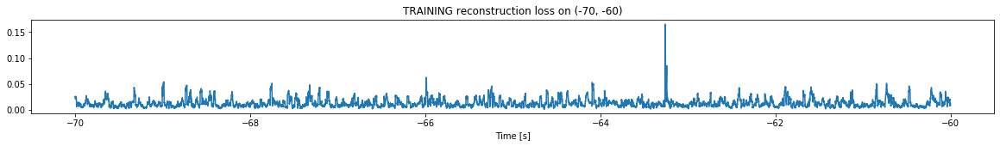

Finished training, median of the log(loss) is:  -1.9871608229984057
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7197085403426062


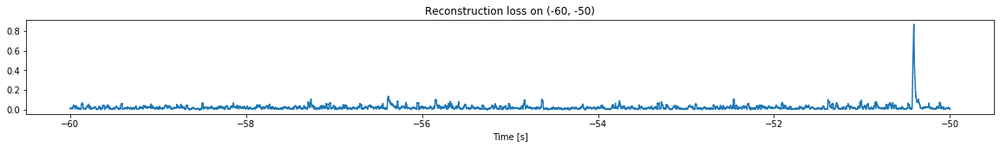

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


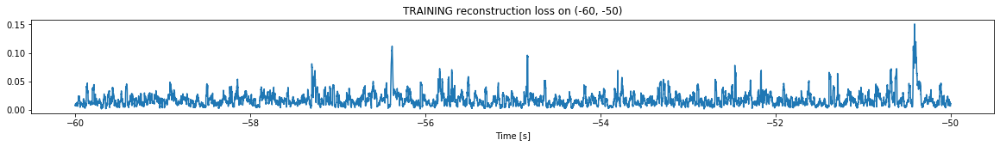

Finished training, median of the log(loss) is:  -1.802351656884181
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9871608229984057


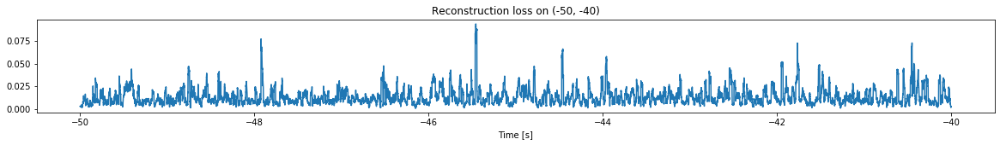

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


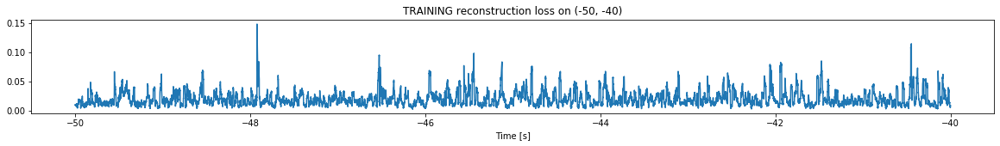

Finished training, median of the log(loss) is:  -1.7663434272571945
Triggering for section:  (-40, -30)
Using this median for triggering: -1.802351656884181


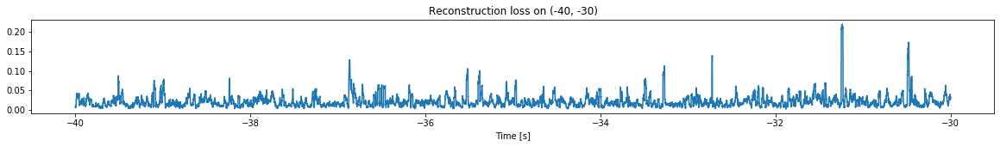

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


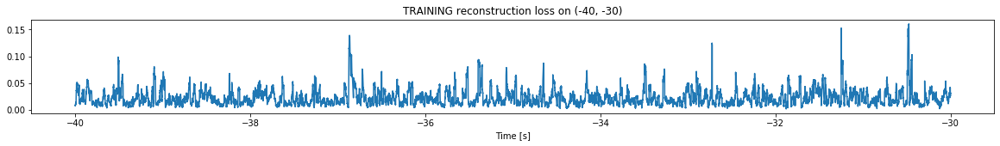

Finished training, median of the log(loss) is:  -1.7159383671152695
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7663434272571945


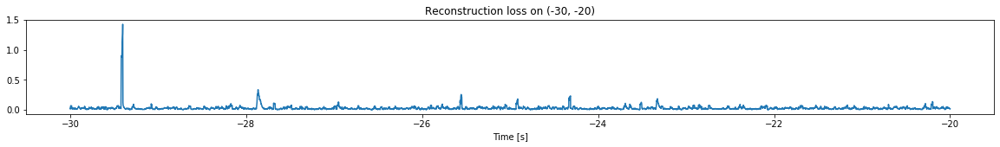

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


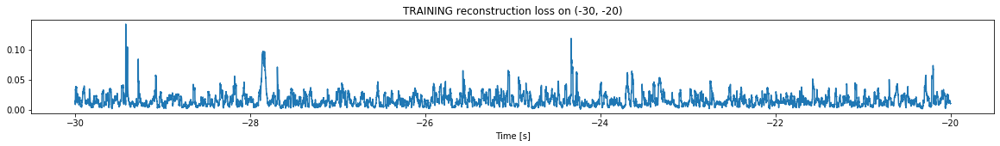

Finished training, median of the log(loss) is:  -1.8583408220348205
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7159383671152695


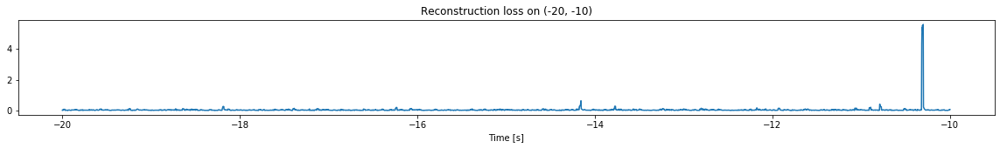

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


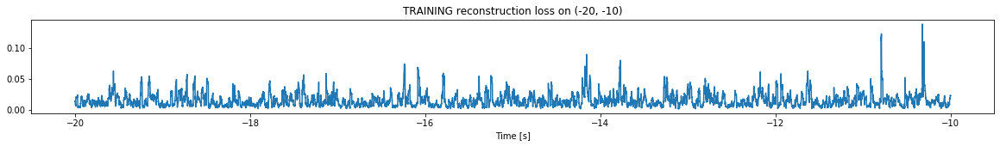

Finished training, median of the log(loss) is:  -1.8828280869995098
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8583408220348205


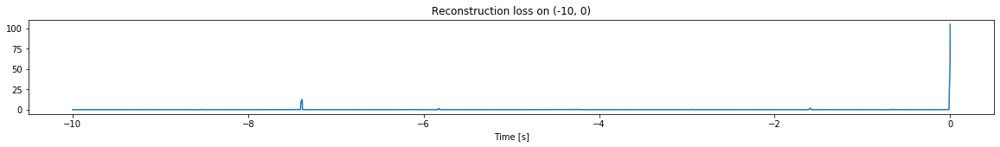

Other trigger time:  []
Their log loss values are:  []


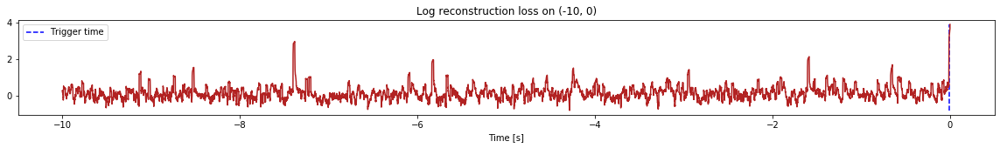

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [17]:
simulation("./data/Ramp30/", 10, (-120,0))